---
# **BIOMEDICAL TEXT CLASSIFICATION USING LSTM, GRU AND BAHDANAU ATTENTION**
---

## **About Dataset**


The dataset originates from a competition hosted on [Kaggle](https://www.kaggle.com/competitions/msk-redefining-cancer-treatment) by the **Memorial Sloan Kettering Cancer Center (MSK)**.
The goal of the challenge was to develop models capable of **classifying genetic mutations based on clinical textual evidence**.

This dataset addresses a **real-world problem in precision oncology**, where clinicians must link a patient’s genetic mutations to a **treatment class or clinical outcome**, based on medical reports, scientific literature, or other clinical descriptions.

### **Dataset description**

training_variants - a comma separated file containing the description of the genetic mutations used for training. Fields are ID (the id of the row used to link the mutation to the clinical evidence), Gene (the gene where this genetic mutation is located), Variation (the aminoacid change for this mutations), Class (1-9 the class this genetic mutation has been classified on)
training_text - a double pipe (||) delimited file that contains the clinical evidence (text) used to classify genetic mutations. Fields are ID (the id of the row used to link the clinical evidence to the genetic mutation), Text (the clinical evidence used to classify the genetic mutation). To address class imbalance, we rely on techniques such as SMOTE and class weighting.

#### **Turning your dataset into a binary classification problem where:**

- Class 7 → Positive class (1)

- All other classes → Negative class (0)

This notebook focuses on exploratory data analysis and the model validation phase. Only models that perform satisfactorily during validation will be considered for the subsequent optimization phase. To address class imbalance, we rely on techniques such as SMOTE and class weighting.

# **I. Exploratory data analysis**

In [2]:
import random
import pickle
import time
import re
import wandb
from google.colab import drive

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data.dataset import ConcatDataset
from torch.utils.data import DataLoader, TensorDataset, Dataset
from torch.nn.utils.rnn import pad_sequence
from transformers import AutoTokenizer, AutoModel
from sklearn.utils.class_weight import compute_class_weight
from torch.utils.data import Dataset, DataLoader, TensorDataset, ConcatDataset
from sklearn.manifold import TSNE
from sklearn.metrics import (
    accuracy_score,
    f1_score,
    precision_score,
    recall_score,
    balanced_accuracy_score,
    classification_report,
    confusion_matrix,
    ConfusionMatrixDisplay
)

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from imblearn.over_sampling import SMOTE, BorderlineSMOTE

from tqdm import tqdm
import torch.nn as nn
import imageio
import numpy as np
import pandas as pd
import os
from collections import defaultdict
from collections import Counter

import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
from scipy.sparse import csr_matrix
from wordcloud import WordCloud
from sklearn.metrics import f1_score, confusion_matrix, balanced_accuracy_score, precision_score, recall_score
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay

from sklearn.feature_extraction.text import TfidfVectorizer
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
import nltk

In [3]:
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [4]:
# To ensure reproducibility of the results
SEED = 200
random.seed(SEED)

np.random.seed(SEED)
torch.manual_seed(SEED)
torch.cuda.manual_seed(SEED)
torch.backends.cudnn.deterministic = True
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [5]:
data = pd.read_csv("/content/drive/MyDrive/data2.csv")
data = data.dropna()
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 3316 entries, 0 to 3320
Data columns (total 11 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   ID                  3316 non-null   int64 
 1   Gene                3316 non-null   object
 2   Variation           3316 non-null   object
 3   Class               3316 non-null   int64 
 4   Text                3316 non-null   object
 5   nb_sentences        3316 non-null   int64 
 6   nb_words            3316 non-null   int64 
 7   Mutation_Name       3316 non-null   object
 8   abstract            3316 non-null   object
 9   Top_Relevant_Words  3316 non-null   object
 10  label               3316 non-null   int64 
dtypes: int64(5), object(6)
memory usage: 310.9+ KB


In [ ]:
print(data['Class'].value_counts())

Class
7    952
4    686
1    566
2    452
6    273
5    242
3     89
9     37
8     19
Name: count, dtype: int64


In [6]:
def count_sentences(text):
    sentences = re.split(r'[.!?]+', str(text))
    sentences = [s.strip() for s in sentences if s.strip()]
    return len(sentences)

data['nb_sentences'] = data['Text'].apply(count_sentences)

In [ ]:
data.head()

,ID,Gene,Variation,Class,Text,nb_sentences,nb_words,Mutation_Name,abstract,Top_Relevant_Words,label
0,0,FAM58A,Truncating Mutations,1,Cyclin-dependent kinases (CDKs) regulate a var...,398,6089,Mutation1,cyclin-dependent kinase (cdks) regulate variet...,"['cyclin', 'fig', 'silencing', 'mcf7', 'cell',...",0
1,1,CBL,W802*,2,Abstract Background Non-small cell lung canc...,316,5756,Mutation2,abstract background non-small cell lung cancer...,"['cbl', 'mutation', 'egfr', 'lung', 'loh', 'me...",1
2,2,CBL,Q249E,2,Abstract Background Non-small cell lung canc...,316,5756,Mutation2,abstract background non-small cell lung cancer...,"['cbl', 'mutation', 'egfr', 'lung', 'loh', 'me...",1
3,3,CBL,N454D,3,Recent evidence has demonstrated that acquired...,224,5572,Mutation3,recent evidence demonstrated acquired uniparen...,"['cbl', 'mutation', 'flt3', 'case', '32d', 'v6...",2
4,4,CBL,L399V,4,Oncogenic mutations in the monomeric Casitas B...,312,6202,Mutation4,oncogenic mutation monomeric casitas b-lineage...,"['cbl', 'e2', 'mutation', 'stability', 'cancer...",3


In [ ]:
data.tail()

,ID,Gene,Variation,Class,Text,nb_sentences,nb_words,Mutation_Name,abstract,Top_Relevant_Words,label
3316,3316,RUNX1,D171N,4,Introduction Myelodysplastic syndromes (MDS) ...,541,11028,Mutation4,introduction myelodysplastic syndrome (mds) he...,"['aml1', 'd171n', 'evi1', 'mds', 'aml', 'mice'...",3
3317,3317,RUNX1,A122*,1,Introduction Myelodysplastic syndromes (MDS) ...,295,6068,Mutation1,introduction myelodysplastic syndrome (mds) he...,"['d171n', 'aml1', 'evi1', 'mds', 'mice', 'aml'...",0
3318,3318,RUNX1,Fusions,1,The Runt-related transcription factor 1 gene (...,238,5122,Mutation1,runt-related transcription factor 1 gene (runx...,"['runx1', 'q22', 'aml', '21', 'm2', 'transloca...",0
3319,3319,RUNX1,R80C,4,The RUNX1/AML1 gene is the most frequent targe...,306,4885,Mutation4,runx1/aml1 gene frequent target chromosomal tr...,"['runx1', 'aml', 'mutation', 'leukemia', 'mds'...",3
3320,3320,RUNX1,K83E,4,The most frequent mutations associated with le...,577,9825,Mutation4,frequent mutation associated leukemia recurren...,"['runx1', 'aml', 'mutation', 'leukemia', 'mds'...",3


In [ ]:
print(data['Class'].value_counts())

Class
7    952
4    686
1    566
2    452
6    273
5    242
3     89
9     37
8     19
Name: count, dtype: int64


In [7]:
data['nb_words'] = data['Text'].astype(str).str.split().apply(len)
print(data[['Text', 'nb_words']].head())

                                                Text  nb_words
0  Cyclin-dependent kinases (CDKs) regulate a var...      6089
1   Abstract Background  Non-small cell lung canc...      5756
2   Abstract Background  Non-small cell lung canc...      5756
3  Recent evidence has demonstrated that acquired...      5572
4  Oncogenic mutations in the monomeric Casitas B...      6202


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 3316 entries, 0 to 3320
Data columns (total 11 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   ID                  3316 non-null   int64 
 1   Gene                3316 non-null   object
 2   Variation           3316 non-null   object
 3   Class               3316 non-null   int64 
 4   Text                3316 non-null   object
 5   nb_sentences        3316 non-null   int64 
 6   nb_words            3316 non-null   int64 
 7   Mutation_Name       3316 non-null   object
 8   abstract            3316 non-null   object
 9   Top_Relevant_Words  3316 non-null   object
 10  label               3316 non-null   int64 
dtypes: int64(5), object(6)
memory usage: 310.9+ KB


In [8]:
min_sentence_count = data['nb_sentences'].min()
max_sentence_count = data['nb_sentences'].max()

print(f"Min number of sentences: {min_sentence_count}")
print(f"Max number of sentences: {max_sentence_count}")

mean_sentence_count = data['nb_sentences'].mean()
print(f"Average number of sentences: {mean_sentence_count:.2f}")

Min number of sentences: 3
Max number of sentences: 4870
Average number of sentences: 567.56


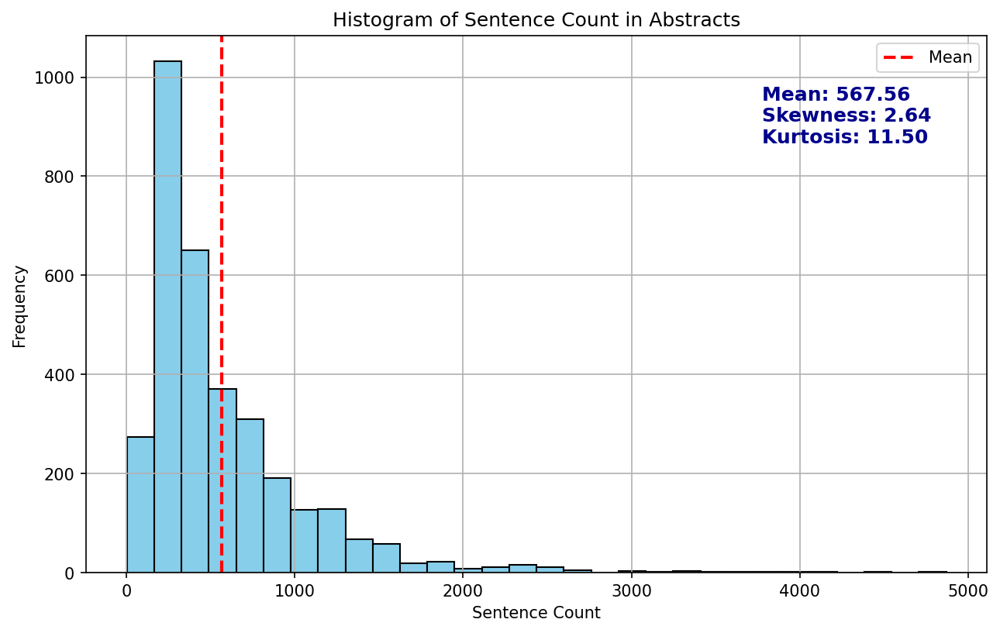

In [9]:
from scipy.stats import kurtosis, skew

plt.figure(figsize=(10, 6), dpi=150)

# Plot histogram for sentence counts
plt.hist(data['nb_sentences'], bins=30, color='skyblue', edgecolor='black')

plt.title('Histogram of Sentence Count in Abstracts')
plt.xlabel('Sentence Count')
plt.ylabel('Frequency')
plt.grid(True)

# Calculate statistics for sentence counts
mean_sentence_count = data['nb_sentences'].mean()
kurt = kurtosis(data['nb_sentences'], fisher=True)  # excess kurtosis
skw = skew(data['nb_sentences'])

# Draw vertical line for mean
plt.axvline(mean_sentence_count, color='red', linestyle='dashed', linewidth=2, label='Mean')

# Add combined stats text on top right
plt.text(
    plt.xlim()[1] - (plt.xlim()[1] - plt.xlim()[0]) * 0.25,  # 25% from right
    plt.ylim()[1] * 0.8,  # 80% from bottom (near top)
    s=f'Mean: {mean_sentence_count:.2f}\nSkewness: {skw:.2f}\nKurtosis: {kurt:.2f}',
    fontsize=12, color='darkblue', weight='bold',
    ha='left'
)

plt.legend()
plt.show()

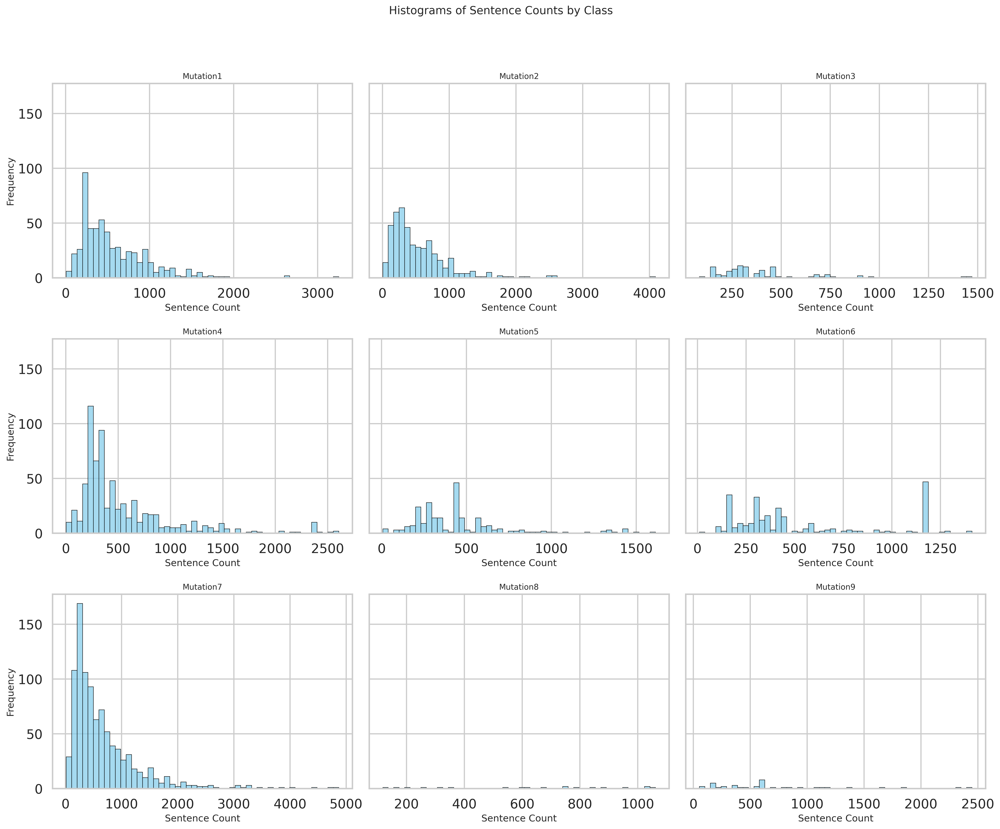

In [10]:
# Create a dictionary mapping class numbers to names like "Mutation1", "Mutation2", ...
class_labels = {c: f"Mutation{c}" for c in sorted(data['Class'].unique())}

sns.set_style("whitegrid")
sns.set_context("talk")

fig, axes = plt.subplots(3, 3, figsize=(18, 15), sharey=True, dpi=300)
axes = axes.flatten()

for i, ax in enumerate(axes):
    label = i + 1
    subset = data[data['Class'] == label]

    sns.histplot(subset['nb_sentences'], bins=50, color='skyblue', edgecolor='black', ax=ax)
    ax.set_title(class_labels[label], fontsize=10)
    ax.set_xlabel('Sentence Count', fontsize=12)

    if i % 3 == 0:
        ax.set_ylabel('Frequency', fontsize=12)
    else:
        ax.set_ylabel('')

plt.suptitle("Histograms of Sentence Counts by Class", fontsize=14)
plt.tight_layout(rect=[0, 0, 1, 0.95])

plt.savefig('sentence_count_histograms_by_class.png', dpi=300)
plt.show()

Total sentence count per class:
  Mutation_Name  nb_sentences
7     Mutation8         11955
8     Mutation9         26050
2     Mutation3         34925
4     Mutation5        109264
5     Mutation6        144978
1     Mutation2        241087
0     Mutation1        317519
3     Mutation4        365724
6     Mutation7        630519


/tmp/ipython-input-1744188627.py:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Mutation_Name', y='nb_sentences', data=sentence_count_per_class, palette=palette, edgecolor='black')


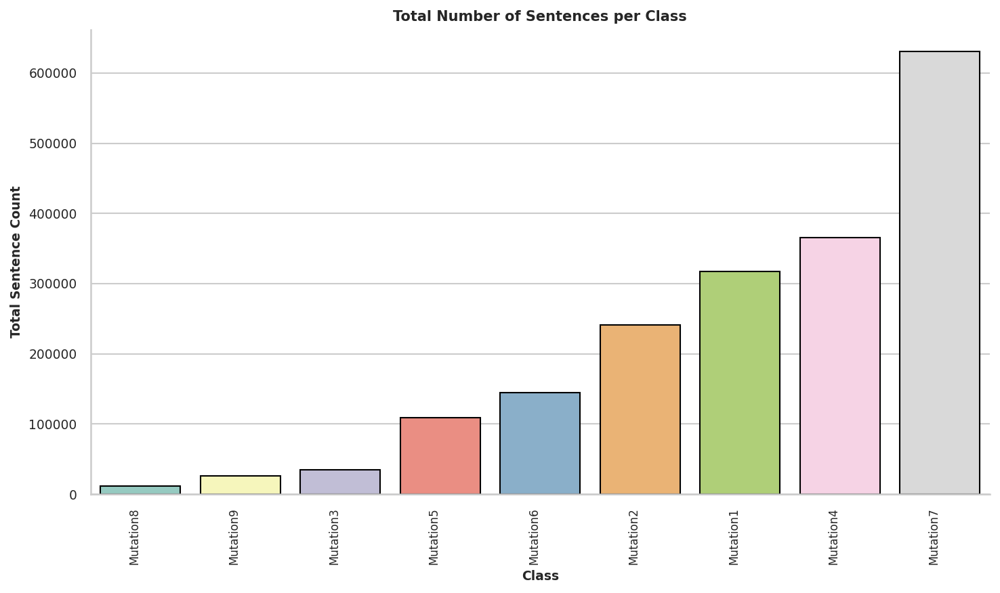

In [12]:
sentence_count_per_class = data.groupby('Mutation_Name')['nb_sentences'].sum().reset_index()

# Sort by ascending total sentence count
sentence_count_per_class = sentence_count_per_class.sort_values('nb_sentences', ascending=True)

# Print total number of sentences per class
print("Total sentence count per class:")
print(sentence_count_per_class)

# Style global
sns.set_theme(style="whitegrid")

# Figure
plt.figure(figsize=(10, 6), dpi=150)

# Palette dynamique
palette = sns.color_palette("Set3", n_colors=sentence_count_per_class['Mutation_Name'].nunique())

# Vertical bar plot
sns.barplot(x='Mutation_Name', y='nb_sentences', data=sentence_count_per_class, palette=palette, edgecolor='black')

# Titres et axes
plt.title('Total Number of Sentences per Class', fontsize=10, fontweight='bold')
plt.xlabel('Class', fontsize=9, fontweight='bold')
plt.ylabel('Total Sentence Count', fontsize=9, fontweight='bold')

# Rotation et taille des ticks
plt.xticks(rotation=90, ha='right', fontsize=8)
plt.yticks(fontsize=9)

# Supprimer les bordures inutiles
sns.despine()

# Mise en page
plt.tight_layout()
plt.savefig('sentence_count_per_class_vertical.png', dpi=150)
plt.show()

/tmp/ipython-input-1438468095.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='Mutation_Name', y='nb_sentences', data=data, palette=palette)


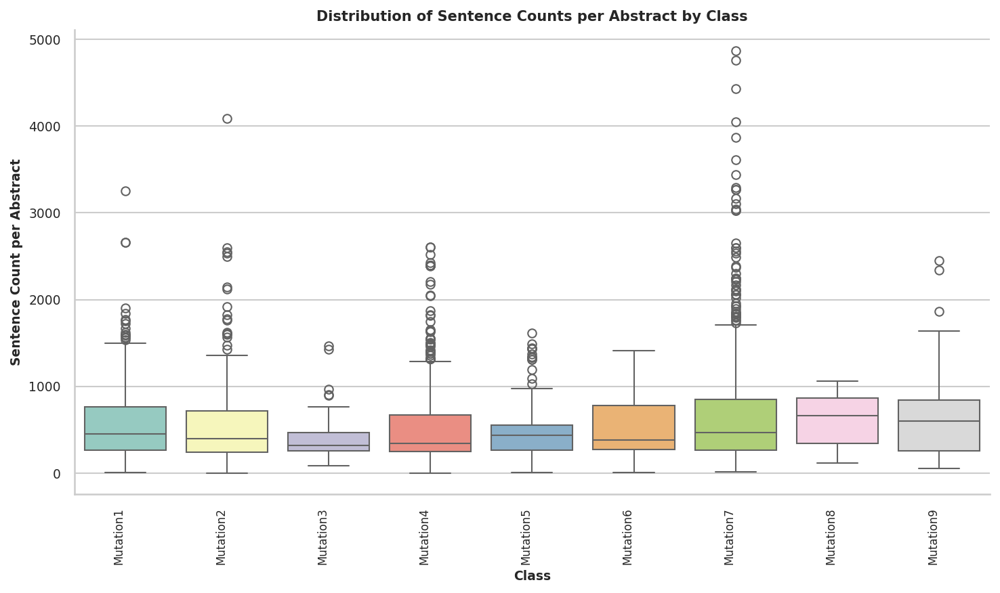

In [13]:
sns.set_theme(style="whitegrid")  # style global
plt.figure(figsize=(10, 6), dpi=150)

palette = sns.color_palette("Set3", n_colors=data['Mutation_Name'].nunique())
sns.boxplot(x='Mutation_Name', y='nb_sentences', data=data, palette=palette)

plt.xticks(rotation=90, ha='right', fontsize=8)
plt.yticks(fontsize=9)

plt.title('Distribution of Sentence Counts per Abstract by Class', fontsize=10, fontweight='bold')
plt.xlabel('Class', fontsize=9, fontweight='bold')
plt.ylabel('Sentence Count per Abstract', fontsize=9, fontweight='bold')

sns.despine()
plt.tight_layout()
plt.show()

In [14]:
data['Mutation_Name'] = data['Class'].apply(lambda x: f"Mutation{x}")
data.head()

,ID,Gene,Variation,Class,Text,nb_sentences,nb_words,Mutation_Name,abstract,Top_Relevant_Words,label
0,0,FAM58A,Truncating Mutations,1,Cyclin-dependent kinases (CDKs) regulate a var...,398,6089,Mutation1,cyclin-dependent kinase (cdks) regulate variet...,"['cyclin', 'fig', 'silencing', 'mcf7', 'cell',...",0
1,1,CBL,W802*,2,Abstract Background Non-small cell lung canc...,316,5756,Mutation2,abstract background non-small cell lung cancer...,"['cbl', 'mutation', 'egfr', 'lung', 'loh', 'me...",1
2,2,CBL,Q249E,2,Abstract Background Non-small cell lung canc...,316,5756,Mutation2,abstract background non-small cell lung cancer...,"['cbl', 'mutation', 'egfr', 'lung', 'loh', 'me...",1
3,3,CBL,N454D,3,Recent evidence has demonstrated that acquired...,224,5572,Mutation3,recent evidence demonstrated acquired uniparen...,"['cbl', 'mutation', 'flt3', 'case', '32d', 'v6...",2
4,4,CBL,L399V,4,Oncogenic mutations in the monomeric Casitas B...,312,6202,Mutation4,oncogenic mutation monomeric casitas b-lineage...,"['cbl', 'e2', 'mutation', 'stability', 'cancer...",3


In [15]:
min_word_count = data['nb_words'].min()
max_word_count = data['nb_words'].max()

print(f"Min number of words: {min_word_count}")
print(f"Max number of words: {max_word_count}")

mean_word_count = data['nb_words'].mean()
print(f"Average word number : {mean_word_count }")

Min number of words: 53
Max number of words: 76782
Average word number : 9565.512062726177


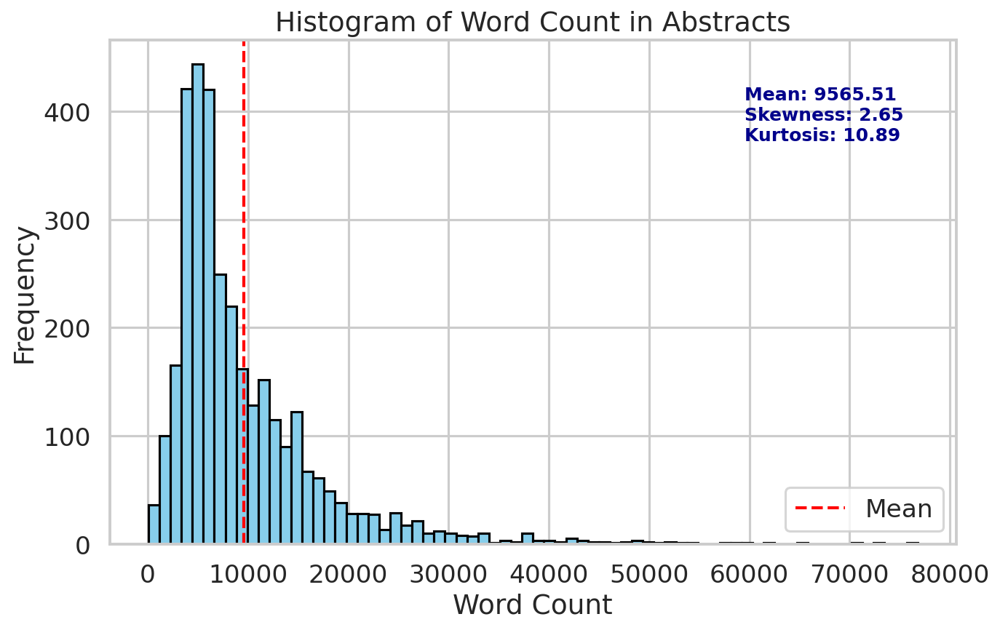

In [ ]:
plt.figure(figsize=(10, 6), dpi=150)

# Plot histogram
plt.hist(data['nb_words'], bins=70, color='skyblue', edgecolor='black')

plt.title('Histogram of Word Count in Abstracts')
plt.xlabel('Word Count')
plt.ylabel('Frequency')
plt.grid(True)

# Calculate statistics
mean_word_count = data['nb_words'].mean()
kurt = kurtosis(data['nb_words'], fisher=True)  # excess kurtosis
skw = skew(data['nb_words'])

# Draw vertical line for mean
plt.axvline(mean_word_count, color='red', linestyle='dashed', linewidth=2, label='Mean')

# Add combined stats text on top right
plt.text(plt.xlim()[1] - (plt.xlim()[1]-plt.xlim()[0]) * 0.25,  # 35% from right
         plt.ylim()[1] * 0.8,  # 90% from bottom (near top)
         s=f'Mean: {mean_word_count:.2f}\nSkewness: {skw:.2f}\nKurtosis: {kurt:.2f}',
         fontsize=12, color='darkblue', weight='bold',
         ha='left')

plt.legend()
plt.show()

Total word count per class:
  Mutation_Name  nb_words
7     Mutation8    205474
8     Mutation9    473876
2     Mutation3    601407
4     Mutation5   1819126
5     Mutation6   1975631
1     Mutation2   4208298
0     Mutation1   5367768
3     Mutation4   6162606
6     Mutation7  10905052


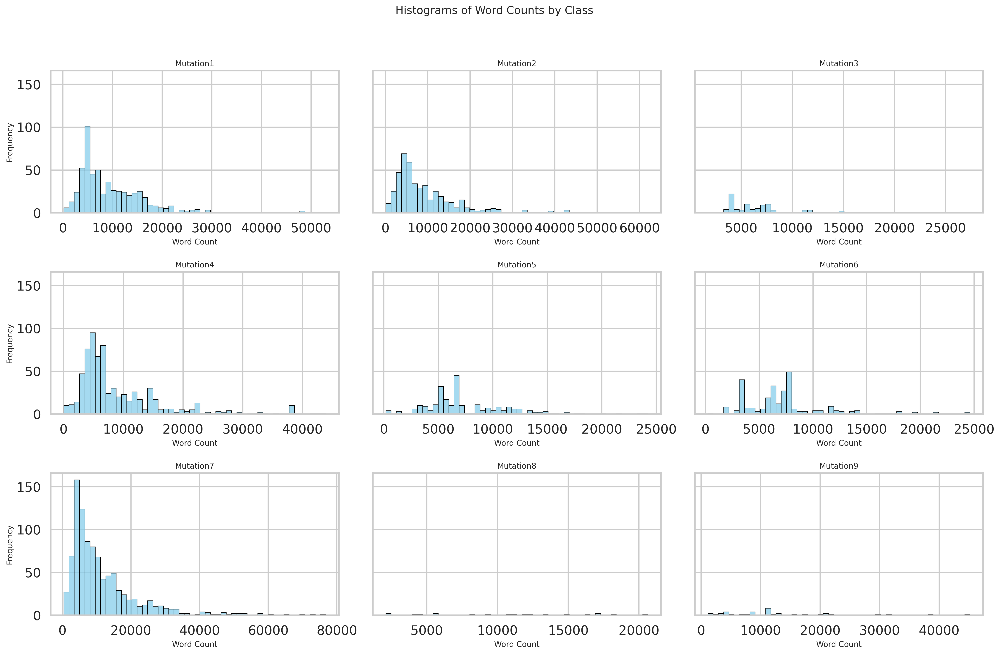

In [ ]:
# Create mapping from class ID to name
class_names = dict(
    data[['Class', 'Mutation_Name']]
    .drop_duplicates()
    .sort_values('Class')
    .values
)

# ---- NEW: Calculate and print total words per class ----
word_count_per_class = (
    data.groupby('Mutation_Name')['nb_words']
    .sum()
    .reset_index()
    .sort_values('nb_words', ascending=True)
)

print("Total word count per class:")
print(word_count_per_class)
# --------------------------------------------------------

sns.set_style("whitegrid")
sns.set_context("talk")

fig, axes = plt.subplots(3, 3, figsize=(18, 12), sharey=True, dpi=300)
axes = axes.flatten()

for i, ax in enumerate(axes):
    label = i + 1
    if label > 9:
        ax.axis('off')
        continue

    subset = data[data['Class'] == label]
    sns.histplot(subset['nb_words'], bins=50, color='skyblue', edgecolor='black', ax=ax)
    ax.set_title(f"{class_names[label]}", fontsize=10)
    ax.set_xlabel('Word Count', fontsize=10)
    if i % 3 == 0:
        ax.set_ylabel('Frequency', fontsize=10)

plt.suptitle("Histograms of Word Counts by Class", fontsize=14)
plt.tight_layout(rect=[0, 0, 1, 0.96])

plt.savefig('word_count_histograms_by_class.png', dpi=300)
plt.show()

Total word count per class:
  Mutation_Name  nb_words
7     Mutation8    205474
8     Mutation9    473876
2     Mutation3    601407
4     Mutation5   1819126
5     Mutation6   1975631
1     Mutation2   4208298
0     Mutation1   5367768
3     Mutation4   6162606
6     Mutation7  10905052


/tmp/ipython-input-873461738.py:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Mutation_Name', y='nb_words', data=word_count_per_class, palette=palette, edgecolor='black')


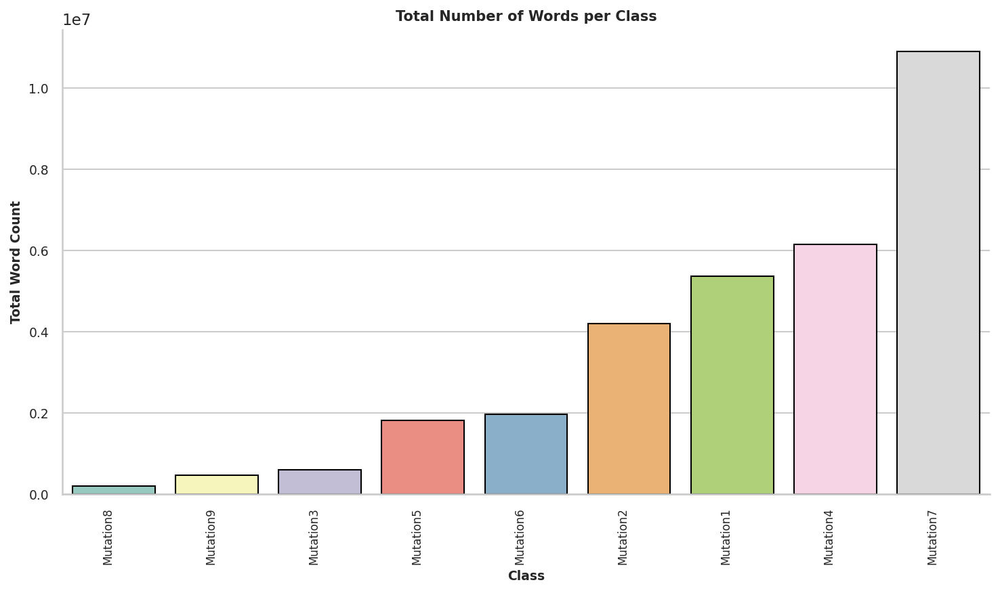

In [16]:
word_count_per_class = data.groupby('Mutation_Name')['nb_words'].sum().reset_index()

# Sort by ascending total word count
word_count_per_class = word_count_per_class.sort_values('nb_words', ascending=True)

# Print total word count per class
print("Total word count per class:")
print(word_count_per_class)

# Style global
sns.set_theme(style="whitegrid")

# Figure
plt.figure(figsize=(10, 6), dpi=150)

# Palette dynamique
palette = sns.color_palette("Set3", n_colors=word_count_per_class['Mutation_Name'].nunique())

# Bar plot vertical
sns.barplot(x='Mutation_Name', y='nb_words', data=word_count_per_class, palette=palette, edgecolor='black')

# Titres et axes
plt.title('Total Number of Words per Class', fontsize=10, fontweight='bold')
plt.xlabel('Class', fontsize=9, fontweight='bold')
plt.ylabel('Total Word Count', fontsize=9, fontweight='bold')

# Rotation et taille des ticks
plt.xticks(rotation=90, ha='right', fontsize=8)
plt.yticks(fontsize=9)

# Supprimer les bordures inutiles
sns.despine()

# Mise en page
plt.tight_layout()
plt.savefig('word_count_per_class_vertical.png', dpi=150)
plt.show()

/tmp/ipython-input-195522781.py:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='Mutation_Name', y='nb_words', data=data, palette=palette)


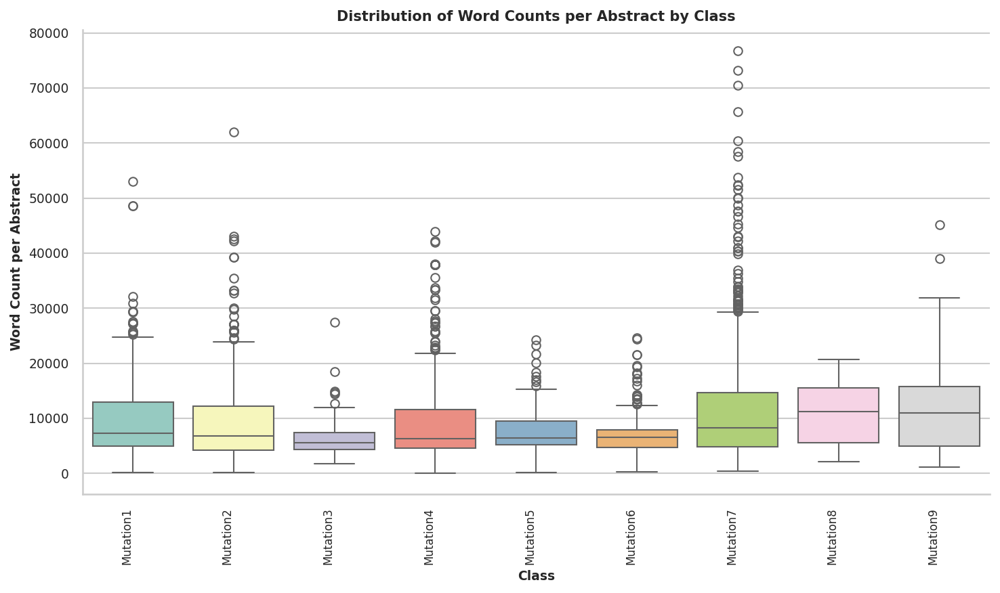

In [17]:
sns.set_theme(style="whitegrid")

# Taille de figure et résolution
plt.figure(figsize=(10, 6), dpi=150)

# Palette dynamique en fonction du nombre de classes
palette = sns.color_palette("Set3", n_colors=data['Mutation_Name'].nunique())

# Boxplot
sns.boxplot(x='Mutation_Name', y='nb_words', data=data, palette=palette)

# Ajustement des ticks et labels
plt.xticks(rotation=90, ha='right', fontsize=8)
plt.yticks(fontsize=9)

# Titres et axes en gras
plt.title('Distribution of Word Counts per Abstract by Class', fontsize=10, fontweight='bold')
plt.xlabel('Class', fontsize=9, fontweight='bold')
plt.ylabel('Word Count per Abstract', fontsize=9, fontweight='bold')

# Supprimer les bordures inutiles
sns.despine()

# Mise en page
plt.tight_layout()
plt.show()

In [ ]:
# Download NLTK resources
nltk.download('stopwords')
nltk.download('wordnet')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...


True

In [ ]:
def preprocess_text(text):
    """
    Preprocesses the input text by lowercasing, tokenizing, removing stop words, and lemmatizing.

    Args:
        text: A string containing the text to be preprocessed.

    Returns:
        A string containing the processed text with stopwords removed and words lemmatized.
    """
    if pd.isna(text):
        return ""
    text = text.lower()
    words = text.split()
    stop_words = set(stopwords.words('english'))
    lemmatizer = WordNetLemmatizer()
    words = [lemmatizer.lemmatize(word) for word in words if word not in stop_words]
    return " ".join(words)

def generate_wordcloud(word_counts, class_label, ax):
    """
    Generates and displays a word cloud for the given word frequencies associated with a specific class label.

    Args:
        word_counts (dict): A dictionary where keys are words and values are their corresponding frequencies.
        class_label (int or str): The class label for which the word cloud is being generated.
        ax (matplotlib.axes.Axes): The axes on which the word cloud will be displayed.

    Returns:
        None
    """
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(word_counts)
    ax.imshow(wordcloud, interpolation='bilinear')
    ax.axis('off')
    ax.set_title(f'Class {class_label}')

In [ ]:
tqdm.pandas(desc="Preprocessing Text")
data['abstract'] = data['Text'].astype(str).progress_apply(preprocess_text)

vectorizer = TfidfVectorizer(max_features=5000)
X_sparse = vectorizer.fit_transform(data['abstract'])

tfidf_df = pd.DataFrame.sparse.from_spmatrix(X_sparse, columns=vectorizer.get_feature_names_out())
top_words_per_abstract = np.argsort(-X_sparse.toarray(), axis=1)[:, :50]  # Get indices of top 50 words

feature_names = np.array(vectorizer.get_feature_names_out())
top_words_per_abstract = [[feature_names[idx] for idx in row] for row in top_words_per_abstract]

data['Top_Relevant_Words'] = top_words_per_abstract
data.to_csv("dataset2.csv", index=False)  # Save to disk

print(data[['Top_Relevant_Words']].head())

Preprocessing Text: 100%|██████████| 3316/3316 [02:21<00:00, 23.38it/s]


                                  Top_Relevant_Words
0  [cyclin, fig, silencing, mcf7, cell, protein, ...
1  [cbl, mutation, egfr, lung, loh, met, cell, af...
2  [cbl, mutation, egfr, lung, loh, met, cell, af...
3  [cbl, mutation, flt3, case, 32d, v617f, jak2, ...
4  [cbl, e2, mutation, stability, cancer, binding...


In [ ]:
relevant_words_by_class = {}
data['label'] = data['Class'] - 1

for label in data['label'].unique():

    class_data = data[data['label'] == label]

    class_top_words = class_data['Top_Relevant_Words'].explode().value_counts()
    relevant_words_by_class[label] = class_top_words

for label, words in relevant_words_by_class.items():
    print(f"Top relevant words for class {label}:")
    print(words.head(10))
    print("\n")

Top relevant words for class 0:
Top_Relevant_Words
mutation    456
protein     383
cell        375
fig         317
cancer      279
type        260
gene        255
figure      245
mutant      241
domain      232
Name: count, dtype: int64


Top relevant words for class 1:
Top_Relevant_Words
mutation    361
cell        338
patient     263
tumor       248
fig         214
kinase      208
cancer      200
gene        176
figure      175
mutant      166
Name: count, dtype: int64


Top relevant words for class 2:
Top_Relevant_Words
mutation    83
cell        79
figure      47
mutant      45
cancer      36
variant     35
domain      34
al          34
et          34
kinase      34
Name: count, dtype: int64


Top relevant words for class 3:
Top_Relevant_Words
mutation    590
cell        534
protein     501
fig         380
mutant      365
activity    347
figure      296
type        264
tumor       259
cancer      257
Name: count, dtype: int64


Top relevant words for class 4:
Top_Relevant_Words
mut

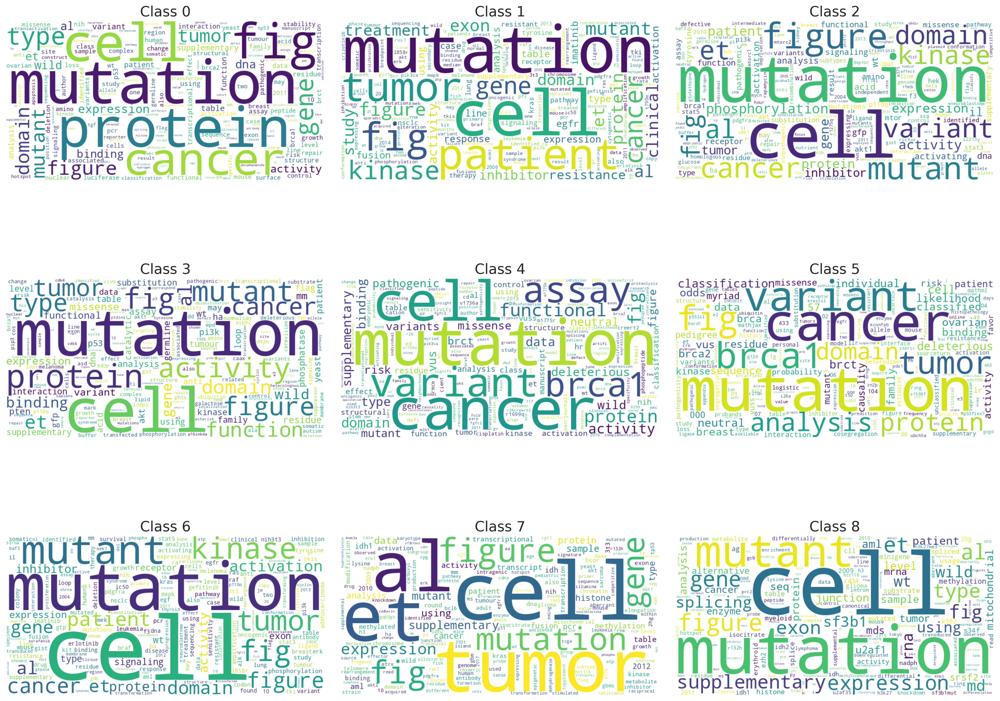

In [ ]:
selected_labels = list(relevant_words_by_class.keys())[:9]

fig, axes = plt.subplots(3, 3, figsize=(18, 15), dpi=300)
axes = axes.flatten()

for ax, label in zip(axes, selected_labels):
    generate_wordcloud(relevant_words_by_class[label], label, ax)

for ax in axes[len(selected_labels):]:
    ax.axis('off')

plt.tight_layout()
plt.show()

#### **Turn your dataset into a binary classification problem where:**

- Class 7 → Positive class (1)

- All other classes → Negative class (0)

In [ ]:
data['Binary_Class'] = (data['Class'] == 7).astype(int)
print(data['Binary_Class'].value_counts())

Binary_Class
0    2364
1     952
Name: count, dtype: int64


/tmp/ipython-input-2038465542.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=class_counts.index, y=class_counts.values, palette="viridis")


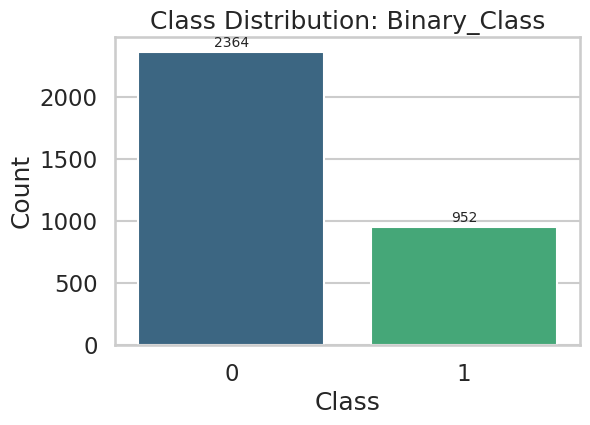

In [ ]:
class_counts = data['Binary_Class'].value_counts()

# Bar plot
plt.figure(figsize=(6, 4))
sns.barplot(x=class_counts.index, y=class_counts.values, palette="viridis")

plt.xlabel("Class")
plt.ylabel("Count")
plt.title("Class Distribution: Binary_Class")

for i, count in enumerate(class_counts.values):
    plt.text(i, count + 20, str(count), ha='center', va='bottom', fontsize=10)

plt.show()

Total sentence count per Binary_Class:
   Binary_Class  nb_sentences
1             1        630519
0             0       1251502


/tmp/ipython-input-1776318324.py:14: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='Binary_Class', y='nb_sentences', data=data, palette='pastel')


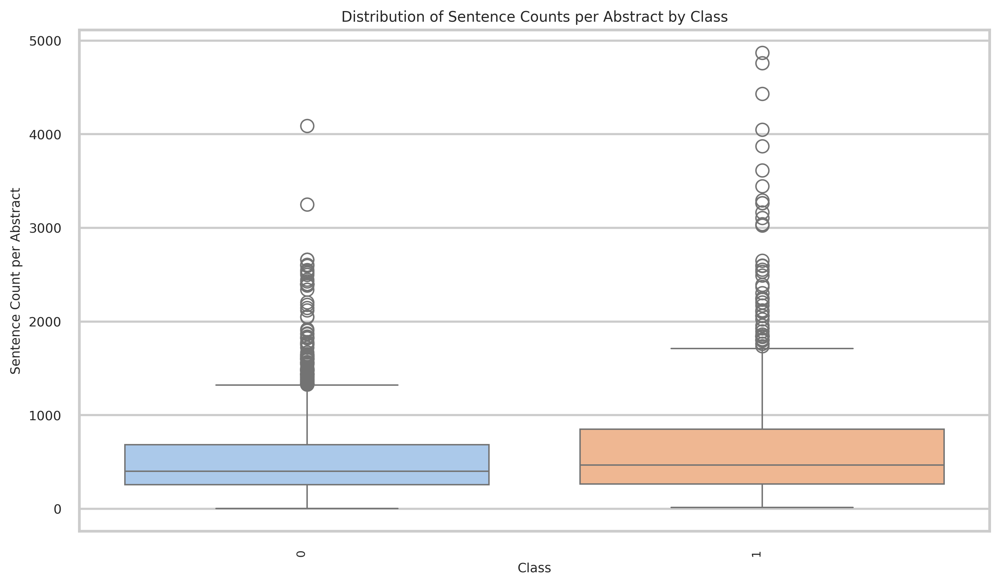

In [ ]:
# Calculate and print total sentences per Binary_Class
sentence_count_per_binary_class = (
    data.groupby('Binary_Class')['nb_sentences']
    .sum()
    .reset_index()
    .sort_values('nb_sentences', ascending=True)
)

print("Total sentence count per Binary_Class:")
print(sentence_count_per_binary_class)

# Plot boxplot
plt.figure(figsize=(10, 6), dpi=300)
sns.boxplot(x='Binary_Class', y='nb_sentences', data=data, palette='pastel')

plt.xticks(rotation=90, ha='right', fontsize=8)  # Smaller x-axis labels
plt.yticks(fontsize=9)                           # Smaller y-axis labels
plt.title('Distribution of Sentence Counts per Abstract by Class', fontsize=10)
plt.xlabel('Class', fontsize=9)
plt.ylabel('Sentence Count per Abstract', fontsize=9)

plt.tight_layout()
plt.show()

Total word count per Binary_Class:
   Binary_Class  nb_words
1             1  10905052
0             0  20814186


/tmp/ipython-input-3812537719.py:14: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='Binary_Class', y='nb_words', data=data, palette='pastel')


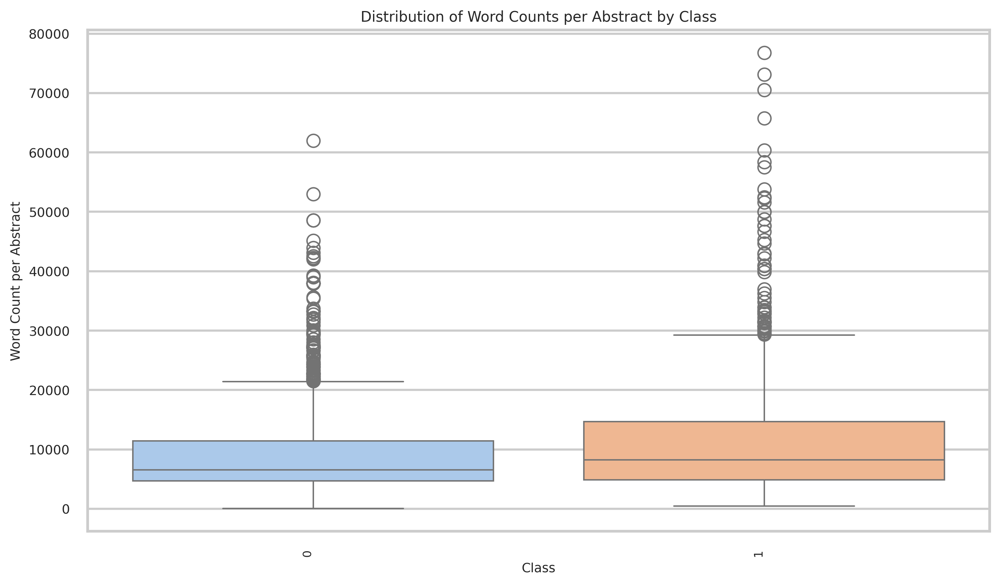

In [ ]:
# Calculate and print total words per Binary_Class
word_count_per_binary_class = (
    data.groupby('Binary_Class')['nb_words']
    .sum()
    .reset_index()
    .sort_values('nb_words', ascending=True)
)

print("Total word count per Binary_Class:")
print(word_count_per_binary_class)

# Plot boxplot
plt.figure(figsize=(10, 6), dpi=300)
sns.boxplot(x='Binary_Class', y='nb_words', data=data, palette='pastel')

plt.xticks(rotation=90, ha='right', fontsize=8)  # Smaller x-axis labels
plt.yticks(fontsize=9)                           # Smaller y-axis labels
plt.title('Distribution of Word Counts per Abstract by Class', fontsize=10)
plt.xlabel('Class', fontsize=9)
plt.ylabel('Word Count per Abstract', fontsize=9)

plt.tight_layout()
plt.show()

# **II. Mahcine Learning Models : Linear SVM and RF**

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.pipeline import Pipeline
from sklearn.svm import SVC
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics import classification_report, balanced_accuracy_score
from xgboost import XGBClassifier

In [ ]:
data = pd.read_csv('/content/drive/MyDrive/data2.csv')
data = data.dropna()
data.head()

,ID,Gene,Variation,Class,Text,nb_sentences,nb_words,Mutation_Name,abstract,Top_Relevant_Words,label
0,0,FAM58A,Truncating Mutations,1,Cyclin-dependent kinases (CDKs) regulate a var...,398,6089,Mutation1,cyclin-dependent kinase (cdks) regulate variet...,"['cyclin', 'fig', 'silencing', 'mcf7', 'cell',...",0
1,1,CBL,W802*,2,Abstract Background Non-small cell lung canc...,316,5756,Mutation2,abstract background non-small cell lung cancer...,"['cbl', 'mutation', 'egfr', 'lung', 'loh', 'me...",1
2,2,CBL,Q249E,2,Abstract Background Non-small cell lung canc...,316,5756,Mutation2,abstract background non-small cell lung cancer...,"['cbl', 'mutation', 'egfr', 'lung', 'loh', 'me...",1
3,3,CBL,N454D,3,Recent evidence has demonstrated that acquired...,224,5572,Mutation3,recent evidence demonstrated acquired uniparen...,"['cbl', 'mutation', 'flt3', 'case', '32d', 'v6...",2
4,4,CBL,L399V,4,Oncogenic mutations in the monomeric Casitas B...,312,6202,Mutation4,oncogenic mutation monomeric casitas b-lineage...,"['cbl', 'e2', 'mutation', 'stability', 'cancer...",3


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 3316 entries, 0 to 3320
Data columns (total 11 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   ID                  3316 non-null   int64 
 1   Gene                3316 non-null   object
 2   Variation           3316 non-null   object
 3   Class               3316 non-null   int64 
 4   Text                3316 non-null   object
 5   nb_sentences        3316 non-null   int64 
 6   nb_words            3316 non-null   int64 
 7   Mutation_Name       3316 non-null   object
 8   abstract            3316 non-null   object
 9   Top_Relevant_Words  3316 non-null   object
 10  label               3316 non-null   int64 
dtypes: int64(5), object(6)
memory usage: 310.9+ KB


**Turn your dataset into a binary classification problem where:**

- Class 7 → Positive class (1)

- All other classes → Negative class (0)

In [ ]:
data['Binary_Class'] = (data['Class'] == 7).astype(int)
print(data['Binary_Class'].value_counts())

Binary_Class
0    2364
1     952
Name: count, dtype: int64


In [ ]:
data = data[["Text", "Gene", "Variation", "Binary_Class"]]
data["abstract"] = data["Gene"] + " " + data["Variation"] + " " + data["Text"]

X = data["abstract"].values
y = data["Binary_Class"].values

X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.3, random_state=1)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)


print(f"Training set: {len(X_train)} samples")
print(f"Validation set: {len(X_val)} samples")
print(f"Test set: {len(X_test)} samples")

Training set: 2321 samples
Validation set: 497 samples
Test set: 498 samples


In [ ]:
print("Class distribution in Training set:")
print(pd.Series(y_train).value_counts().sort_index())

print("\nClass distribution in Validation set:")
print(pd.Series(y_val).value_counts().sort_index())

print("\nClass distribution in Test set:")
print(pd.Series(y_test).value_counts().sort_index())

Class distribution in Training set:
0    1664
1     657
Name: count, dtype: int64

Class distribution in Validation set:
0    356
1    141
Name: count, dtype: int64

Class distribution in Test set:
0    344
1    154
Name: count, dtype: int64


## **Validation Phase**

### **Linear SVM**

In [ ]:
svm_pipeline = Pipeline([
    ('tfidf', TfidfVectorizer(max_features=5000, ngram_range=(1, 2))),
    ('svm', SVC(kernel='linear', C=0.1, class_weight='balanced'))
])

svm_pipeline.fit(X_train, y_train)

y_val_pred = svm_pipeline.predict(X_val)

print("Balanced Accuracy (Validation):", balanced_accuracy_score(y_val, y_val_pred))
print("Classification Report:\n", classification_report(y_val, y_val_pred))

Balanced Accuracy (Validation): 0.8123256833213801
Classification Report:
               precision    recall  f1-score   support

           0       0.98      0.66      0.79       356
           1       0.53      0.96      0.68       141

    accuracy                           0.75       497
   macro avg       0.75      0.81      0.74       497
weighted avg       0.85      0.75      0.76       497



### **Random Forest**

In [ ]:
# TF-IDF + Random Forest pipeline
rf_pipeline = Pipeline([
    ('tfidf', TfidfVectorizer(max_features=5000, ngram_range=(1, 2))),
    ('rf', RandomForestClassifier(n_estimators=100, class_weight='balanced', random_state=42))
])

rf_pipeline.fit(X_train, y_train)

y_val_pred = rf_pipeline.predict(X_val)
print("Balanced Accuracy (Validation):", balanced_accuracy_score(y_val, y_val_pred))
print("Classification Report:\n", classification_report(y_val, y_val_pred))

Balanced Accuracy (Validation): 0.8104032193800303
Classification Report:
               precision    recall  f1-score   support

           0       0.89      0.90      0.90       356
           1       0.75      0.72      0.73       141

    accuracy                           0.85       497
   macro avg       0.82      0.81      0.81       497
weighted avg       0.85      0.85      0.85       497



## **Test Phase**

In [ ]:
from sklearn.metrics import (
    classification_report,
    confusion_matrix,
    ConfusionMatrixDisplay,
    roc_auc_score,
    roc_curve,
    balanced_accuracy_score,
    f1_score,
    recall_score,
    precision_score, auc
)
from sklearn.preprocessing import label_binarize

In [ ]:
# Combine train and validation sets
X_combined = np.concatenate((X_train, X_val))
y_combined = np.concatenate((y_train, y_val))

In [ ]:
svm_pipeline = Pipeline([
    ('tfidf', TfidfVectorizer(max_features=5000, ngram_range=(1, 2))),
    ('svm', SVC(C=0.1, kernel='linear', gamma='scale', class_weight='balanced', probability=True))
])

svm_pipeline.fit(X_combined, y_combined)
y_pred_svm = svm_pipeline.predict(X_test)
y_proba_svm = svm_pipeline.predict_proba(X_test)

In [ ]:
rf_pipeline = Pipeline([
    ('tfidf', TfidfVectorizer(max_features=5000, ngram_range=(1, 2))),
    ('rf', RandomForestClassifier(
        max_depth=10,
        n_estimators=200,
        min_samples_split=2,
        class_weight='balanced',
        random_state=42
    ))
])

rf_pipeline.fit(X_combined, y_combined)
y_pred_rf = rf_pipeline.predict(X_test)
y_proba_rf = rf_pipeline.predict_proba(X_test)

In [ ]:
def evaluate_model(name, y_true, y_pred, y_proba=None):
    print(f"\n==== {name} Evaluation ====")

    print("Balanced Accuracy:", balanced_accuracy_score(y_true, y_pred))

    print("F1 Score (binary):", f1_score(y_true, y_pred, average='binary'))
    print("Recall (binary):", recall_score(y_true, y_pred, average='binary'))
    print("Precision (binary):", precision_score(y_true, y_pred, average='binary'))

    print("\nClassification Report:\n", classification_report(y_true, y_pred))

    cm = confusion_matrix(y_true, y_pred)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm)
    disp.plot(cmap="Blues", xticks_rotation=45)
    plt.title(f"{name} - Confusion Matrix")
    plt.show()


==== SVM Evaluation ====
Balanced Accuracy: 0.8319238900634249
F1 Score (binary): 0.7331670822942643
Recall (binary): 0.9545454545454546
Precision (binary): 0.5951417004048583

Classification Report:
               precision    recall  f1-score   support

           0       0.97      0.71      0.82       344
           1       0.60      0.95      0.73       154

    accuracy                           0.79       498
   macro avg       0.78      0.83      0.78       498
weighted avg       0.86      0.79      0.79       498



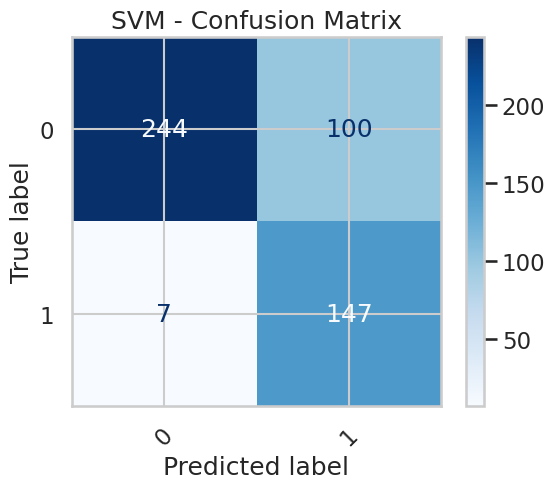

In [ ]:
evaluate_model("SVM", y_test, y_pred_svm, y_proba_svm)


==== Random Forest Evaluation ====
Balanced Accuracy: 0.811895952884325
F1 Score (binary): 0.735202492211838
Recall (binary): 0.7662337662337663
Precision (binary): 0.7065868263473054

Classification Report:
               precision    recall  f1-score   support

           0       0.89      0.86      0.87       344
           1       0.71      0.77      0.74       154

    accuracy                           0.83       498
   macro avg       0.80      0.81      0.80       498
weighted avg       0.83      0.83      0.83       498



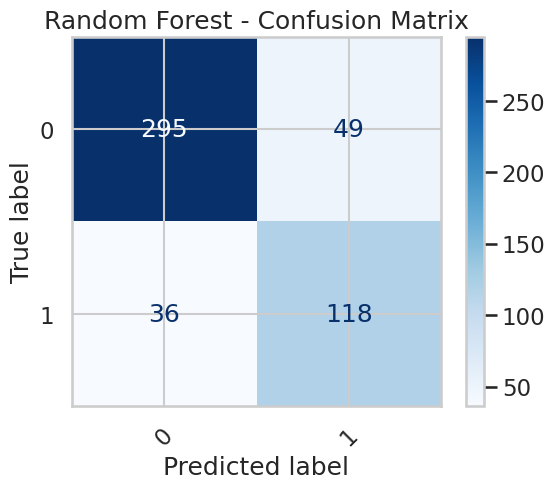

In [ ]:
evaluate_model("Random Forest", y_test, y_pred_rf, y_proba_rf)

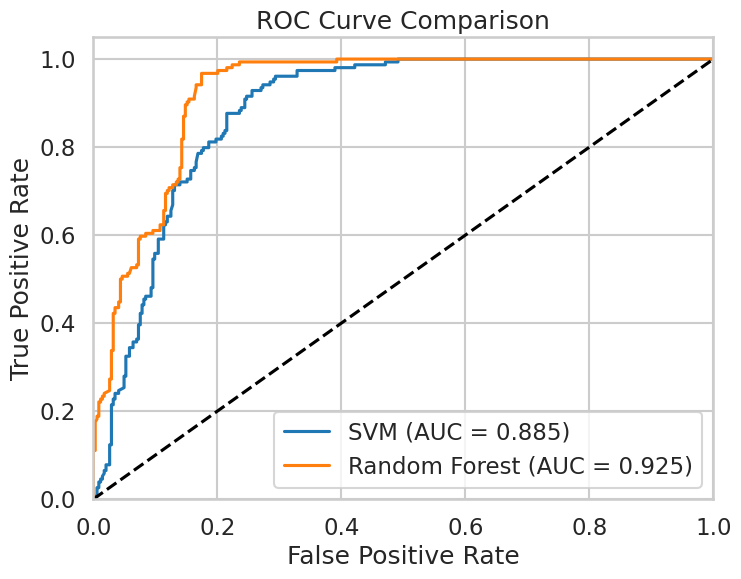

In [ ]:
from sklearn.metrics import roc_auc_score, roc_curve
import matplotlib.pyplot as plt

# Compute ROC curve and AUC for SVM
fpr_svm, tpr_svm, _ = roc_curve(y_test, y_proba_svm[:, 1])
auc_svm = roc_auc_score(y_test, y_proba_svm[:, 1])

# Compute ROC curve and AUC for RF
fpr_rf, tpr_rf, _ = roc_curve(y_test, y_proba_rf[:, 1])
auc_rf = roc_auc_score(y_test, y_proba_rf[:, 1])

plt.figure(figsize=(8,6))
plt.plot(fpr_svm, tpr_svm, label=f'SVM (AUC = {auc_svm:.3f})')
plt.plot(fpr_rf, tpr_rf, label=f'Random Forest (AUC = {auc_rf:.3f})')

plt.plot([0,1], [0,1], 'k--')  # Diagonal line for random classifier
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve Comparison')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()

 **Applying SMOTE for addressing class imbalance**

In [ ]:
from imblearn.over_sampling import SMOTE

data = data[["Text", "Gene", "Variation", "Binary_Class"]]
data["abstract"] = data["Gene"] + " " + data["Variation"] + " " + data["Text"]

X = data["abstract"].values
y = data["Binary_Class"].values

X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.3, random_state=1, stratify=y)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42, stratify=y_temp)

vectorizer = TfidfVectorizer(max_features=5000, ngram_range=(1, 2))
X_train_vec = vectorizer.fit_transform(X_train)

smote = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train_vec, y_train)

In [ ]:
print("Class distribution in Training set:")
print(pd.Series(y_train_resampled).value_counts().sort_index())

print("\nClass distribution in Validation set:")
print(pd.Series(y_val).value_counts().sort_index())

print("\nClass distribution in Test set:")
print(pd.Series(y_test).value_counts().sort_index())

Class distribution in Training set:
0    1655
1    1655
Name: count, dtype: int64

Class distribution in Validation set:
0    354
1    143
Name: count, dtype: int64

Class distribution in Test set:
0    355
1    143
Name: count, dtype: int64


## **Validation Phase**

### **Linear SVM + SMOTE**

In [ ]:
svm = SVC(kernel='linear', C=0.1, class_weight='balanced', random_state=42)
svm.fit(X_train_resampled, y_train_resampled)

X_val_vec = vectorizer.transform(X_val)
y_val_pred = svm.predict(X_val_vec)

print("Balanced Accuracy (Validation):", balanced_accuracy_score(y_val, y_val_pred))
print("Classification Report:\n", classification_report(y_val, y_val_pred))

Balanced Accuracy (Validation): 0.8074453794792777
Classification Report:
               precision    recall  f1-score   support

           0       0.97      0.66      0.79       354
           1       0.53      0.95      0.68       143

    accuracy                           0.75       497
   macro avg       0.75      0.81      0.74       497
weighted avg       0.85      0.75      0.76       497



### **Random Forest + SMOTE**

In [ ]:
rf = RandomForestClassifier(n_estimators=100, class_weight='balanced', random_state=42)
rf.fit(X_train_resampled, y_train_resampled)

X_val_vec = vectorizer.transform(X_val)
y_val_pred = rf.predict(X_val_vec)

print("Balanced Accuracy (Validation):", balanced_accuracy_score(y_val, y_val_pred))
print("Classification Report:\n", classification_report(y_val, y_val_pred))

Balanced Accuracy (Validation): 0.7965113982063134
Classification Report:
               precision    recall  f1-score   support

           0       0.89      0.86      0.87       354
           1       0.68      0.73      0.70       143

    accuracy                           0.82       497
   macro avg       0.78      0.80      0.79       497
weighted avg       0.83      0.82      0.82       497



## **Test Phase**

In [ ]:
X_combined = np.concatenate((X_train, X_val))
y_combined = np.concatenate((y_train, y_val))

vectorizer = TfidfVectorizer(max_features=5000, ngram_range=(1, 2))
X_combined_vec = vectorizer.fit_transform(X_combined)
X_test_vec = vectorizer.transform(X_test)

smote = SMOTE(random_state=42)
X_resampled, y_resampled = smote.fit_resample(X_combined_vec, y_combined)

In [ ]:
# Train SVM on resampled data
svm = SVC(kernel='linear', C=0.1, class_weight='balanced', probability=True)
svm.fit(X_resampled, y_resampled)
y_pred_svm = svm.predict(X_test_vec)
y_proba_svm = svm.predict_proba(X_test_vec)

print("SVM Balanced Accuracy (Test):", balanced_accuracy_score(y_test, y_pred_svm))
print("SVM Classification Report:\n", classification_report(y_test, y_pred_svm))

SVM Balanced Accuracy (Test): 0.815689943858958
SVM Classification Report:
               precision    recall  f1-score   support

           0       0.97      0.69      0.80       355
           1       0.55      0.94      0.69       143

    accuracy                           0.76       498
   macro avg       0.76      0.82      0.75       498
weighted avg       0.85      0.76      0.77       498



In [ ]:
# Train Random Forest on resampled data
rf = RandomForestClassifier(
    max_depth=20,
    n_estimators=200,
    min_samples_split=2,
    class_weight='balanced',
    random_state=42
)
rf.fit(X_resampled, y_resampled)
y_pred_rf = rf.predict(X_test_vec)
y_proba_rf = rf.predict_proba(X_test_vec)

print("Random Forest Balanced Accuracy (Test):", balanced_accuracy_score(y_test, y_pred_rf))
print("Random Forest Classification Report:\n", classification_report(y_test, y_pred_rf))

Random Forest Balanced Accuracy (Test): 0.8185659411011523
Random Forest Classification Report:
               precision    recall  f1-score   support

           0       0.89      0.91      0.90       355
           1       0.76      0.73      0.75       143

    accuracy                           0.86       498
   macro avg       0.83      0.82      0.82       498
weighted avg       0.86      0.86      0.86       498




==== SVM Evaluation ====
Balanced Accuracy: 0.815689943858958
F1 Score (binary): 0.6940874035989717
Recall (binary): 0.9440559440559441
Precision (binary): 0.5487804878048781

Classification Report:
               precision    recall  f1-score   support

           0       0.97      0.69      0.80       355
           1       0.55      0.94      0.69       143

    accuracy                           0.76       498
   macro avg       0.76      0.82      0.75       498
weighted avg       0.85      0.76      0.77       498



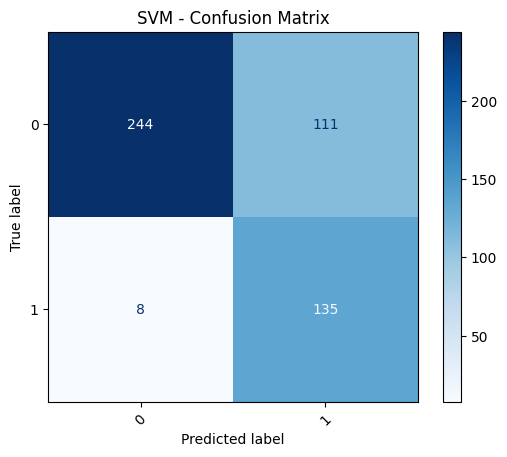

In [ ]:
# Evaluate models
evaluate_model("SVM", y_test, y_pred_svm, y_proba_svm)


==== Random Forest Evaluation ====
Balanced Accuracy: 0.8185659411011523
F1 Score (binary): 0.7455197132616488
Recall (binary): 0.7272727272727273
Precision (binary): 0.7647058823529411

Classification Report:
               precision    recall  f1-score   support

           0       0.89      0.91      0.90       355
           1       0.76      0.73      0.75       143

    accuracy                           0.86       498
   macro avg       0.83      0.82      0.82       498
weighted avg       0.86      0.86      0.86       498



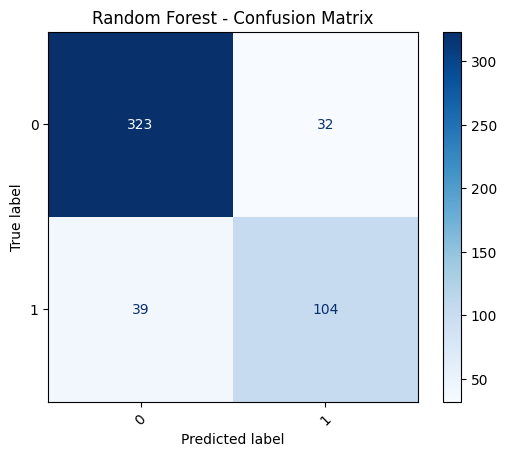

In [ ]:
evaluate_model("Random Forest", y_test, y_pred_rf, y_proba_rf)

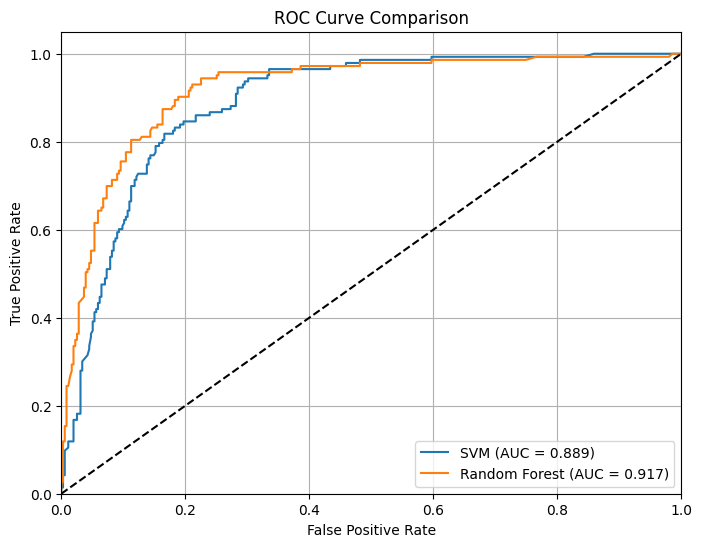

In [ ]:
# Plot ROC curves
fpr_svm, tpr_svm, _ = roc_curve(y_test, y_proba_svm[:, 1])
auc_svm = roc_auc_score(y_test, y_proba_svm[:, 1])

fpr_rf, tpr_rf, _ = roc_curve(y_test, y_proba_rf[:, 1])
auc_rf = roc_auc_score(y_test, y_proba_rf[:, 1])

plt.figure(figsize=(8,6))
plt.plot(fpr_svm, tpr_svm, label=f'SVM (AUC = {auc_svm:.3f})')
plt.plot(fpr_rf, tpr_rf, label=f'Random Forest (AUC = {auc_rf:.3f})')
plt.plot([0,1], [0,1], 'k--')
plt.xlim([0, 1])
plt.ylim([0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve Comparison')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()

# **Data preparation for deep learning models**

In [ ]:
data = pd.read_csv('/content/drive/MyDrive/data2.csv')
data = data.dropna()
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 3316 entries, 0 to 3320
Data columns (total 11 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   ID                  3316 non-null   int64 
 1   Gene                3316 non-null   object
 2   Variation           3316 non-null   object
 3   Class               3316 non-null   int64 
 4   Text                3316 non-null   object
 5   nb_sentences        3316 non-null   int64 
 6   nb_words            3316 non-null   int64 
 7   Mutation_Name       3316 non-null   object
 8   abstract            3316 non-null   object
 9   Top_Relevant_Words  3316 non-null   object
 10  label               3316 non-null   int64 
dtypes: int64(5), object(6)
memory usage: 310.9+ KB


#### **Turn your dataset into a binary classification problem where:**

- Class 7 → Positive class (1)

- All other classes → Negative class (0)

In [ ]:
data['Binary_Class'] = (data['Class'] == 7).astype(int)
print(data['Binary_Class'].value_counts())

data = data[["Text", "Gene", "Variation", "Binary_Class"]]
data["abstract"] = data["Gene"] + " " + data["Variation"] + " " + data["Text"]

X = data["abstract"].values
y = data["Binary_Class"].values

X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.3, random_state=1)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

print()
print(f"Training set: {len(X_train)} samples")
print(f"Validation set: {len(X_val)} samples")
print(f"Test set: {len(X_test)} samples")

Binary_Class
0    2364
1     952
Name: count, dtype: int64

Training set: 2321 samples
Validation set: 497 samples
Test set: 498 samples


In [ ]:
data.head()

,Text,Gene,Variation,Binary_Class,abstract
0,Cyclin-dependent kinases (CDKs) regulate a var...,FAM58A,Truncating Mutations,0,FAM58A Truncating Mutations Cyclin-dependent k...
1,Abstract Background Non-small cell lung canc...,CBL,W802*,0,CBL W802* Abstract Background Non-small cell...
2,Abstract Background Non-small cell lung canc...,CBL,Q249E,0,CBL Q249E Abstract Background Non-small cell...
3,Recent evidence has demonstrated that acquired...,CBL,N454D,0,CBL N454D Recent evidence has demonstrated tha...
4,Oncogenic mutations in the monomeric Casitas B...,CBL,L399V,0,CBL L399V Oncogenic mutations in the monomeric...


In [ ]:
data.tail()

,Text,Gene,Variation,Binary_Class,abstract
3316,Introduction Myelodysplastic syndromes (MDS) ...,RUNX1,D171N,0,RUNX1 D171N Introduction Myelodysplastic synd...
3317,Introduction Myelodysplastic syndromes (MDS) ...,RUNX1,A122*,0,RUNX1 A122* Introduction Myelodysplastic synd...
3318,The Runt-related transcription factor 1 gene (...,RUNX1,Fusions,0,RUNX1 Fusions The Runt-related transcription f...
3319,The RUNX1/AML1 gene is the most frequent targe...,RUNX1,R80C,0,RUNX1 R80C The RUNX1/AML1 gene is the most fre...
3320,The most frequent mutations associated with le...,RUNX1,K83E,0,RUNX1 K83E The most frequent mutations associa...


In [ ]:
nltk.download('stopwords')
STOPWORDS = set(stopwords.words('english'))

def tokenize(text):
    """
    Tokenizes English text by:
    - converting to lowercase
    - removing punctuation
    - removing numbers
    - removing English stopwords

    Args:
        text (str): Input English text.

    Returns:
        List[str]: List of cleaned tokens without stopwords and numbers.
    """
    text = re.sub(r'[^\w\s]', ' ', text)
    tokens = re.findall(r'\b[a-z]+\b', text.lower())
    tokens = [word for word in tokens if word not in STOPWORDS]

    return tokens

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [ ]:
all_tokens = [token for text in X_train for token in tokenize(text)]
vocab = Counter(all_tokens)
filtered_vocab = {word: freq for word, freq in vocab.items() if freq >= 3}
print(len(filtered_vocab))
VOCAB_SIZE =  len(filtered_vocab)

sorted_filtered_vocab = dict(sorted(filtered_vocab.items(), key=lambda item: item[1], reverse=True)[:VOCAB_SIZE])

word_to_index = {word: idx for idx, (word, _) in enumerate(sorted_filtered_vocab.items(), 1)}
word_to_index["<PAD>"] = 0
word_to_index["<UNK>"] = len(word_to_index)

index_to_word = {idx: word for word, idx in word_to_index.items()}
print(word_to_index["malaria"])
print(index_to_word[10])

print(index_to_word[301])
print(word_to_index["host"])

40865
11312
figure
involved
3916


In [11]:
def text_to_sequence(text):
    """
    Converts the tokenized text into a sequence of indices based on a word-to-index mapping.

    Args:
        text: A string containing the text to be converted.

    Returns:
        A list of integers representing the sequence of token indices.
    """
    return [word_to_index.get(token, word_to_index["<UNK>"]) for token in tokenize(text)]

def pad_to_tensor(sequences, max_len=None):
    """
    Pads sequences to the specified maximum length, or truncates them if they exceed it.

    Args:
        sequences: A list of sequences (each sequence is a list of integers).
        max_len: The maximum length to which sequences should be padded. If None, no padding is applied.

    Returns:
        A tensor containing the padded (or truncated) sequences.
    """
    padded_sequences = [torch.tensor(seq, dtype=torch.long) for seq in sequences]
    if max_len:
        padded_sequences = [seq[:max_len] for seq in padded_sequences]
        padded_sequences = [
            torch.cat([seq, torch.zeros(max_len - len(seq), dtype=torch.long)], 0) if len(seq) < max_len else seq
            for seq in padded_sequences
        ]

    return torch.stack(padded_sequences)

class TextDataset(Dataset):
    """
    Custom Dataset for handling text data and labels.

    Args:
        X_data: Input features (e.g., tokenized text).
        y_data: Labels corresponding to the text data.
        raw_text_data: (Optional) The raw text data for reference (default is None).
    """
    def __init__(self, X_data, y_data, raw_text_data=None):
        self.X = torch.tensor(X_data, dtype=torch.long)
        self.y = torch.tensor(y_data, dtype=torch.long)
        self.raw_text_data = raw_text_data

    def __len__(self):
        return len(self.X)

    def __getitem__(self, idx):
        input_tensor = self.X[idx]
        target_tensor = self.y[idx]
        raw_text = self.raw_text_data[idx] if self.raw_text_data is not None else None
        return input_tensor, target_tensor, raw_text

In [ ]:
print(word_to_index["patient"], word_to_index["cell"])

51 56


In [12]:
X_train_seq = [text_to_sequence(text) for text in X_train]
X_val_seq = [text_to_sequence(text) for text in X_val]
X_test_seq = [text_to_sequence(text) for text in X_test]

print(X_train_seq[0])

[2543, 323, 1, 24, 934, 8, 2568, 9185, 9251, 390, 4120, 1355, 1037, 1323, 19, 2181, 1785, 3, 332, 2521, 3, 3435, 526, 4120, 99, 1, 2346, 1499, 14, 1157, 2080, 437, 1620, 729, 59, 885, 562, 99, 1, 47, 4120, 794, 31, 1034, 9, 148, 177, 267, 110, 549, 9, 148, 1, 1751, 978, 19, 14, 2347, 147, 50, 895, 63, 2978, 19466, 1, 32712, 215, 36, 4432, 208, 12, 19, 5002, 766, 314, 58, 412, 9, 148, 1, 4361, 183, 2182, 2426, 3435, 2784, 827, 2, 4840, 4878, 209, 343, 455, 26, 2041, 1593, 4347, 621, 51, 82, 3, 3435, 270, 39, 22165, 1789, 518, 123, 9, 148, 110, 343, 345, 17, 361, 14, 160, 2861, 342, 5002, 58, 3, 7227, 7508, 4, 3, 3435, 32713, 5002, 24, 2169, 1162, 1142, 569, 9185, 9251, 390, 4120, 2654, 714, 2009, 10493, 230, 10990, 3550, 1589, 2263, 11178, 9802, 10782, 4120, 11, 6049, 223, 416, 1668, 992, 892, 109, 3421, 18, 6662, 7888, 2792, 323, 1, 24, 18, 1638, 348, 456, 47, 526, 4120, 11, 194, 1, 11384, 447, 794, 31, 1137, 705, 214, 634, 124, 209, 3361, 123, 4120, 722, 108, 752, 2112, 248, 964, 1117

In [13]:
max_length = 400

X_train_tensor = pad_to_tensor(X_train_seq, max_len=max_length)
X_val_tensor = pad_to_tensor(X_val_seq, max_len=max_length)
X_test_tensor = pad_to_tensor(X_test_seq, max_len=max_length)

print(f"Train Tensor Shape: {X_train_tensor.shape}, Type: {X_train_tensor.dtype}")
print(f"Validation Tensor Shape: {X_val_tensor.shape}, Type: {X_val_tensor.dtype}")
print(f"Test Tensor Shape: {X_test_tensor.shape}, Type: {X_test_tensor.dtype}")

y_train_tensor = torch.tensor(y_train)
y_val_tensor = torch.tensor(y_val)
y_test_tensor = torch.tensor(y_test)

Train Tensor Shape: torch.Size([2321, 400]), Type: torch.int64
Validation Tensor Shape: torch.Size([497, 400]), Type: torch.int64
Test Tensor Shape: torch.Size([498, 400]), Type: torch.int64


In [ ]:
batch_size = 16
train_dataset = TextDataset(X_train_tensor, y_train, raw_text_data=X_train)
val_dataset = TextDataset(X_val_tensor, y_val, raw_text_data=X_val)
test_dataset = TextDataset(X_test_tensor, y_test, raw_text_data=X_test)

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)


In [ ]:
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

In [ ]:
combined_dataset = ConcatDataset([train_dataset, val_dataset])
combined_loader = DataLoader(combined_dataset, batch_size=batch_size, shuffle=True)

print(f"Training set size: {len(train_dataset)}")
print(f"Validation set size: {len(val_dataset)}")
print(f"Test set size: {len(test_dataset)}")
print(f"Combined dataset size: {len(combined_dataset)}")

NUM_CLASSES = len(torch.unique(y_train_tensor))
VOCAB_SIZE = len(word_to_index)
print(NUM_CLASSES)

# **III. GRU and LSTM models with embeddings learned from scratch**

In [ ]:
# ============ Define Bidirectional GRU Model ============
class GRU_Model(nn.Module):
    def __init__(self, vocab_size, embedding_dim, hidden_dim, output_dim=1,
                 num_layers=1, dropout_prob=0.5, embedding_weights=None, freeze_embeddings=False):
        super(GRU_Model, self).__init__()

        if embedding_weights is not None:
            self.embedding = nn.Embedding.from_pretrained(embedding_weights, freeze=freeze_embeddings)
        else:
            self.embedding = nn.Embedding(vocab_size, embedding_dim)

        self.gru = nn.GRU(
            input_size=embedding_dim,
            hidden_size=hidden_dim,
            num_layers=num_layers,
            batch_first=True,
            dropout=dropout_prob if num_layers > 1 else 0,
            bidirectional=True
        )

        self.dropout = nn.Dropout(dropout_prob)
        self.fc = nn.Linear(hidden_dim * 2, output_dim)

    def forward(self, x):
        embedded = self.embedding(x)
        gru_out, _ = self.gru(embedded)
        gru_out = self.dropout(gru_out[:, -1, :])
        out = self.fc(gru_out)
        return out

# ============ Define Bidirectional LSTM Model ============
class LSTM_Model(nn.Module):
    def __init__(self, vocab_size, embedding_dim, hidden_dim, output_dim=1,
                 embedding_weights=None, num_layers=1, dropout_prob=0.3, freeze_embeddings=True):
        super(LSTM_Model, self).__init__()

        if embedding_weights is not None:
            self.embedding = nn.Embedding.from_pretrained(embedding_weights, freeze=freeze_embeddings)
        else:
            self.embedding = nn.Embedding(vocab_size, embedding_dim)

        self.lstm = nn.LSTM(
            input_size=embedding_dim,
            hidden_size=hidden_dim,
            num_layers=num_layers,
            batch_first=True,
            dropout=dropout_prob if num_layers > 1 else 0,
            bidirectional=True
        )

        self.dropout = nn.Dropout(dropout_prob)
        self.fc = nn.Linear(hidden_dim * 2, output_dim)

    def forward(self, x):
        embedded = self.embedding(x)
        lstm_out, _ = self.lstm(embedded)
        lstm_out = self.dropout(lstm_out[:, -1, :])
        out = self.fc(lstm_out)
        return out

In [ ]:
clip = 5.0  # gradient clipping

def epoch_time(start_time, end_time):
    elapsed_time = end_time - start_time
    elapsed_mins = int(elapsed_time / 60)
    elapsed_secs = int(elapsed_time - (elapsed_mins * 60))
    return elapsed_mins, elapsed_secs

clip = 5.0  # gradient clipping

def train_epoch(model, train_loader, optimizer, criterion, device):
    model.train()
    total_loss = 0.0
    all_preds, all_labels = [], []

    for batch in train_loader:
        if len(batch) == 3:
            inputs, targets, _ = batch
        else:
            inputs, targets = batch

        inputs = inputs.to(device)
        targets = targets.float().to(device)  # BCE expects float targets

        optimizer.zero_grad()
        outputs = model(inputs).squeeze(1)  # (batch_size,) shape
        loss = criterion(outputs, targets)
        loss.backward()

        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=clip)
        optimizer.step()

        total_loss += loss.item()

        preds = torch.round(torch.sigmoid(outputs)).detach().cpu().numpy()
        labels = targets.cpu().numpy()

        all_preds.extend(preds)
        all_labels.extend(labels)

    avg_loss = total_loss / len(train_loader)
    balanced_acc = balanced_accuracy_score(all_labels, all_preds)

    return avg_loss, balanced_acc

def validate_epoch(model, val_loader, criterion, device):
    model.eval()
    total_loss = 0.0
    all_preds, all_labels = [], []

    with torch.no_grad():
        for batch in val_loader:
            if len(batch) == 3:
                inputs, targets, _ = batch
            else:
                inputs, targets = batch

            inputs = inputs.to(device)
            targets = targets.float().to(device)

            outputs = model(inputs).squeeze(1)
            loss = criterion(outputs, targets)
            total_loss += loss.item()

            preds = torch.round(torch.sigmoid(outputs)).detach().cpu().numpy()
            labels = targets.cpu().numpy()

            all_preds.extend(preds)
            all_labels.extend(labels)

    avg_loss = total_loss / len(val_loader)
    balanced_acc = balanced_accuracy_score(all_labels, all_preds)
    f1 = f1_score(all_labels, all_preds, average="binary", zero_division=0)

    return avg_loss, balanced_acc, f1


def test_epoch(model, test_loader, criterion, device):
    model.eval()
    total_loss, total_accuracy = 0, 0
    all_labels, all_preds = [], []

    with torch.no_grad():
        for batch in test_loader:
            input_tensor, target_tensor, _ = batch
            input_tensor = input_tensor.to(device)
            target_tensor = target_tensor.float().to(device)

            output = model(input_tensor).squeeze(1)
            loss = criterion(output, target_tensor)

            preds = torch.round(torch.sigmoid(output)).detach().cpu().numpy()
            labels = target_tensor.cpu().numpy()

            batch_accuracy = accuracy_score(labels, preds)
            total_loss += loss.item()
            total_accuracy += batch_accuracy * len(labels)

            all_preds.extend(preds)
            all_labels.extend(labels)

    f1 = f1_score(all_labels, all_preds, average="binary", zero_division=0)
    balanced_acc = balanced_accuracy_score(all_labels, all_preds)
    precision = precision_score(all_labels, all_preds, average="binary", zero_division=0)
    recall = recall_score(all_labels, all_preds, average="binary", zero_division=0)

    avg_loss = total_loss / len(test_loader)
    avg_accuracy = total_accuracy / len(test_loader.dataset)

    return avg_loss, avg_accuracy, f1, balanced_acc, recall, precision

def get_hidden_states(model, dataloader, device):
    """
    This function extracts the hidden states from a model (either GRU or LSTM) for each sample in the dataloader.
    The hidden states are taken from the last time step of the sequence, which are typically used for classification tasks.

    Args:
        model: A PyTorch model that contains an embedding layer and either a GRU or LSTM layer.
        dataloader: A DataLoader containing batches of input data and their corresponding targets.
        device: The device (CPU or GPU) to run the model on.

    Returns:
        hidden_states: A numpy array containing the hidden states for each sample in the dataloader.
        labels: A numpy array containing the target labels corresponding to each input sample.
    """
    model.eval()
    hidden_states, labels = [], []

    with torch.no_grad():
        for batch in dataloader:
            inputs, targets, _ = batch
            inputs = inputs.to(device)

            embedded = model.embedding(inputs)

            if hasattr(model, "gru"):
                gru_out, _ = model.gru(embedded)
                hidden_state = gru_out[:, -1, :]

            elif hasattr(model, "lstm"):
                lstm_out, (hidden, _) = model.lstm(embedded)
                hidden_state = hidden[-1]

            else:
                raise ValueError("Unsupported model type. Model must contain GRU or LSTM.")

            hidden_states.append(hidden_state.cpu().numpy())
            labels.append(targets.cpu().numpy())

    hidden_states = np.concatenate(hidden_states, axis=0)
    labels = np.concatenate(labels, axis=0)

    return hidden_states, labels

def count_parameters(model):
    """
    Computes the total number of trainable parameters in a model.

    Args:
        model: A PyTorch model instance.

    Returns:
        The total number of trainable parameters in the model.
    """
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

def custom_collate_fn(batch):
    """
    Custom collate function to combine input tensors, target tensors, and raw texts into a batch.
    Stacks inputs and targets into tensors, returns raw texts as a list.

    Args:
        batch (list): List of tuples containing input tensor, target tensor, and raw text.

    Returns:
        tuple: Stacked inputs tensor, stacked targets tensor, and list of raw texts.
    """
    inputs, targets, raw_texts = zip(*batch)
    inputs = torch.stack(inputs)
    targets = torch.stack(targets)
    return inputs, targets, list(raw_texts)

class EarlyStopping:
    def __init__(self, patience=2, delta=0.001):
        self.patience = patience
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.delta = delta

    def __call__(self, val_loss):
        score = -val_loss
        if self.best_score is None:
            self.best_score = score
        elif score < self.best_score + self.delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.counter = 0

## **Validation Phase**

### **GRU**

In [ ]:
model = GRU_Model(vocab_size=len(word_to_index), embedding_dim=350, hidden_dim=300, num_layers=1, dropout_prob=0.3).to(device)

print(model)
num_params = count_parameters(model)
print()
print(f"Total trainable parameters: {num_params}")

GRU_Model(
  (embedding): Embedding(40867, 350)
  (gru): GRU(350, 300, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (fc): Linear(in_features=600, out_features=1, bias=True)
)

Total trainable parameters: 15477651


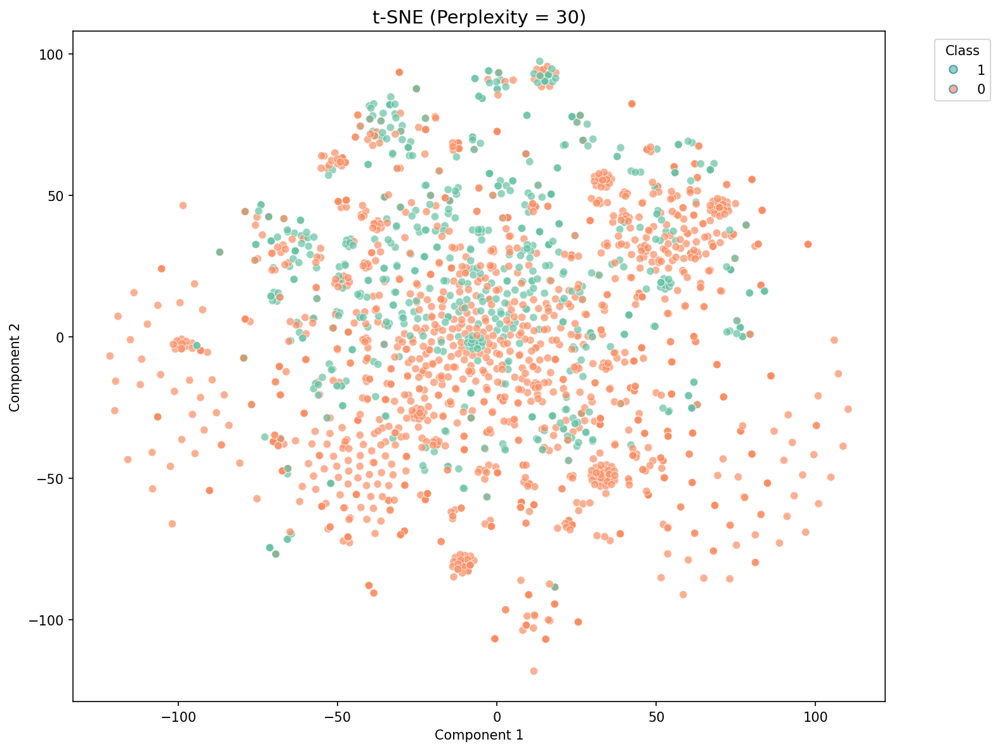

In [ ]:
model.eval()
embeddings = []
labels = []

with torch.no_grad():
    for inputs, targets, _ in train_loader:
        inputs = inputs.to(device)

        embedded = model.embedding(inputs)              # e.g. (B, seq_len, emb_dim)
        emb_mean = embedded.mean(dim=1).cpu().numpy()   # (B, emb_dim)
        embeddings.append(emb_mean)
        labels.extend(targets.cpu().numpy())

# Stack to arrays
embeddings = np.vstack(embeddings)
labels = np.array(labels)

labels = pd.Series(labels).astype(str)
n_classes = labels.nunique()
palette = sns.color_palette("Set2", n_colors=n_classes)

perplexity = 30
tsne = TSNE(n_components=2, perplexity=perplexity, random_state=42, init='pca')
tsne_result = tsne.fit_transform(embeddings)

fig, ax = plt.subplots(figsize=(10, 8), dpi=150)
sns.scatterplot(
    x=tsne_result[:, 0],
    y=tsne_result[:, 1],
    hue=labels,
    palette=palette,
    alpha=0.7,
    ax=ax,
    legend=False
)

ax.set_title(f"t-SNE (Perplexity = {perplexity})", fontsize=14)
ax.set_xlabel("Component 1")
ax.set_ylabel("Component 2")

unique_labels = labels.unique()
handles = []
for i, lab in enumerate(unique_labels):
    handles.append(plt.Line2D([0], [0], marker='o', linestyle='', markersize=6,
                              markerfacecolor=palette[i], alpha=0.7, label=lab))

fig.legend(handles=handles, title="Class", bbox_to_anchor=(0.98, 0.95), loc='upper left')

plt.tight_layout(rect=[0, 0, 0.95, 1])
plt.show()

In [ ]:
learning_rate = 1e-4
num_epochs = 18
patience = 4
min_delta = 1e-4
monitor = "val_loss"

loss_function = nn.BCEWithLogitsLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min' if monitor == "val_loss" else 'max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-7
)

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []
val_f1s = []

best_metric = float('inf') if monitor == "val_loss" else -float('inf')
best_epoch = -1
stalled_epochs = 0
best_state = None

with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, loss_function, device)
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)

        val_loss, val_acc, val_f1 = validate_epoch(model, val_loader, loss_function, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)
        val_f1s.append(val_f1)

        current_metric = val_loss if monitor == "val_loss" else val_f1
        scheduler.step(current_metric)

        # Early stopping logic
        improved = False
        if monitor == "val_loss":
            if current_metric < best_metric - min_delta:
                improved = True
        else:  # monitor == "val_f1"
            if current_metric > best_metric + min_delta:
                improved = True

        if improved:
            best_metric = current_metric
            best_epoch = epoch
            stalled_epochs = 0
            # save best weights (in-memory)
            best_state = {k: v.cpu().clone() for k, v in model.state_dict().items()}
        else:
            stalled_epochs += 1

        end_time = time.time()
        epoch_duration = end_time - start_time
        pbar.set_description(
            f"Epoch {epoch+1}/{num_epochs} - Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, "
            f"Train Acc: {train_acc:.2%}, Val Acc: {val_acc:.2%}, Val F1: {val_f1:.2%}, Time: {epoch_duration / 60:.2f} min"
        )
        pbar.update(1)

        if stalled_epochs >= patience:
            print(f"\nEarly stopping triggered (no improvement in {patience} epochs).")
            break

if best_state is not None:
    model.load_state_dict(best_state)
    print(f"Restored best model from epoch {best_epoch+1} with best {monitor} = {best_metric:.6f}.")
else:
    print("No best state recorded (no improvement during training).")

Epoch 12/18 - Train Loss: 1.0367, Val Loss: 1.3810, Train Acc: 46.54%, Val Acc: 36.69%, Val F1: 38.73%, Time: 0.39 min:  67%|██████▋   | 12/18 [04:11<02:05, 20.99s/epoch]


Early stopping triggered (no improvement in 4 epochs).
Restored best model from epoch 8 with best val_loss = 1.306874.


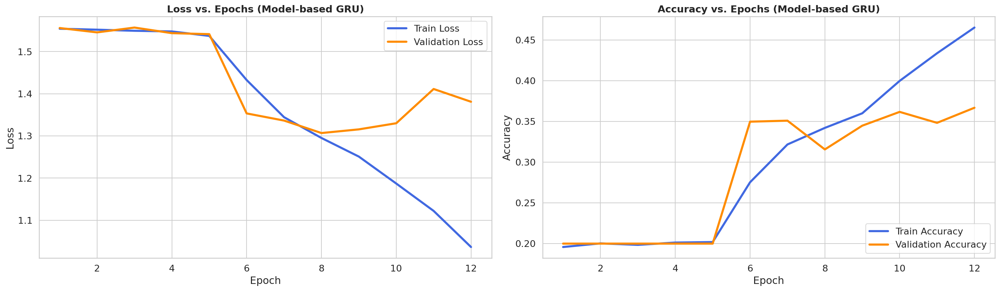

In [ ]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

# High-resolution figure
plt.figure(figsize=(20, 6), dpi=150)

# === 1. Loss Curve ===
plt.subplot(1, 2, 1)
sns.lineplot(x=range(1, len(train_losses) + 1), y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=range(1, len(val_losses) + 1), y=val_losses, label='Validation Loss', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='upper right')

# === 2. Accuracy Curve ===
plt.subplot(1, 2, 2)
sns.lineplot(x=range(1, len(train_accuracies) + 1), y=train_accuracies, label='Train Accuracy', color='royalblue')
sns.lineplot(x=range(1, len(val_accuracies) + 1), y=val_accuracies, label='Validation Accuracy', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

plt.tight_layout()
plt.show()

### **GRU + SMOTE**


In [ ]:
model = GRU_Model(vocab_size=len(word_to_index), embedding_dim=350, hidden_dim=600, num_layers=1, dropout_prob=0.2).to(device)

print(model)
num_params = count_parameters(model)
print()
print(f"Total trainable parameters: {num_params}")

GRU_Model(
  (embedding): Embedding(25042, 350)
  (gru): GRU(350, 600, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.2, inplace=False)
  (fc): Linear(in_features=1200, out_features=5, bias=True)
)

Total trainable parameters: 12197905


In [ ]:
from imblearn.over_sampling import SMOTE
from torch.utils.data import DataLoader

BATCH_SIZE = 16

# Convert training tensors to numpy
X_train_np = X_train_tensor.cpu().numpy()
y_train_np = y_train_tensor.cpu().numpy()

# Create a mapping from vector to raw text for later retrieval
original_text_map = {
    tuple(vec): text for vec, text in zip(X_train_np, X_train)
}

# Apply SMOTE to training data
smote = SMOTE(sampling_strategy='auto', random_state=42)
X_resampled_np, y_resampled_np = smote.fit_resample(X_train_np, y_train_np)

# Reconstruct raw texts (if possible), else tag as synthetic
raw_text_resampled = []
for vec in X_resampled_np:
    key = tuple(vec)
    raw_text_resampled.append(
        original_text_map.get(key, "[Synthetic sample - no raw text]")
    )

# Convert back to tensors
X_resampled_tensor = torch.tensor(X_resampled_np, dtype=torch.float)
y_resampled_tensor = torch.tensor(y_resampled_np, dtype=torch.long)

# Create dataset and dataloader
train_dataset_smote = TextDataset(
    X_resampled_tensor, y_resampled_tensor, raw_text_data=raw_text_resampled
)
train_loader_smote = DataLoader(
    train_dataset_smote,
    batch_size=BATCH_SIZE,
    shuffle=True,
    collate_fn=custom_collate_fn  # Preserves original collation behavior
)

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


In [ ]:
learning_rate = 1e-4
num_epochs = 18
patience = 4
min_delta = 1e-4
monitor = "val_loss"

loss_function = nn.BCEWithLogitsLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min' if monitor == "val_loss" else 'max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-7
)

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []
val_f1s = []

best_metric = float('inf') if monitor == "val_loss" else -float('inf')
best_epoch = -1
stalled_epochs = 0
best_state = None

with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader_smote, optimizer, loss_function, device)
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)

        val_loss, val_acc, val_f1 = validate_epoch(model, val_loader, loss_function, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)
        val_f1s.append(val_f1)

        current_metric = val_loss if monitor == "val_loss" else val_f1
        scheduler.step(current_metric)

        # Early stopping logic
        improved = False
        if monitor == "val_loss":
            if current_metric < best_metric - min_delta:
                improved = True
        else:  # monitor == "val_f1"
            if current_metric > best_metric + min_delta:
                improved = True

        if improved:
            best_metric = current_metric
            best_epoch = epoch
            stalled_epochs = 0
            # save best weights (in-memory)
            best_state = {k: v.cpu().clone() for k, v in model.state_dict().items()}
        else:
            stalled_epochs += 1

        end_time = time.time()
        epoch_duration = end_time - start_time
        pbar.set_description(
            f"Epoch {epoch+1}/{num_epochs} - Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, "
            f"Train Acc: {train_acc:.2%}, Val Acc: {val_acc:.2%}, Val F1: {val_f1:.2%}, Time: {epoch_duration / 60:.2f} min"
        )
        pbar.update(1)

        if stalled_epochs >= patience:
            print(f"\nEarly stopping triggered (no improvement in {patience} epochs).")
            break

if best_state is not None:
    model.load_state_dict(best_state)
    print(f"Restored best model from epoch {best_epoch+1} with best {monitor} = {best_metric:.6f}.")
else:
    print("No best state recorded (no improvement during training).")

Epoch 9/18 - Train Loss: 1.0789, Val Loss: 1.5424, Train Acc: 57.40%, Val Acc: 41.16%, Val F1: 31.88%, Time: 0.51 min:  50%|█████     | 9/18 [05:48<05:48, 38.74s/epoch]


Early stopping triggered (no improvement in 4 epochs).
Restored best model from epoch 5 with best val_loss = 1.348982.


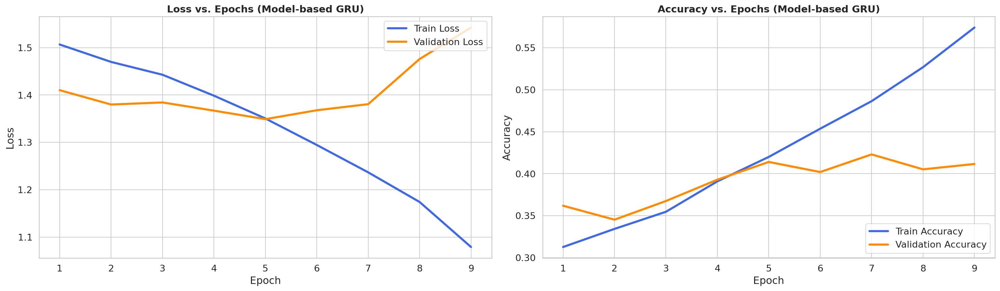

In [ ]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

# High-resolution figure
plt.figure(figsize=(20, 6), dpi=150)

# === 1. Loss Curve ===
plt.subplot(1, 2, 1)
sns.lineplot(x=range(1, len(train_losses) + 1), y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=range(1, len(val_losses) + 1), y=val_losses, label='Validation Loss', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='upper right')

# === 2. Accuracy Curve ===
plt.subplot(1, 2, 2)
sns.lineplot(x=range(1, len(train_accuracies) + 1), y=train_accuracies, label='Train Accuracy', color='royalblue')
sns.lineplot(x=range(1, len(val_accuracies) + 1), y=val_accuracies, label='Validation Accuracy', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

plt.tight_layout()
plt.show()

### **GRU + Weight Class**

In [ ]:
model = GRU_Model(vocab_size=len(word_to_index), embedding_dim=350, hidden_dim=300, num_layers=1, dropout_prob=0.5).to(device)

print(model)
num_params = count_parameters(model)
print()
print(f"Total trainable parameters: {num_params}")

GRU_Model(
  (embedding): Embedding(20933, 350)
  (gru): GRU(350, 300, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.5, inplace=False)
  (fc): Linear(in_features=600, out_features=5, bias=True)
)

Total trainable parameters: 8503155


In [ ]:
class_weights = compute_class_weight('balanced', classes=np.unique(y_train_tensor.cpu().numpy()), y=y_train_tensor.cpu().numpy())
class_weights_tensor = torch.tensor(class_weights, dtype=torch.float).to(device)

batch_size = 16
train_dataset = TextDataset(X_train_tensor, y_train, raw_text_data=X_train)
val_dataset = TextDataset(X_val_tensor, y_val, raw_text_data=X_val)
test_dataset = TextDataset(X_test_tensor, y_test, raw_text_data=X_test)


train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)


In [ ]:
learning_rate = 1e-4
num_epochs = 18
patience = 4
min_delta = 1e-4
monitor = "val_loss"

loss_function = nn.BCEWithLogitsLoss(class_weights_tensor)
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min' if monitor == "val_loss" else 'max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-7
)

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []
val_f1s = []

best_metric = float('inf') if monitor == "val_loss" else -float('inf')
best_epoch = -1
stalled_epochs = 0
best_state = None

with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, loss_function, device)
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)

        val_loss, val_acc, val_f1 = validate_epoch(model, val_loader, loss_function, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)
        val_f1s.append(val_f1)

        current_metric = val_loss if monitor == "val_loss" else val_f1
        scheduler.step(current_metric)

        # Early stopping logic
        improved = False
        if monitor == "val_loss":
            if current_metric < best_metric - min_delta:
                improved = True
        else:  # monitor == "val_f1"
            if current_metric > best_metric + min_delta:
                improved = True

        if improved:
            best_metric = current_metric
            best_epoch = epoch
            stalled_epochs = 0
            # save best weights (in-memory)
            best_state = {k: v.cpu().clone() for k, v in model.state_dict().items()}
        else:
            stalled_epochs += 1

        end_time = time.time()
        epoch_duration = end_time - start_time
        pbar.set_description(
            f"Epoch {epoch+1}/{num_epochs} - Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, "
            f"Train Acc: {train_acc:.2%}, Val Acc: {val_acc:.2%}, Val F1: {val_f1:.2%}, Time: {epoch_duration / 60:.2f} min"
        )
        pbar.update(1)

        if stalled_epochs >= patience:
            print(f"\nEarly stopping triggered (no improvement in {patience} epochs).")
            break

if best_state is not None:
    model.load_state_dict(best_state)
    print(f"Restored best model from epoch {best_epoch+1} with best {monitor} = {best_metric:.6f}.")
else:
    print("No best state recorded (no improvement during training).")

Epoch 18/18 - Train Loss: 0.6657, Val Loss: 1.5643, Train Acc: 79.09%, Val Acc: 46.90%, Val F1: 43.41%, Time: 0.43 min: 100%|██████████| 18/18 [07:42<00:00, 25.71s/epoch]


Early stopping triggered (no improvement in 4 epochs).
Restored best model from epoch 14 with best val_loss = 1.278782.


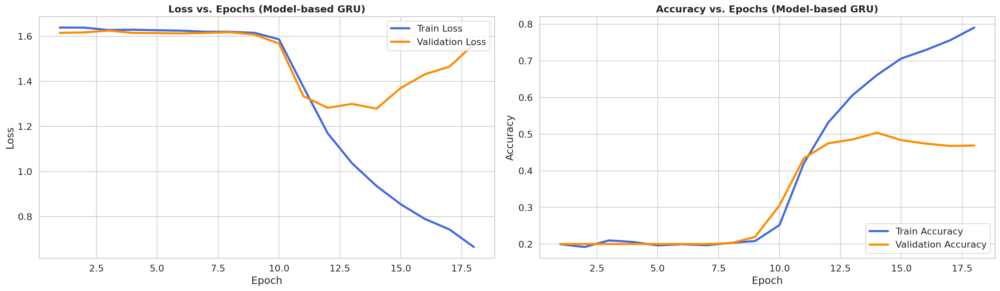

In [ ]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

# High-resolution figure
plt.figure(figsize=(20, 6), dpi=150)

# === 1. Loss Curve ===
plt.subplot(1, 2, 1)
sns.lineplot(x=range(1, len(train_losses) + 1), y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=range(1, len(val_losses) + 1), y=val_losses, label='Validation Loss', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='upper right')

# === 2. Accuracy Curve ===
plt.subplot(1, 2, 2)
sns.lineplot(x=range(1, len(train_accuracies) + 1), y=train_accuracies, label='Train Accuracy', color='royalblue')
sns.lineplot(x=range(1, len(val_accuracies) + 1), y=val_accuracies, label='Validation Accuracy', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

plt.tight_layout()
plt.show()

### **LSTM**

In [ ]:
model = LSTM_Model(vocab_size=len(word_to_index), embedding_dim=450, hidden_dim=500, num_layers=1, dropout_prob=0.3).to(device)

print(model)
num_params = count_parameters(model)
print()
print(f"Total trainable parameters: {num_params}")

LSTM_Model(
  (embedding): Embedding(40867, 450)
  (lstm): LSTM(450, 500, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (fc): Linear(in_features=1000, out_features=1, bias=True)
)

Total trainable parameters: 22199151


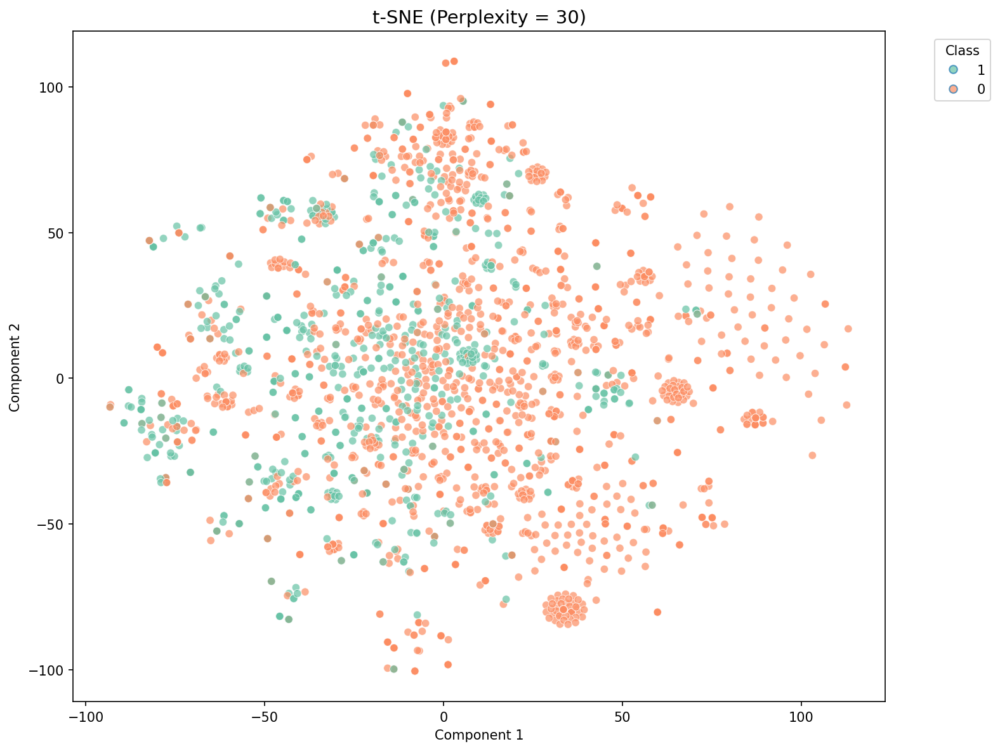

In [ ]:
model.eval()
embeddings = []
labels = []

with torch.no_grad():
    for inputs, targets, _ in train_loader:
        inputs = inputs.to(device)

        embedded = model.embedding(inputs)              # e.g. (B, seq_len, emb_dim)
        emb_mean = embedded.mean(dim=1).cpu().numpy()   # (B, emb_dim)
        embeddings.append(emb_mean)
        labels.extend(targets.cpu().numpy())

# Stack to arrays
embeddings = np.vstack(embeddings)
labels = np.array(labels)

labels = pd.Series(labels).astype(str)
n_classes = labels.nunique()
palette = sns.color_palette("Set2", n_colors=n_classes)

perplexity = 30
tsne = TSNE(n_components=2, perplexity=perplexity, random_state=42, init='pca')
tsne_result = tsne.fit_transform(embeddings)

fig, ax = plt.subplots(figsize=(10, 8), dpi=150)
sns.scatterplot(
    x=tsne_result[:, 0],
    y=tsne_result[:, 1],
    hue=labels,
    palette=palette,
    alpha=0.7,
    ax=ax,
    legend=False
)

ax.set_title(f"t-SNE (Perplexity = {perplexity})", fontsize=14)
ax.set_xlabel("Component 1")
ax.set_ylabel("Component 2")

unique_labels = labels.unique()
handles = []
for i, lab in enumerate(unique_labels):
    handles.append(plt.Line2D([0], [0], marker='o', linestyle='', markersize=6,
                              markerfacecolor=palette[i], alpha=0.7, label=lab))

fig.legend(handles=handles, title="Class", bbox_to_anchor=(0.98, 0.95), loc='upper left')

plt.tight_layout(rect=[0, 0, 0.95, 1])
plt.show()

In [ ]:
learning_rate = 1e-2
num_epochs = 18
patience = 4
min_delta = 1e-4
monitor = "val_loss"

loss_function = nn.BCEWithLogitsLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min' if monitor == "val_loss" else 'max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-7
)

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []
val_f1s = []

best_metric = float('inf') if monitor == "val_loss" else -float('inf')
best_epoch = -1
stalled_epochs = 0
best_state = None

with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, loss_function, device)
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)

        val_loss, val_acc, val_f1 = validate_epoch(model, val_loader, loss_function, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)
        val_f1s.append(val_f1)

        current_metric = val_loss if monitor == "val_loss" else val_f1
        scheduler.step(current_metric)

        # Early stopping logic
        improved = False
        if monitor == "val_loss":
            if current_metric < best_metric - min_delta:
                improved = True
        else:  # monitor == "val_f1"
            if current_metric > best_metric + min_delta:
                improved = True

        if improved:
            best_metric = current_metric
            best_epoch = epoch
            stalled_epochs = 0
            # save best weights (in-memory)
            best_state = {k: v.cpu().clone() for k, v in model.state_dict().items()}
        else:
            stalled_epochs += 1

        end_time = time.time()
        epoch_duration = end_time - start_time
        pbar.set_description(
            f"Epoch {epoch+1}/{num_epochs} - Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, "
            f"Train Acc: {train_acc:.2%}, Val Acc: {val_acc:.2%}, Val F1: {val_f1:.2%}, Time: {epoch_duration / 60:.2f} min"
        )
        pbar.update(1)

        if stalled_epochs >= patience:
            print(f"\nEarly stopping triggered (no improvement in {patience} epochs).")
            break

if best_state is not None:
    model.load_state_dict(best_state)
    print(f"Restored best model from epoch {best_epoch+1} with best {monitor} = {best_metric:.6f}.")
else:
    print("No best state recorded (no improvement during training).")

Epoch 8/18 - Train Loss: 1.7792, Val Loss: 1.7104, Train Acc: 19.87%, Val Acc: 20.00%, Val F1: 15.70%, Time: 0.80 min:  44%|████▍     | 8/18 [06:28<08:05, 48.59s/epoch]


Early stopping triggered (no improvement in 4 epochs).
Restored best model from epoch 4 with best val_loss = 1.708303.


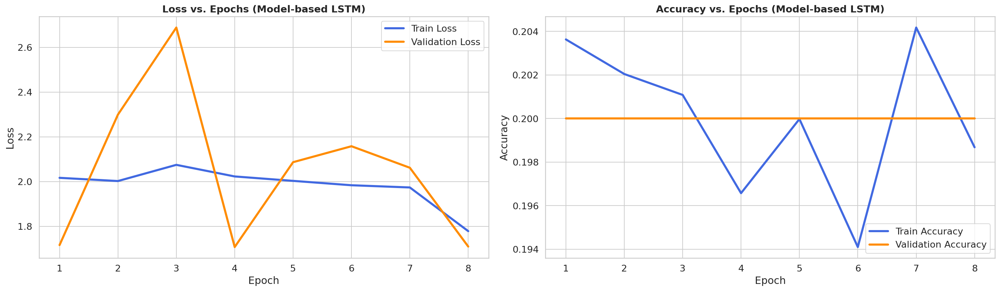

In [ ]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

# High-resolution figure
plt.figure(figsize=(20, 6), dpi=150)

# === 1. Loss Curve ===
plt.subplot(1, 2, 1)
sns.lineplot(x=range(1, len(train_losses) + 1), y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=range(1, len(val_losses) + 1), y=val_losses, label='Validation Loss', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss vs. Epochs (Model-based LSTM)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='upper right')

# === 2. Accuracy Curve ===
plt.subplot(1, 2, 2)
sns.lineplot(x=range(1, len(train_accuracies) + 1), y=train_accuracies, label='Train Accuracy', color='royalblue')
sns.lineplot(x=range(1, len(val_accuracies) + 1), y=val_accuracies, label='Validation Accuracy', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Epochs (Model-based LSTM)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

plt.tight_layout()
plt.show()

### **LSTM + SMOTE**

In [ ]:
model = LSTM_Model(vocab_size=len(word_to_index), embedding_dim=350, hidden_dim=450, num_layers=1, dropout_prob=0.4).to(device)

print(model)
num_params = count_parameters(model)
print()
print(f"Total trainable parameters: {num_params}")

LSTM_Model(
  (embedding): Embedding(20933, 350)
  (lstm): LSTM(350, 200, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.4, inplace=False)
  (fc): Linear(in_features=400, out_features=5, bias=True)
)

Total trainable parameters: 8211755


In [ ]:
from imblearn.over_sampling import SMOTE
from torch.utils.data import DataLoader

BATCH_SIZE = 16

# Convert training tensors to numpy
X_train_np = X_train_tensor.cpu().numpy()
y_train_np = y_train_tensor.cpu().numpy()

# Create a mapping from vector to raw text for later retrieval
original_text_map = {
    tuple(vec): text for vec, text in zip(X_train_np, X_train)
}

# Apply SMOTE to training data
smote = SMOTE(sampling_strategy='auto', random_state=42)
X_resampled_np, y_resampled_np = smote.fit_resample(X_train_np, y_train_np)

# Reconstruct raw texts (if possible), else tag as synthetic
raw_text_resampled = []
for vec in X_resampled_np:
    key = tuple(vec)
    raw_text_resampled.append(
        original_text_map.get(key, "[Synthetic sample - no raw text]")
    )

# Convert back to tensors
X_resampled_tensor = torch.tensor(X_resampled_np, dtype=torch.float)
y_resampled_tensor = torch.tensor(y_resampled_np, dtype=torch.long)

# Create dataset and dataloader
train_dataset_smote = TextDataset(
    X_resampled_tensor, y_resampled_tensor, raw_text_data=raw_text_resampled
)
train_loader_smote = DataLoader(
    train_dataset_smote,
    batch_size=BATCH_SIZE,
    shuffle=True,
    collate_fn=custom_collate_fn  # Preserves original collation behavior
)


/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


In [ ]:
learning_rate = 1e-2
num_epochs = 18
patience = 4
min_delta = 1e-4
monitor = "val_loss"

loss_function = nn.BCEWithLogitsLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min' if monitor == "val_loss" else 'max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-7
)

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []
val_f1s = []

best_metric = float('inf') if monitor == "val_loss" else -float('inf')
best_epoch = -1
stalled_epochs = 0
best_state = None

with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader_smote, optimizer, loss_function, device)
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)

        val_loss, val_acc, val_f1 = validate_epoch(model, val_loader, loss_function, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)
        val_f1s.append(val_f1)

        current_metric = val_loss if monitor == "val_loss" else val_f1
        scheduler.step(current_metric)

        # Early stopping logic
        improved = False
        if monitor == "val_loss":
            if current_metric < best_metric - min_delta:
                improved = True
        else:  # monitor == "val_f1"
            if current_metric > best_metric + min_delta:
                improved = True

        if improved:
            best_metric = current_metric
            best_epoch = epoch
            stalled_epochs = 0
            # save best weights (in-memory)
            best_state = {k: v.cpu().clone() for k, v in model.state_dict().items()}
        else:
            stalled_epochs += 1

        end_time = time.time()
        epoch_duration = end_time - start_time
        pbar.set_description(
            f"Epoch {epoch+1}/{num_epochs} - Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, "
            f"Train Acc: {train_acc:.2%}, Val Acc: {val_acc:.2%}, Val F1: {val_f1:.2%}, Time: {epoch_duration / 60:.2f} min"
        )
        pbar.update(1)

        if stalled_epochs >= patience:
            print(f"\nEarly stopping triggered (no improvement in {patience} epochs).")
            break

if best_state is not None:
    model.load_state_dict(best_state)
    print(f"Restored best model from epoch {best_epoch+1} with best {monitor} = {best_metric:.6f}.")
else:
    print("No best state recorded (no improvement during training).")

Epoch 6/18 - Train Loss: 1.6081, Val Loss: 1.7656, Train Acc: 19.93%, Val Acc: 20.00%, Val F1: 2.00%, Time: 0.38 min:  33%|███▎      | 6/18 [02:16<04:33, 22.79s/epoch]


Early stopping triggered (no improvement in 4 epochs).
Restored best model from epoch 2 with best val_loss = 1.611312.


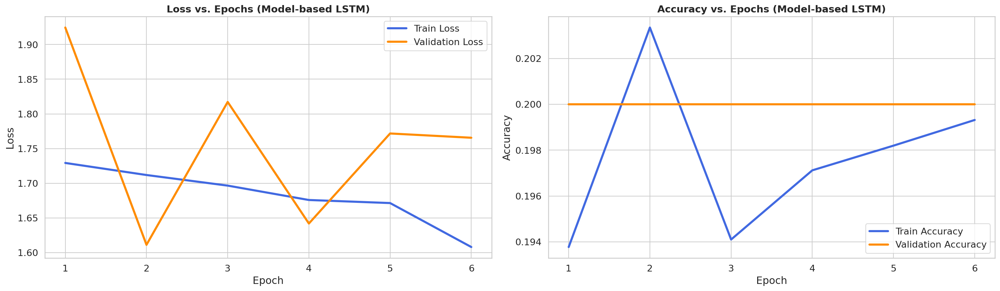

In [ ]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

# High-resolution figure
plt.figure(figsize=(20, 6), dpi=150)

# === 1. Loss Curve ===
plt.subplot(1, 2, 1)
sns.lineplot(x=range(1, len(train_losses) + 1), y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=range(1, len(val_losses) + 1), y=val_losses, label='Validation Loss', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss vs. Epochs (Model-based LSTM)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='upper right')

# === 2. Accuracy Curve ===
plt.subplot(1, 2, 2)
sns.lineplot(x=range(1, len(train_accuracies) + 1), y=train_accuracies, label='Train Accuracy', color='royalblue')
sns.lineplot(x=range(1, len(val_accuracies) + 1), y=val_accuracies, label='Validation Accuracy', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Epochs (Model-based LSTM)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

plt.tight_layout()
plt.show()

### **LSTM + Weight Class**

In [ ]:
class_weights = compute_class_weight('balanced', classes=np.unique(y_train_tensor.cpu().numpy()), y=y_train_tensor.cpu().numpy())
class_weights_tensor = torch.tensor(class_weights, dtype=torch.float).to(device)

batch_size = 16
train_dataset = TextDataset(X_train_tensor, y_train, raw_text_data=X_train)
val_dataset = TextDataset(X_val_tensor, y_val, raw_text_data=X_val)
test_dataset = TextDataset(X_test_tensor, y_test, raw_text_data=X_test)


train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)


In [ ]:
model = LSTM_Model(vocab_size=len(word_to_index), embedding_dim=350, hidden_dim=450, num_layers=1, dropout_prob=0.4).to(device)

print(model)
num_params = count_parameters(model)
print()
print(f"Total trainable parameters: {num_params}")

LSTM_Model(
  (embedding): Embedding(20933, 350)
  (lstm): LSTM(350, 450, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.4, inplace=False)
  (fc): Linear(in_features=900, out_features=5, bias=True)
)

Total trainable parameters: 10218255


In [ ]:
learning_rate = 1e-3
num_epochs = 18
patience = 4
min_delta = 1e-4
monitor = "val_loss"

loss_function = nn.BCEWithLogitsLoss(class_weights_tensor)
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min' if monitor == "val_loss" else 'max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-7
)

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []
val_f1s = []

best_metric = float('inf') if monitor == "val_loss" else -float('inf')
best_epoch = -1
stalled_epochs = 0
best_state = None

with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader_smote, optimizer, loss_function, device)
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)

        val_loss, val_acc, val_f1 = validate_epoch(model, val_loader, loss_function, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)
        val_f1s.append(val_f1)

        current_metric = val_loss if monitor == "val_loss" else val_f1
        scheduler.step(current_metric)

        # Early stopping logic
        improved = False
        if monitor == "val_loss":
            if current_metric < best_metric - min_delta:
                improved = True
        else:  # monitor == "val_f1"
            if current_metric > best_metric + min_delta:
                improved = True

        if improved:
            best_metric = current_metric
            best_epoch = epoch
            stalled_epochs = 0
            # save best weights (in-memory)
            best_state = {k: v.cpu().clone() for k, v in model.state_dict().items()}
        else:
            stalled_epochs += 1

        end_time = time.time()
        epoch_duration = end_time - start_time
        pbar.set_description(
            f"Epoch {epoch+1}/{num_epochs} - Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, "
            f"Train Acc: {train_acc:.2%}, Val Acc: {val_acc:.2%}, Val F1: {val_f1:.2%}, Time: {epoch_duration / 60:.2f} min"
        )
        pbar.update(1)

        if stalled_epochs >= patience:
            print(f"\nEarly stopping triggered (no improvement in {patience} epochs).")
            break

if best_state is not None:
    model.load_state_dict(best_state)
    print(f"Restored best model from epoch {best_epoch+1} with best {monitor} = {best_metric:.6f}.")
else:
    print("No best state recorded (no improvement during training).")

Epoch 10/18 - Train Loss: 1.6097, Val Loss: 1.6092, Train Acc: 20.49%, Val Acc: 20.00%, Val F1: 15.70%, Time: 0.69 min:  56%|█████▌    | 10/18 [07:25<05:56, 44.54s/epoch]


Early stopping triggered (no improvement in 4 epochs).
Restored best model from epoch 6 with best val_loss = 1.608676.


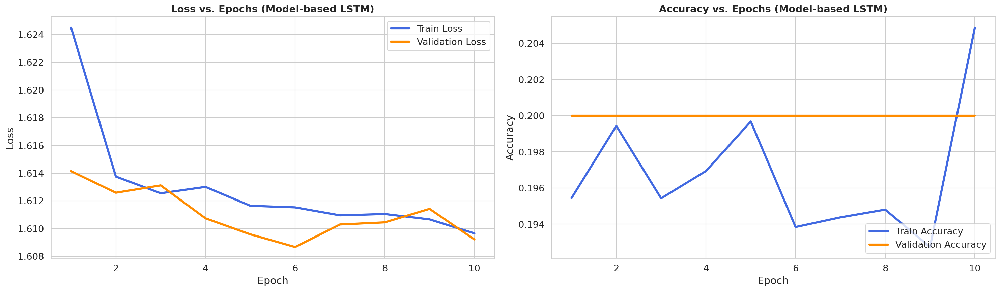

In [ ]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

# High-resolution figure
plt.figure(figsize=(20, 6), dpi=150)

# === 1. Loss Curve ===
plt.subplot(1, 2, 1)
sns.lineplot(x=range(1, len(train_losses) + 1), y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=range(1, len(val_losses) + 1), y=val_losses, label='Validation Loss', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss vs. Epochs (Model-based LSTM)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='upper right')

# === 2. Accuracy Curve ===
plt.subplot(1, 2, 2)
sns.lineplot(x=range(1, len(train_accuracies) + 1), y=train_accuracies, label='Train Accuracy', color='royalblue')
sns.lineplot(x=range(1, len(val_accuracies) + 1), y=val_accuracies, label='Validation Accuracy', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Epochs (Model-based LSTM)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

plt.tight_layout()
plt.show()

# **IV. GRU and LSTM models using word embeddings as input**

In [ ]:
def load_glove_embeddings(glove_path, word_to_index, embedding_dim):
    """
    Loads GloVe embeddings (.txt format) and returns an embedding matrix.

    Args:
        glove_path (str): Path to the GloVe .txt file (e.g., glove.6B.300d.txt).
        word_to_index (dict): Mapping from words to their index in the vocabulary.
        embedding_dim (int): Dimension of the embeddings (e.g., 300).

    Returns:
        torch.Tensor: Embedding matrix of shape (vocab_size, embedding_dim).
    """
    embedding_matrix = np.zeros((len(word_to_index), embedding_dim), dtype='float32')
    with open(glove_path, 'r', encoding="utf-8") as f:
        for line in f:
            values = line.strip().split()
            word = values[0]
            if word in word_to_index:
                vector = np.asarray(values[1:], dtype='float32')
                embedding_matrix[word_to_index[word]] = vector

    return torch.tensor(embedding_matrix, dtype=torch.float)

def load_fasttext_embeddings(vec_path, word_to_index, embedding_dim=300):
    """
    Loads FastText embeddings from a .txt or .vec file and returns an embedding matrix.

    Note:
        The .txt or .vec format contains a header (num_tokens, dimension),
        followed by one word vector per line in the format: word val1 val2 ... valN.

    Args:
        vec_path (str): Path to the FastText .txt or .vec file (e.g., cc.en.300.txt or cc.en.300.vec).
        word_to_index (dict): Mapping from words to their index in the vocabulary.
        embedding_dim (int): Dimensionality of the embeddings (e.g., 300).

    Returns:
        torch.Tensor: Embedding matrix of shape (vocab_size, embedding_dim).
    """
    embedding_matrix = np.zeros((len(word_to_index), embedding_dim), dtype='float32')

    with open(vec_path, 'r', encoding='utf-8', newline='\n', errors='ignore') as f:
        header = f.readline()  # header contains: num_words dim
        for line in f:
            values = line.rstrip().split(' ')
            if len(values) < embedding_dim + 1:
                continue  # skip malformed lines
            word = values[0]
            if word in word_to_index:
                vector = np.asarray(values[1:], dtype='float32')
                embedding_matrix[word_to_index[word]] = vector

    return torch.tensor(embedding_matrix, dtype=torch.float)

## **Validation Phase**

### **GRU + Glove (300d)**

In [ ]:
EMBEDDING_DIM = 300
embedding_matrix_glove = load_glove_embeddings('/content/drive/MyDrive/glove/glove.6B.300d.txt', word_to_index, EMBEDDING_DIM)

In [ ]:
model = GRU_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.3,
    embedding_weights=embedding_matrix_glove,
    freeze_embeddings=False
).to(device)

print(model)
num_params = count_parameters(model)
print()
print(f"Total trainable parameters: {num_params}")

In [ ]:
model.eval()
embeddings = []
labels = []

with torch.no_grad():
    for inputs, targets, _ in train_loader:
        inputs = inputs.to(device)

        embedded = model.embedding(inputs)              # e.g. (B, seq_len, emb_dim)
        emb_mean = embedded.mean(dim=1).cpu().numpy()   # (B, emb_dim)
        embeddings.append(emb_mean)
        labels.extend(targets.cpu().numpy())

# Stack to arrays
embeddings = np.vstack(embeddings)
labels = np.array(labels)

labels = pd.Series(labels).astype(str)
n_classes = labels.nunique()
palette = sns.color_palette("Set2", n_colors=n_classes)

perplexity = 30
tsne = TSNE(n_components=2, perplexity=perplexity, random_state=42, init='pca')
tsne_result = tsne.fit_transform(embeddings)

fig, ax = plt.subplots(figsize=(10, 8), dpi=150)
sns.scatterplot(
    x=tsne_result[:, 0],
    y=tsne_result[:, 1],
    hue=labels,
    palette=palette,
    alpha=0.7,
    ax=ax,
    legend=False
)

ax.set_title(f"t-SNE (Perplexity = {perplexity})", fontsize=14)
ax.set_xlabel("Component 1")
ax.set_ylabel("Component 2")

unique_labels = labels.unique()
handles = []
for i, lab in enumerate(unique_labels):
    handles.append(plt.Line2D([0], [0], marker='o', linestyle='', markersize=6,
                              markerfacecolor=palette[i], alpha=0.7, label=lab))

fig.legend(handles=handles, title="Class", bbox_to_anchor=(0.98, 0.95), loc='upper left')

plt.tight_layout(rect=[0, 0, 0.95, 1])
plt.show()

In [ ]:
learning_rate = 1e-3
num_epochs = 18
patience = 4
min_delta = 1e-4
monitor = "val_loss"

loss_function = nn.BCEWithLogitsLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min' if monitor == "val_loss" else 'max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-7
)

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []
val_f1s = []

best_metric = float('inf') if monitor == "val_loss" else -float('inf')
best_epoch = -1
stalled_epochs = 0
best_state = None

with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, loss_function, device)
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)

        val_loss, val_acc, val_f1 = validate_epoch(model, val_loader, loss_function, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)
        val_f1s.append(val_f1)

        current_metric = val_loss if monitor == "val_loss" else val_f1
        scheduler.step(current_metric)

        # Early stopping logic
        improved = False
        if monitor == "val_loss":
            if current_metric < best_metric - min_delta:
                improved = True
        else:  # monitor == "val_f1"
            if current_metric > best_metric + min_delta:
                improved = True

        if improved:
            best_metric = current_metric
            best_epoch = epoch
            stalled_epochs = 0
            # save best weights (in-memory)
            best_state = {k: v.cpu().clone() for k, v in model.state_dict().items()}
        else:
            stalled_epochs += 1

        end_time = time.time()
        epoch_duration = end_time - start_time
        pbar.set_description(
            f"Epoch {epoch+1}/{num_epochs} - Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, "
            f"Train Acc: {train_acc:.2%}, Val Acc: {val_acc:.2%}, Val F1: {val_f1:.2%}, Time: {epoch_duration / 60:.2f} min"
        )
        pbar.update(1)

        if stalled_epochs >= patience:
            print(f"\nEarly stopping triggered (no improvement in {patience} epochs).")
            break

if best_state is not None:
    model.load_state_dict(best_state)
    print(f"Restored best model from epoch {best_epoch+1} with best {monitor} = {best_metric:.6f}.")
else:
    print("No best state recorded (no improvement during training).")

Epoch 8/18 - Train Loss: 0.3839, Val Loss: 1.4100, Train Acc: 81.98%, Val Acc: 52.10%, Val F1: 52.23%, Time: 0.59 min:  44%|████▍     | 8/18 [04:56<06:10, 37.02s/epoch]


Early stopping triggered (no improvement in 4 epochs).
Restored best model from epoch 4 with best val_loss = 0.857300.


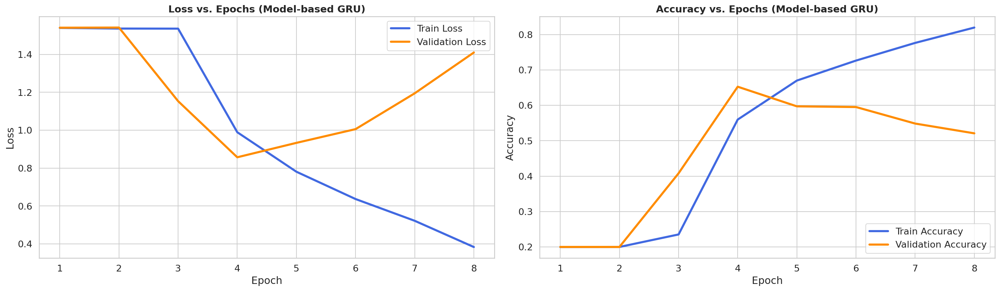

In [ ]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

# High-resolution figure
plt.figure(figsize=(20, 6), dpi=150)

# === 1. Loss Curve ===
plt.subplot(1, 2, 1)
sns.lineplot(x=range(1, len(train_losses) + 1), y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=range(1, len(val_losses) + 1), y=val_losses, label='Validation Loss', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='upper right')

# === 2. Accuracy Curve ===
plt.subplot(1, 2, 2)
sns.lineplot(x=range(1, len(train_accuracies) + 1), y=train_accuracies, label='Train Accuracy', color='royalblue')
sns.lineplot(x=range(1, len(val_accuracies) + 1), y=val_accuracies, label='Validation Accuracy', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

plt.tight_layout()
plt.show()

### **GRU + Glove (300d) + SMOTE**

In [ ]:
model = GRU_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.3,
    embedding_weights=embedding_matrix_glove,
    freeze_embeddings=False
).to(device)

print(model)
num_params = count_parameters(model)
print()
print(f"Total trainable parameters: {num_params}")

GRU_Model(
  (embedding): Embedding(20933, 300)
  (gru): GRU(300, 500, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (fc): Linear(in_features=1000, out_features=5, bias=True)
)

Total trainable parameters: 8690905


In [ ]:
from imblearn.over_sampling import SMOTE
from torch.utils.data import DataLoader

BATCH_SIZE = 16

# Convert training tensors to numpy
X_train_np = X_train_tensor.cpu().numpy()
y_train_np = y_train_tensor.cpu().numpy()

# Create a mapping from vector to raw text for later retrieval
original_text_map = {
    tuple(vec): text for vec, text in zip(X_train_np, X_train)
}

# Apply SMOTE to training data
smote = SMOTE(sampling_strategy='auto', random_state=42)
X_resampled_np, y_resampled_np = smote.fit_resample(X_train_np, y_train_np)

# Reconstruct raw texts (if possible), else tag as synthetic
raw_text_resampled = []
for vec in X_resampled_np:
    key = tuple(vec)
    raw_text_resampled.append(
        original_text_map.get(key, "[Synthetic sample - no raw text]")
    )

# Convert back to tensors
X_resampled_tensor = torch.tensor(X_resampled_np, dtype=torch.float)
y_resampled_tensor = torch.tensor(y_resampled_np, dtype=torch.long)

# Create dataset and dataloader
train_dataset_smote = TextDataset(
    X_resampled_tensor, y_resampled_tensor, raw_text_data=raw_text_resampled
)
train_loader_smote = DataLoader(
    train_dataset_smote,
    batch_size=BATCH_SIZE,
    shuffle=True,
    collate_fn=custom_collate_fn  # Preserves original collation behavior
)

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


In [ ]:
learning_rate = 1e-3
num_epochs = 18
patience = 4
min_delta = 1e-4
monitor = "val_loss"

loss_function = nn.BCEWithLogitsLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min' if monitor == "val_loss" else 'max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-7
)

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []
val_f1s = []

best_metric = float('inf') if monitor == "val_loss" else -float('inf')
best_epoch = -1
stalled_epochs = 0
best_state = None

with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader_smote, optimizer, loss_function, device)
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)

        val_loss, val_acc, val_f1 = validate_epoch(model, val_loader, loss_function, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)
        val_f1s.append(val_f1)

        current_metric = val_loss if monitor == "val_loss" else val_f1
        scheduler.step(current_metric)

        # Early stopping logic
        improved = False
        if monitor == "val_loss":
            if current_metric < best_metric - min_delta:
                improved = True
        else:  # monitor == "val_f1"
            if current_metric > best_metric + min_delta:
                improved = True

        if improved:
            best_metric = current_metric
            best_epoch = epoch
            stalled_epochs = 0
            # save best weights (in-memory)
            best_state = {k: v.cpu().clone() for k, v in model.state_dict().items()}
        else:
            stalled_epochs += 1

        end_time = time.time()
        epoch_duration = end_time - start_time
        pbar.set_description(
            f"Epoch {epoch+1}/{num_epochs} - Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, "
            f"Train Acc: {train_acc:.2%}, Val Acc: {val_acc:.2%}, Val F1: {val_f1:.2%}, Time: {epoch_duration / 60:.2f} min"
        )
        pbar.update(1)

        if stalled_epochs >= patience:
            print(f"\nEarly stopping triggered (no improvement in {patience} epochs).")
            break

if best_state is not None:
    model.load_state_dict(best_state)
    print(f"Restored best model from epoch {best_epoch+1} with best {monitor} = {best_metric:.6f}.")
else:
    print("No best state recorded (no improvement during training).")

Epoch 8/18 - Train Loss: 0.2913, Val Loss: 1.7520, Train Acc: 87.53%, Val Acc: 46.33%, Val F1: 47.47%, Time: 0.96 min:  44%|████▍     | 8/18 [07:39<09:34, 57.40s/epoch]


Early stopping triggered (no improvement in 4 epochs).
Restored best model from epoch 4 with best val_loss = 0.976723.


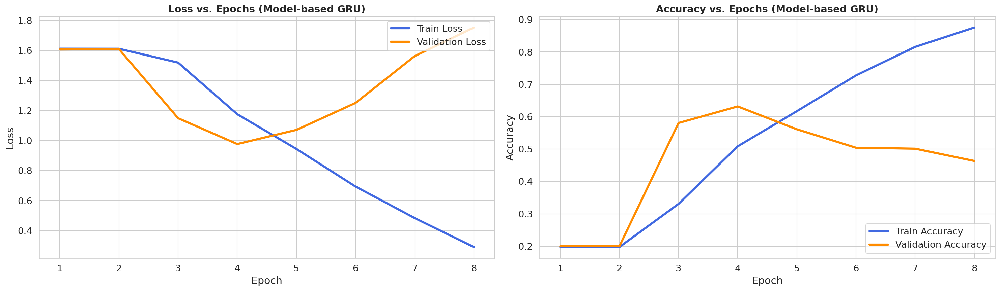

In [ ]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

# High-resolution figure
plt.figure(figsize=(20, 6), dpi=150)

# === 1. Loss Curve ===
plt.subplot(1, 2, 1)
sns.lineplot(x=range(1, len(train_losses) + 1), y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=range(1, len(val_losses) + 1), y=val_losses, label='Validation Loss', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='upper right')

# === 2. Accuracy Curve ===
plt.subplot(1, 2, 2)
sns.lineplot(x=range(1, len(train_accuracies) + 1), y=train_accuracies, label='Train Accuracy', color='royalblue')
sns.lineplot(x=range(1, len(val_accuracies) + 1), y=val_accuracies, label='Validation Accuracy', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

plt.tight_layout()
plt.show()

### **GRU + Glove (300d) + Weight Class**

In [ ]:
class_weights = compute_class_weight('balanced', classes=np.unique(y_train_tensor.cpu().numpy()), y=y_train_tensor.cpu().numpy())
class_weights_tensor = torch.tensor(class_weights, dtype=torch.float).to(device)

batch_size = 16
train_dataset = TextDataset(X_train_tensor, y_train, raw_text_data=X_train)
val_dataset = TextDataset(X_val_tensor, y_val, raw_text_data=X_val)
test_dataset = TextDataset(X_test_tensor, y_test, raw_text_data=X_test)


train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)


In [ ]:
model = GRU_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=450,
    num_layers=1,
    dropout_prob=0.2,
    embedding_weights=embedding_matrix_glove,
    freeze_embeddings=False
).to(device)

print(model)
num_params = count_parameters(model)
print()
print(f"Total trainable parameters: {num_params}")

GRU_Model(
  (embedding): Embedding(20933, 300)
  (gru): GRU(300, 450, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.2, inplace=False)
  (fc): Linear(in_features=900, out_features=5, bias=True)
)

Total trainable parameters: 8314805


In [ ]:
learning_rate = 1e-3
num_epochs = 18
patience = 4
min_delta = 1e-4
monitor = "val_loss"

loss_function = nn.BCEWithLogitsLoss(class_weights_tensor)
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min' if monitor == "val_loss" else 'max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-7
)

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []
val_f1s = []

best_metric = float('inf') if monitor == "val_loss" else -float('inf')
best_epoch = -1
stalled_epochs = 0
best_state = None

with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, loss_function, device)
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)

        val_loss, val_acc, val_f1 = validate_epoch(model, val_loader, loss_function, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)
        val_f1s.append(val_f1)

        current_metric = val_loss if monitor == "val_loss" else val_f1
        scheduler.step(current_metric)

        # Early stopping logic
        improved = False
        if monitor == "val_loss":
            if current_metric < best_metric - min_delta:
                improved = True
        else:  # monitor == "val_f1"
            if current_metric > best_metric + min_delta:
                improved = True

        if improved:
            best_metric = current_metric
            best_epoch = epoch
            stalled_epochs = 0
            # save best weights (in-memory)
            best_state = {k: v.cpu().clone() for k, v in model.state_dict().items()}
        else:
            stalled_epochs += 1

        end_time = time.time()
        epoch_duration = end_time - start_time
        pbar.set_description(
            f"Epoch {epoch+1}/{num_epochs} - Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, "
            f"Train Acc: {train_acc:.2%}, Val Acc: {val_acc:.2%}, Val F1: {val_f1:.2%}, Time: {epoch_duration / 60:.2f} min"
        )
        pbar.update(1)

        if stalled_epochs >= patience:
            print(f"\nEarly stopping triggered (no improvement in {patience} epochs).")
            break

if best_state is not None:
    model.load_state_dict(best_state)
    print(f"Restored best model from epoch {best_epoch+1} with best {monitor} = {best_metric:.6f}.")
else:
    print("No best state recorded (no improvement during training).")

Epoch 6/18 - Train Loss: 1.6231, Val Loss: 1.6293, Train Acc: 19.90%, Val Acc: 21.01%, Val F1: 17.75%, Time: 0.54 min:  33%|███▎      | 6/18 [03:11<06:22, 31.91s/epoch]


Early stopping triggered (no improvement in 4 epochs).
Restored best model from epoch 2 with best val_loss = 1.609988.


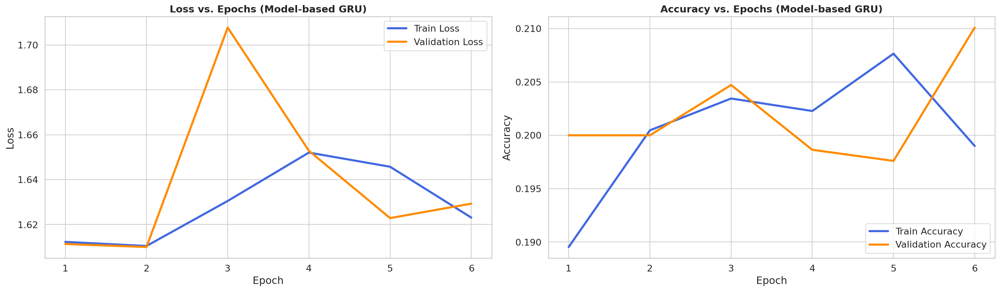

In [ ]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

# High-resolution figure
plt.figure(figsize=(20, 6), dpi=150)

# === 1. Loss Curve ===
plt.subplot(1, 2, 1)
sns.lineplot(x=range(1, len(train_losses) + 1), y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=range(1, len(val_losses) + 1), y=val_losses, label='Validation Loss', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='upper right')

# === 2. Accuracy Curve ===
plt.subplot(1, 2, 2)
sns.lineplot(x=range(1, len(train_accuracies) + 1), y=train_accuracies, label='Train Accuracy', color='royalblue')
sns.lineplot(x=range(1, len(val_accuracies) + 1), y=val_accuracies, label='Validation Accuracy', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

plt.tight_layout()
plt.show()

### **GRU + Fasttext (300d)**

In [ ]:
EMBEDDING_DIM = 300
embedding_matrix_fasttext = load_fasttext_embeddings('/content/drive/MyDrive/cc.en.300.vec/cc.en.300.vec', word_to_index, EMBEDDING_DIM)

In [ ]:
model = GRU_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=450,
    num_layers=1,
    dropout_prob=0.4,
    embedding_weights=embedding_matrix_fasttext,
    freeze_embeddings=False
).to(device)

print(model)
num_params = count_parameters(model)
print()
print(f"Total trainable parameters: {num_params}")

GRU_Model(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 450, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.4, inplace=False)
  (fc): Linear(in_features=900, out_features=1, bias=True)
)

Total trainable parameters: 14291401


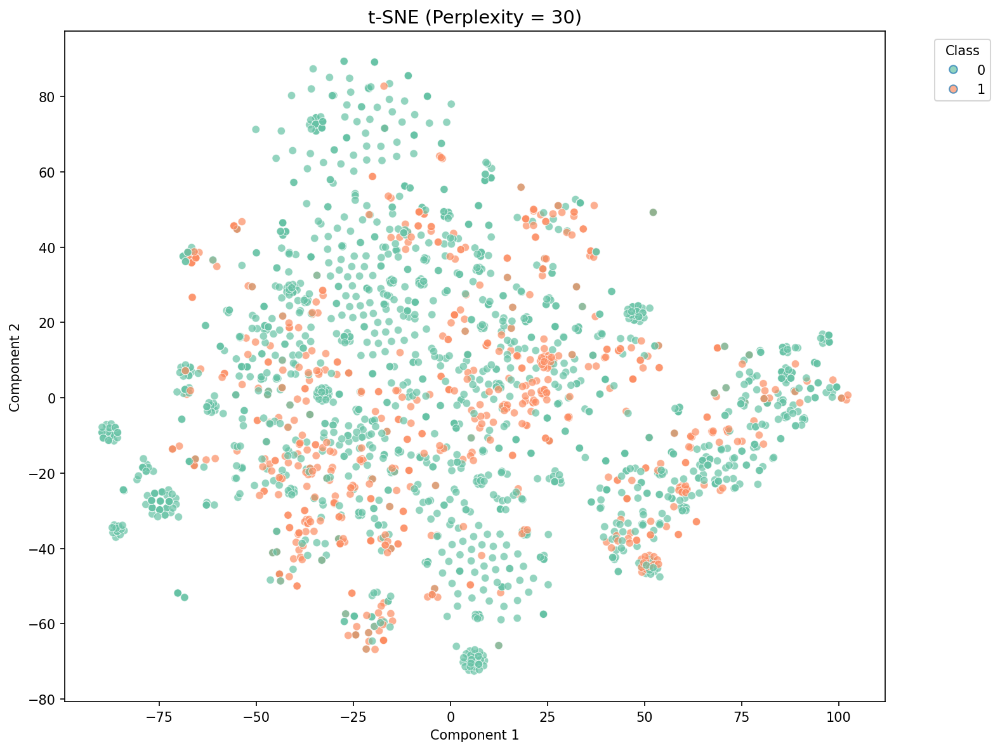

In [ ]:
model.eval()
embeddings = []
labels = []

with torch.no_grad():
    for inputs, targets, _ in train_loader:
        inputs = inputs.to(device)

        embedded = model.embedding(inputs)              # e.g. (B, seq_len, emb_dim)
        emb_mean = embedded.mean(dim=1).cpu().numpy()   # (B, emb_dim)
        embeddings.append(emb_mean)
        labels.extend(targets.cpu().numpy())

# Stack to arrays
embeddings = np.vstack(embeddings)
labels = np.array(labels)

labels = pd.Series(labels).astype(str)
n_classes = labels.nunique()
palette = sns.color_palette("Set2", n_colors=n_classes)

perplexity = 30
tsne = TSNE(n_components=2, perplexity=perplexity, random_state=42, init='pca')
tsne_result = tsne.fit_transform(embeddings)

fig, ax = plt.subplots(figsize=(10, 8), dpi=150)
sns.scatterplot(
    x=tsne_result[:, 0],
    y=tsne_result[:, 1],
    hue=labels,
    palette=palette,
    alpha=0.7,
    ax=ax,
    legend=False
)

ax.set_title(f"t-SNE (Perplexity = {perplexity})", fontsize=14)
ax.set_xlabel("Component 1")
ax.set_ylabel("Component 2")

unique_labels = labels.unique()
handles = []
for i, lab in enumerate(unique_labels):
    handles.append(plt.Line2D([0], [0], marker='o', linestyle='', markersize=6,
                              markerfacecolor=palette[i], alpha=0.7, label=lab))

fig.legend(handles=handles, title="Class", bbox_to_anchor=(0.98, 0.95), loc='upper left')

plt.tight_layout(rect=[0, 0, 0.95, 1])
plt.show()

In [ ]:
learning_rate = 1e-3
num_epochs = 18
patience = 4
min_delta = 1e-4
monitor = "val_loss"

loss_function = nn.BCEWithLogitsLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min' if monitor == "val_loss" else 'max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-7
)

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []
val_f1s = []

best_metric = float('inf') if monitor == "val_loss" else -float('inf')
best_epoch = -1
stalled_epochs = 0
best_state = None

with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, loss_function, device)
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)

        val_loss, val_acc, val_f1 = validate_epoch(model, val_loader, loss_function, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)
        val_f1s.append(val_f1)

        current_metric = val_loss if monitor == "val_loss" else val_f1
        scheduler.step(current_metric)

        # Early stopping logic
        improved = False
        if monitor == "val_loss":
            if current_metric < best_metric - min_delta:
                improved = True
        else:  # monitor == "val_f1"
            if current_metric > best_metric + min_delta:
                improved = True

        if improved:
            best_metric = current_metric
            best_epoch = epoch
            stalled_epochs = 0
            # save best weights (in-memory)
            best_state = {k: v.cpu().clone() for k, v in model.state_dict().items()}
        else:
            stalled_epochs += 1

        end_time = time.time()
        epoch_duration = end_time - start_time
        pbar.set_description(
            f"Epoch {epoch+1}/{num_epochs} - Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, "
            f"Train Acc: {train_acc:.2%}, Val Acc: {val_acc:.2%}, Val F1: {val_f1:.2%}, Time: {epoch_duration / 60:.2f} min"
        )
        pbar.update(1)

        if stalled_epochs >= patience:
            print(f"\nEarly stopping triggered (no improvement in {patience} epochs).")
            break

if best_state is not None:
    model.load_state_dict(best_state)
    print(f"Restored best model from epoch {best_epoch+1} with best {monitor} = {best_metric:.6f}.")
else:
    print("No best state recorded (no improvement during training).")

Epoch 10/18 - Train Loss: 0.3282, Val Loss: 1.6963, Train Acc: 83.66%, Val Acc: 49.94%, Val F1: 50.58%, Time: 0.54 min:  56%|█████▌    | 10/18 [05:19<04:15, 31.99s/epoch]


Early stopping triggered (no improvement in 4 epochs).
Restored best model from epoch 6 with best val_loss = 0.962307.


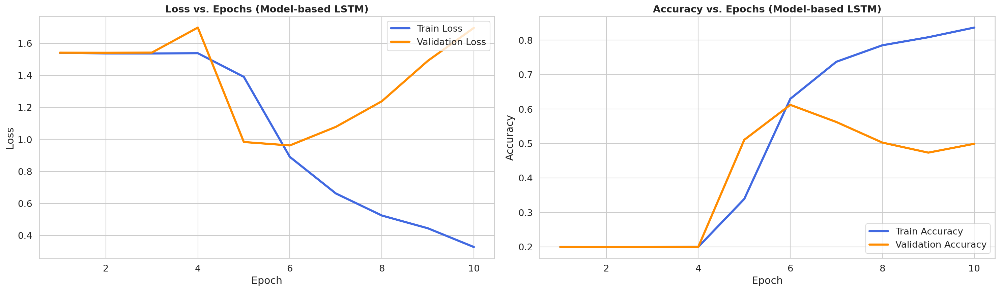

In [ ]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

# High-resolution figure
plt.figure(figsize=(20, 6), dpi=150)

# === 1. Loss Curve ===
plt.subplot(1, 2, 1)
sns.lineplot(x=range(1, len(train_losses) + 1), y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=range(1, len(val_losses) + 1), y=val_losses, label='Validation Loss', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='upper right')

# === 2. Accuracy Curve ===
plt.subplot(1, 2, 2)
sns.lineplot(x=range(1, len(train_accuracies) + 1), y=train_accuracies, label='Train Accuracy', color='royalblue')
sns.lineplot(x=range(1, len(val_accuracies) + 1), y=val_accuracies, label='Validation Accuracy', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

plt.tight_layout()
plt.show()

### **GRU + Fasttext (300d) +  SMOTE**

In [ ]:
model = GRU_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=450,
    num_layers=1,
    dropout_prob=0.2,
    embedding_weights=embedding_matrix_fasttext,
    freeze_embeddings=False
).to(device)

print(model)
num_params = count_parameters(model)
print()
print(f"Total trainable parameters: {num_params}")

GRU_Model(
  (embedding): Embedding(20933, 300)
  (gru): GRU(300, 450, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.2, inplace=False)
  (fc): Linear(in_features=900, out_features=5, bias=True)
)

Total trainable parameters: 8314805


In [ ]:
from imblearn.over_sampling import SMOTE
from torch.utils.data import DataLoader

BATCH_SIZE = 16

# Convert training tensors to numpy
X_train_np = X_train_tensor.cpu().numpy()
y_train_np = y_train_tensor.cpu().numpy()

# Create a mapping from vector to raw text for later retrieval
original_text_map = {
    tuple(vec): text for vec, text in zip(X_train_np, X_train)
}

# Apply SMOTE to training data
smote = SMOTE(sampling_strategy='auto', random_state=42)
X_resampled_np, y_resampled_np = smote.fit_resample(X_train_np, y_train_np)

# Reconstruct raw texts (if possible), else tag as synthetic
raw_text_resampled = []
for vec in X_resampled_np:
    key = tuple(vec)
    raw_text_resampled.append(
        original_text_map.get(key, "[Synthetic sample - no raw text]")
    )

# Convert back to tensors
X_resampled_tensor = torch.tensor(X_resampled_np, dtype=torch.float)
y_resampled_tensor = torch.tensor(y_resampled_np, dtype=torch.long)

# Create dataset and dataloader
train_dataset_smote = TextDataset(
    X_resampled_tensor, y_resampled_tensor, raw_text_data=raw_text_resampled
)
train_loader_smote = DataLoader(
    train_dataset_smote,
    batch_size=BATCH_SIZE,
    shuffle=True,
    collate_fn=custom_collate_fn  # Preserves original collation behavior
)

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


In [ ]:
learning_rate = 1e-3
num_epochs = 18
patience = 4
min_delta = 1e-4
monitor = "val_loss"

loss_function = nn.BCEWithLogitsLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min' if monitor == "val_loss" else 'max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-7
)

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []
val_f1s = []

best_metric = float('inf') if monitor == "val_loss" else -float('inf')
best_epoch = -1
stalled_epochs = 0
best_state = None

with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader_smote, optimizer, loss_function, device)
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)

        val_loss, val_acc, val_f1 = validate_epoch(model, val_loader, loss_function, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)
        val_f1s.append(val_f1)

        current_metric = val_loss if monitor == "val_loss" else val_f1
        scheduler.step(current_metric)

        # Early stopping logic
        improved = False
        if monitor == "val_loss":
            if current_metric < best_metric - min_delta:
                improved = True
        else:  # monitor == "val_f1"
            if current_metric > best_metric + min_delta:
                improved = True

        if improved:
            best_metric = current_metric
            best_epoch = epoch
            stalled_epochs = 0
            # save best weights (in-memory)
            best_state = {k: v.cpu().clone() for k, v in model.state_dict().items()}
        else:
            stalled_epochs += 1

        end_time = time.time()
        epoch_duration = end_time - start_time
        pbar.set_description(
            f"Epoch {epoch+1}/{num_epochs} - Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, "
            f"Train Acc: {train_acc:.2%}, Val Acc: {val_acc:.2%}, Val F1: {val_f1:.2%}, Time: {epoch_duration / 60:.2f} min"
        )
        pbar.update(1)

        if stalled_epochs >= patience:
            print(f"\nEarly stopping triggered (no improvement in {patience} epochs).")
            break

if best_state is not None:
    model.load_state_dict(best_state)
    print(f"Restored best model from epoch {best_epoch+1} with best {monitor} = {best_metric:.6f}.")
else:
    print("No best state recorded (no improvement during training).")

Epoch 11/18 - Train Loss: 0.2286, Val Loss: 2.1594, Train Acc: 89.20%, Val Acc: 45.11%, Val F1: 45.34%, Time: 0.87 min:  61%|██████    | 11/18 [09:58<06:21, 54.44s/epoch]


Early stopping triggered (no improvement in 4 epochs).
Restored best model from epoch 7 with best val_loss = 1.147106.


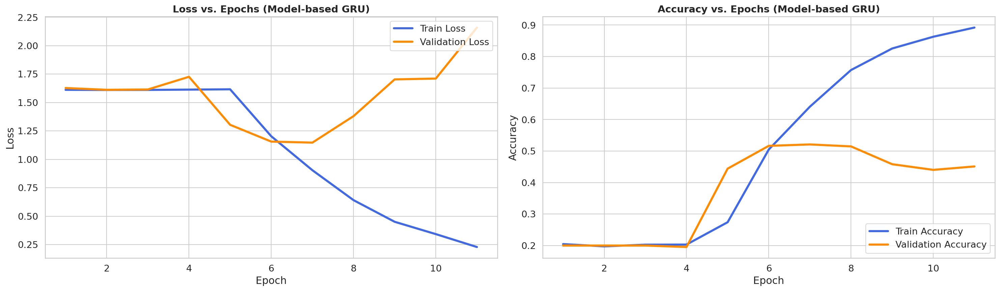

In [ ]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

# High-resolution figure
plt.figure(figsize=(20, 6), dpi=150)

# === 1. Loss Curve ===
plt.subplot(1, 2, 1)
sns.lineplot(x=range(1, len(train_losses) + 1), y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=range(1, len(val_losses) + 1), y=val_losses, label='Validation Loss', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='upper right')

# === 2. Accuracy Curve ===
plt.subplot(1, 2, 2)
sns.lineplot(x=range(1, len(train_accuracies) + 1), y=train_accuracies, label='Train Accuracy', color='royalblue')
sns.lineplot(x=range(1, len(val_accuracies) + 1), y=val_accuracies, label='Validation Accuracy', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

plt.tight_layout()
plt.show()

### **GRU + Fasttext (300d) + Weight Class**

In [ ]:
class_weights = compute_class_weight('balanced', classes=np.unique(y_train_tensor.cpu().numpy()), y=y_train_tensor.cpu().numpy())
class_weights_tensor = torch.tensor(class_weights, dtype=torch.float).to(device)

batch_size = 16
train_dataset = TextDataset(X_train_tensor, y_train, raw_text_data=X_train)
val_dataset = TextDataset(X_val_tensor, y_val, raw_text_data=X_val)
test_dataset = TextDataset(X_test_tensor, y_test, raw_text_data=X_test)


train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)


In [ ]:
model = GRU_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=450,
    num_layers=1,
    dropout_prob=0.5,
    embedding_weights=embedding_matrix_fasttext,
    freeze_embeddings=False
).to(device)

print(model)
num_params = count_parameters(model)
print()
print(f"Total trainable parameters: {num_params}")

GRU_Model(
  (embedding): Embedding(20933, 300)
  (gru): GRU(300, 450, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.5, inplace=False)
  (fc): Linear(in_features=900, out_features=5, bias=True)
)

Total trainable parameters: 8314805


In [ ]:
learning_rate = 1e-3
num_epochs = 18
patience = 4
min_delta = 1e-4
monitor = "val_loss"

loss_function = nn.BCEWithLogitsLoss(class_weights_tensor)
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min' if monitor == "val_loss" else 'max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-7
)

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []
val_f1s = []

best_metric = float('inf') if monitor == "val_loss" else -float('inf')
best_epoch = -1
stalled_epochs = 0
best_state = None

with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader_smote, optimizer, loss_function, device)
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)

        val_loss, val_acc, val_f1 = validate_epoch(model, val_loader, loss_function, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)
        val_f1s.append(val_f1)

        current_metric = val_loss if monitor == "val_loss" else val_f1
        scheduler.step(current_metric)

        # Early stopping logic
        improved = False
        if monitor == "val_loss":
            if current_metric < best_metric - min_delta:
                improved = True
        else:  # monitor == "val_f1"
            if current_metric > best_metric + min_delta:
                improved = True

        if improved:
            best_metric = current_metric
            best_epoch = epoch
            stalled_epochs = 0
            # save best weights (in-memory)
            best_state = {k: v.cpu().clone() for k, v in model.state_dict().items()}
        else:
            stalled_epochs += 1

        end_time = time.time()
        epoch_duration = end_time - start_time
        pbar.set_description(
            f"Epoch {epoch+1}/{num_epochs} - Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, "
            f"Train Acc: {train_acc:.2%}, Val Acc: {val_acc:.2%}, Val F1: {val_f1:.2%}, Time: {epoch_duration / 60:.2f} min"
        )
        pbar.update(1)

        if stalled_epochs >= patience:
            print(f"\nEarly stopping triggered (no improvement in {patience} epochs).")
            break

if best_state is not None:
    model.load_state_dict(best_state)
    print(f"Restored best model from epoch {best_epoch+1} with best {monitor} = {best_metric:.6f}.")
else:
    print("No best state recorded (no improvement during training).")

Epoch 5/18 - Train Loss: 1.5450, Val Loss: 1.6991, Train Acc: 20.10%, Val Acc: 20.00%, Val F1: 2.00%, Time: 0.86 min:  28%|██▊       | 5/18 [04:20<11:17, 52.11s/epoch]


Early stopping triggered (no improvement in 4 epochs).
Restored best model from epoch 1 with best val_loss = 1.646745.


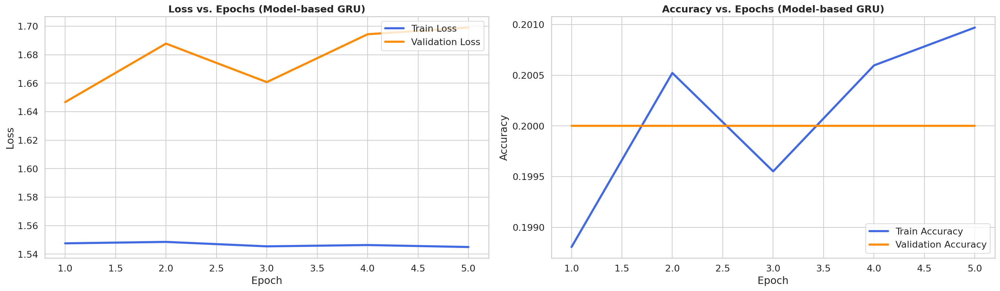

In [ ]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

# High-resolution figure
plt.figure(figsize=(20, 6), dpi=150)

# === 1. Loss Curve ===
plt.subplot(1, 2, 1)
sns.lineplot(x=range(1, len(train_losses) + 1), y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=range(1, len(val_losses) + 1), y=val_losses, label='Validation Loss', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='upper right')

# === 2. Accuracy Curve ===
plt.subplot(1, 2, 2)
sns.lineplot(x=range(1, len(train_accuracies) + 1), y=train_accuracies, label='Train Accuracy', color='royalblue')
sns.lineplot(x=range(1, len(val_accuracies) + 1), y=val_accuracies, label='Validation Accuracy', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

plt.tight_layout()
plt.show()

### **LSTM + Glove (300d)**

In [ ]:
EMBEDDING_DIM = 300
embedding_matrix_glove = load_glove_embeddings('/content/drive/MyDrive/glove/glove.6B.300d.txt', word_to_index, EMBEDDING_DIM)

In [ ]:
model = LSTM_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=356,
    num_layers=1,
    dropout_prob=0.5,
    embedding_weights=embedding_matrix_glove,
    freeze_embeddings=False
).to(device)

print(model)
num_params = count_parameters(model)
print()
print(f"Total trainable parameters: {num_params}")

LSTM_Model(
  (embedding): Embedding(40867, 300)
  (lstm): LSTM(300, 356, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.5, inplace=False)
  (fc): Linear(in_features=712, out_features=1, bias=True)
)

Total trainable parameters: 14134797


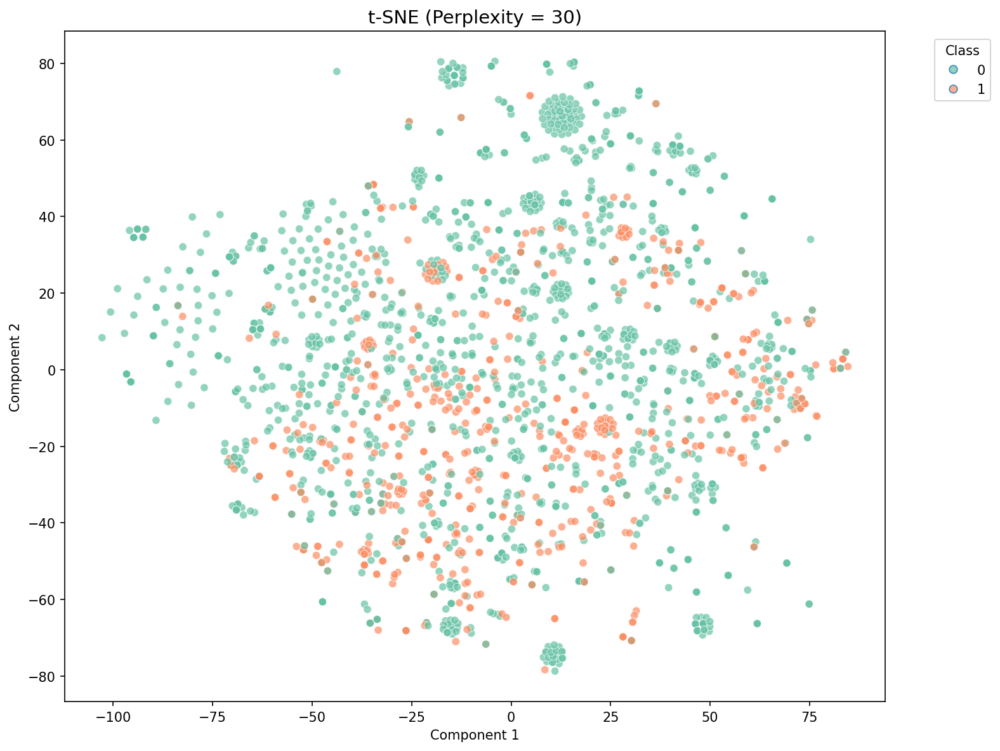

In [ ]:
model.eval()
embeddings = []
labels = []

with torch.no_grad():
    for inputs, targets, _ in train_loader:
        inputs = inputs.to(device)

        embedded = model.embedding(inputs)              # e.g. (B, seq_len, emb_dim)
        emb_mean = embedded.mean(dim=1).cpu().numpy()   # (B, emb_dim)
        embeddings.append(emb_mean)
        labels.extend(targets.cpu().numpy())

# Stack to arrays
embeddings = np.vstack(embeddings)
labels = np.array(labels)

labels = pd.Series(labels).astype(str)
n_classes = labels.nunique()
palette = sns.color_palette("Set2", n_colors=n_classes)

perplexity = 30
tsne = TSNE(n_components=2, perplexity=perplexity, random_state=42, init='pca')
tsne_result = tsne.fit_transform(embeddings)

fig, ax = plt.subplots(figsize=(10, 8), dpi=150)
sns.scatterplot(
    x=tsne_result[:, 0],
    y=tsne_result[:, 1],
    hue=labels,
    palette=palette,
    alpha=0.7,
    ax=ax,
    legend=False
)

ax.set_title(f"t-SNE (Perplexity = {perplexity})", fontsize=14)
ax.set_xlabel("Component 1")
ax.set_ylabel("Component 2")

unique_labels = labels.unique()
handles = []
for i, lab in enumerate(unique_labels):
    handles.append(plt.Line2D([0], [0], marker='o', linestyle='', markersize=6,
                              markerfacecolor=palette[i], alpha=0.7, label=lab))

fig.legend(handles=handles, title="Class", bbox_to_anchor=(0.98, 0.95), loc='upper left')

plt.tight_layout(rect=[0, 0, 0.95, 1])
plt.show()

In [ ]:
learning_rate = 1e-3
num_epochs = 18
patience = 4
min_delta = 1e-4
monitor = "val_loss"

loss_function = nn.BCEWithLogitsLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min' if monitor == "val_loss" else 'max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-7
)

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []
val_f1s = []

best_metric = float('inf') if monitor == "val_loss" else -float('inf')
best_epoch = -1
stalled_epochs = 0
best_state = None

with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, loss_function, device)
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)

        val_loss, val_acc, val_f1 = validate_epoch(model, val_loader, loss_function, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)
        val_f1s.append(val_f1)

        current_metric = val_loss if monitor == "val_loss" else val_f1
        scheduler.step(current_metric)

        # Early stopping logic
        improved = False
        if monitor == "val_loss":
            if current_metric < best_metric - min_delta:
                improved = True
        else:  # monitor == "val_f1"
            if current_metric > best_metric + min_delta:
                improved = True

        if improved:
            best_metric = current_metric
            best_epoch = epoch
            stalled_epochs = 0
            # save best weights (in-memory)
            best_state = {k: v.cpu().clone() for k, v in model.state_dict().items()}
        else:
            stalled_epochs += 1

        end_time = time.time()
        epoch_duration = end_time - start_time
        pbar.set_description(
            f"Epoch {epoch+1}/{num_epochs} - Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, "
            f"Train Acc: {train_acc:.2%}, Val Acc: {val_acc:.2%}, Val F1: {val_f1:.2%}, Time: {epoch_duration / 60:.2f} min"
        )
        pbar.update(1)

        if stalled_epochs >= patience:
            print(f"\nEarly stopping triggered (no improvement in {patience} epochs).")
            break

if best_state is not None:
    model.load_state_dict(best_state)
    print(f"Restored best model from epoch {best_epoch+1} with best {monitor} = {best_metric:.6f}.")
else:
    print("No best state recorded (no improvement during training).")

Epoch 7/18 - Train Loss: 1.5343, Val Loss: 1.5404, Train Acc: 20.00%, Val Acc: 20.00%, Val F1: 15.70%, Time: 0.46 min:  39%|███▉      | 7/18 [03:08<04:55, 26.87s/epoch]


Early stopping triggered (no improvement in 4 epochs).
Restored best model from epoch 3 with best val_loss = 1.539886.


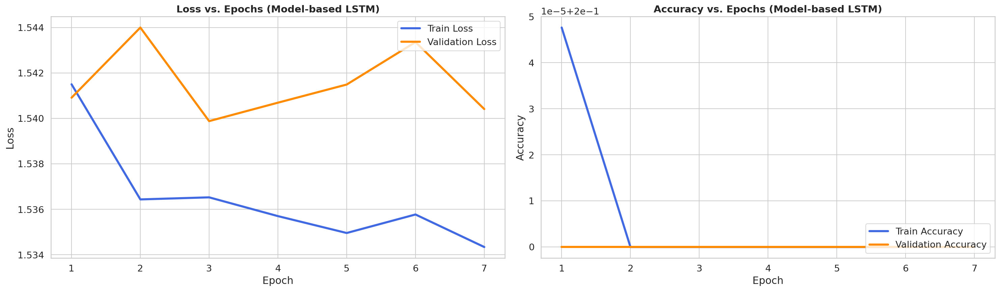

In [ ]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

# High-resolution figure
plt.figure(figsize=(20, 6), dpi=150)

# === 1. Loss Curve ===
plt.subplot(1, 2, 1)
sns.lineplot(x=range(1, len(train_losses) + 1), y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=range(1, len(val_losses) + 1), y=val_losses, label='Validation Loss', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss vs. Epochs (Model-based LSTM)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='upper right')

# === 2. Accuracy Curve ===
plt.subplot(1, 2, 2)
sns.lineplot(x=range(1, len(train_accuracies) + 1), y=train_accuracies, label='Train Accuracy', color='royalblue')
sns.lineplot(x=range(1, len(val_accuracies) + 1), y=val_accuracies, label='Validation Accuracy', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Epochs (Model-based LSTM)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

plt.tight_layout()
plt.show()

### **LSTM + Glove (300d) + SMOTE**

In [ ]:
model = LSTM_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=450,
    num_layers=1,
    dropout_prob=0.5,
    embedding_weights=embedding_matrix_glove,
    freeze_embeddings=False
).to(device)

print(model)
num_params = count_parameters(model)
print()
print(f"Total trainable parameters: {num_params}")

LSTM_Model(
  (embedding): Embedding(20933, 300)
  (lstm): LSTM(300, 450, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.5, inplace=False)
  (fc): Linear(in_features=900, out_features=5, bias=True)
)

Total trainable parameters: 8991605


In [ ]:
from imblearn.over_sampling import SMOTE
from torch.utils.data import DataLoader

BATCH_SIZE = 16

# Convert training tensors to numpy
X_train_np = X_train_tensor.cpu().numpy()
y_train_np = y_train_tensor.cpu().numpy()

# Create a mapping from vector to raw text for later retrieval
original_text_map = {
    tuple(vec): text for vec, text in zip(X_train_np, X_train)
}

# Apply SMOTE to training data
smote = SMOTE(sampling_strategy='auto', random_state=42)
X_resampled_np, y_resampled_np = smote.fit_resample(X_train_np, y_train_np)

# Reconstruct raw texts (if possible), else tag as synthetic
raw_text_resampled = []
for vec in X_resampled_np:
    key = tuple(vec)
    raw_text_resampled.append(
        original_text_map.get(key, "[Synthetic sample - no raw text]")
    )

# Convert back to tensors
X_resampled_tensor = torch.tensor(X_resampled_np, dtype=torch.float)
y_resampled_tensor = torch.tensor(y_resampled_np, dtype=torch.long)

# Create dataset and dataloader
train_dataset_smote = TextDataset(
    X_resampled_tensor, y_resampled_tensor, raw_text_data=raw_text_resampled
)
train_loader_smote = DataLoader(
    train_dataset_smote,
    batch_size=BATCH_SIZE,
    shuffle=True,
    collate_fn=custom_collate_fn  # Preserves original collation behavior
)

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


In [ ]:
learning_rate = 1e-2
num_epochs = 18
patience = 4
min_delta = 1e-4
monitor = "val_loss"

loss_function = nn.BCEWithLogitsLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min' if monitor == "val_loss" else 'max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-7
)

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []
val_f1s = []

best_metric = float('inf') if monitor == "val_loss" else -float('inf')
best_epoch = -1
stalled_epochs = 0
best_state = None

with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader_smote, optimizer, loss_function, device)
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)

        val_loss, val_acc, val_f1 = validate_epoch(model, val_loader, loss_function, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)
        val_f1s.append(val_f1)

        current_metric = val_loss if monitor == "val_loss" else val_f1
        scheduler.step(current_metric)

        # Early stopping logic
        improved = False
        if monitor == "val_loss":
            if current_metric < best_metric - min_delta:
                improved = True
        else:  # monitor == "val_f1"
            if current_metric > best_metric + min_delta:
                improved = True

        if improved:
            best_metric = current_metric
            best_epoch = epoch
            stalled_epochs = 0
            # save best weights (in-memory)
            best_state = {k: v.cpu().clone() for k, v in model.state_dict().items()}
        else:
            stalled_epochs += 1

        end_time = time.time()
        epoch_duration = end_time - start_time
        pbar.set_description(
            f"Epoch {epoch+1}/{num_epochs} - Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, "
            f"Train Acc: {train_acc:.2%}, Val Acc: {val_acc:.2%}, Val F1: {val_f1:.2%}, Time: {epoch_duration / 60:.2f} min"
        )
        pbar.update(1)

        if stalled_epochs >= patience:
            print(f"\nEarly stopping triggered (no improvement in {patience} epochs).")
            break

if best_state is not None:
    model.load_state_dict(best_state)
    print(f"Restored best model from epoch {best_epoch+1} with best {monitor} = {best_metric:.6f}.")
else:
    print("No best state recorded (no improvement during training).")

Epoch 10/18 - Train Loss: 1.6141, Val Loss: 1.6145, Train Acc: 20.43%, Val Acc: 20.00%, Val F1: 3.40%, Time: 1.09 min:  56%|█████▌    | 10/18 [10:53<08:43, 65.40s/epoch]


Early stopping triggered (no improvement in 4 epochs).
Restored best model from epoch 6 with best val_loss = 1.596042.


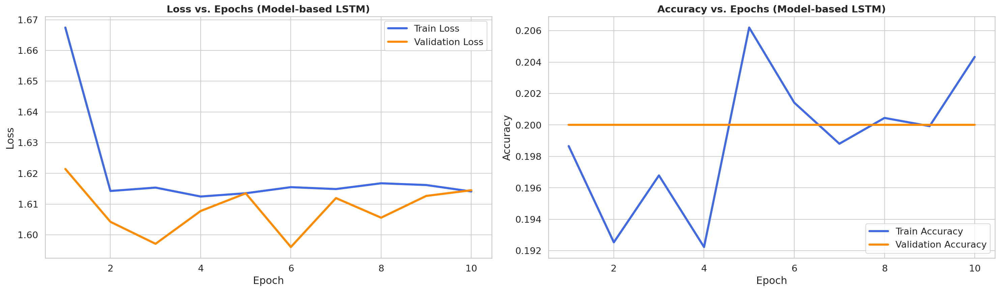

In [ ]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

# High-resolution figure
plt.figure(figsize=(20, 6), dpi=150)

# === 1. Loss Curve ===
plt.subplot(1, 2, 1)
sns.lineplot(x=range(1, len(train_losses) + 1), y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=range(1, len(val_losses) + 1), y=val_losses, label='Validation Loss', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss vs. Epochs (Model-based LSTM)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='upper right')

# === 2. Accuracy Curve ===
plt.subplot(1, 2, 2)
sns.lineplot(x=range(1, len(train_accuracies) + 1), y=train_accuracies, label='Train Accuracy', color='royalblue')
sns.lineplot(x=range(1, len(val_accuracies) + 1), y=val_accuracies, label='Validation Accuracy', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Epochs (Model-based LSTM)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

plt.tight_layout()
plt.show()

### **LSTM + Glove (300d) + Weight Class**

In [ ]:
class_weights = compute_class_weight('balanced', classes=np.unique(y_train_tensor.cpu().numpy()), y=y_train_tensor.cpu().numpy())
class_weights_tensor = torch.tensor(class_weights, dtype=torch.float).to(device)

batch_size = 16
train_dataset = TextDataset(X_train_tensor, y_train, raw_text_data=X_train)
val_dataset = TextDataset(X_val_tensor, y_val, raw_text_data=X_val)
test_dataset = TextDataset(X_test_tensor, y_test, raw_text_data=X_test)


train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)


In [ ]:
model = LSTM_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=450,
    num_layers=1,
    dropout_prob=0.5,
    embedding_weights=embedding_matrix_glove,
    freeze_embeddings=False
).to(device)

print(model)
num_params = count_parameters(model)
print()
print(f"Total trainable parameters: {num_params}")

LSTM_Model(
  (embedding): Embedding(20933, 300)
  (lstm): LSTM(300, 450, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.5, inplace=False)
  (fc): Linear(in_features=900, out_features=5, bias=True)
)

Total trainable parameters: 8991605


In [ ]:
learning_rate = 1e-3
num_epochs = 18
patience = 4
min_delta = 1e-4
monitor = "val_loss"

loss_function = nn.BCEWithLogitsLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min' if monitor == "val_loss" else 'max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-7
)

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []
val_f1s = []

best_metric = float('inf') if monitor == "val_loss" else -float('inf')
best_epoch = -1
stalled_epochs = 0
best_state = None

with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, loss_function, device)
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)

        val_loss, val_acc, val_f1 = validate_epoch(model, val_loader, loss_function, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)
        val_f1s.append(val_f1)

        current_metric = val_loss if monitor == "val_loss" else val_f1
        scheduler.step(current_metric)

        # Early stopping logic
        improved = False
        if monitor == "val_loss":
            if current_metric < best_metric - min_delta:
                improved = True
        else:  # monitor == "val_f1"
            if current_metric > best_metric + min_delta:
                improved = True

        if improved:
            best_metric = current_metric
            best_epoch = epoch
            stalled_epochs = 0
            # save best weights (in-memory)
            best_state = {k: v.cpu().clone() for k, v in model.state_dict().items()}
        else:
            stalled_epochs += 1

        end_time = time.time()
        epoch_duration = end_time - start_time
        pbar.set_description(
            f"Epoch {epoch+1}/{num_epochs} - Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, "
            f"Train Acc: {train_acc:.2%}, Val Acc: {val_acc:.2%}, Val F1: {val_f1:.2%}, Time: {epoch_duration / 60:.2f} min"
        )
        pbar.update(1)

        if stalled_epochs >= patience:
            print(f"\nEarly stopping triggered (no improvement in {patience} epochs).")
            break

if best_state is not None:
    model.load_state_dict(best_state)
    print(f"Restored best model from epoch {best_epoch+1} with best {monitor} = {best_metric:.6f}.")
else:
    print("No best state recorded (no improvement during training).")

Epoch 5/18 - Train Loss: 1.5340, Val Loss: 1.5414, Train Acc: 20.00%, Val Acc: 20.00%, Val F1: 15.70%, Time: 0.67 min:  28%|██▊       | 5/18 [03:20<08:41, 40.11s/epoch]


Early stopping triggered (no improvement in 4 epochs).
Restored best model from epoch 1 with best val_loss = 1.541174.


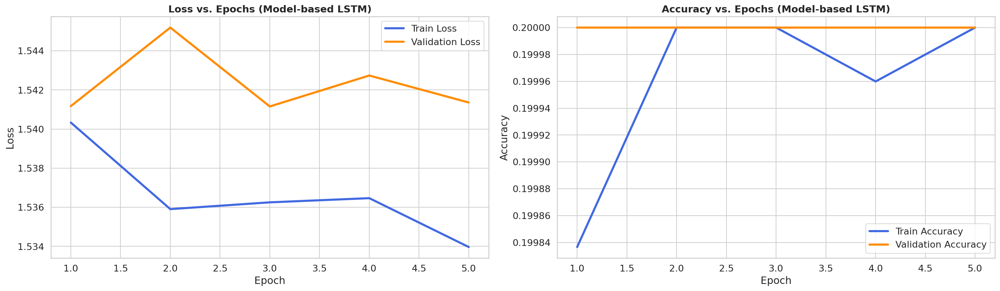

In [ ]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

# High-resolution figure
plt.figure(figsize=(20, 6), dpi=150)

# === 1. Loss Curve ===
plt.subplot(1, 2, 1)
sns.lineplot(x=range(1, len(train_losses) + 1), y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=range(1, len(val_losses) + 1), y=val_losses, label='Validation Loss', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss vs. Epochs (Model-based LSTM)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='upper right')

# === 2. Accuracy Curve ===
plt.subplot(1, 2, 2)
sns.lineplot(x=range(1, len(train_accuracies) + 1), y=train_accuracies, label='Train Accuracy', color='royalblue')
sns.lineplot(x=range(1, len(val_accuracies) + 1), y=val_accuracies, label='Validation Accuracy', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Epochs (Model-based LSTM)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

plt.tight_layout()
plt.show()

### **LSTM + Fasttext (300d)**

In [ ]:
EMBEDDING_DIM = 300
embedding_matrix_fasttext = load_fasttext_embeddings('/content/drive/MyDrive/cc.en.300.vec/cc.en.300.vec', word_to_index, EMBEDDING_DIM)

In [ ]:
model = LSTM_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=450,
    num_layers=1,
    dropout_prob=0.5,
    embedding_weights=embedding_matrix_fasttext,
    freeze_embeddings=False
).to(device)

print(model)
num_params = count_parameters(model)
print()
print(f"Total trainable parameters: {num_params}")

LSTM_Model(
  (embedding): Embedding(40867, 300)
  (lstm): LSTM(300, 450, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.5, inplace=False)
  (fc): Linear(in_features=900, out_features=1, bias=True)
)

Total trainable parameters: 14968201


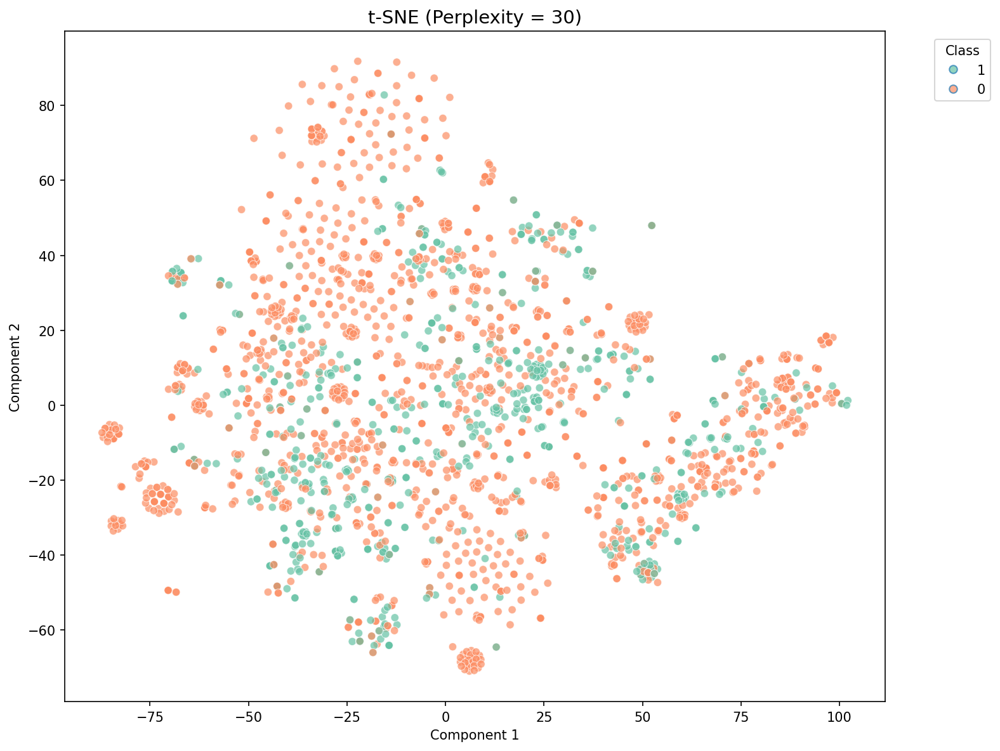

In [ ]:
model.eval()
embeddings = []
labels = []

with torch.no_grad():
    for inputs, targets, _ in train_loader:
        inputs = inputs.to(device)

        embedded = model.embedding(inputs)              # e.g. (B, seq_len, emb_dim)
        emb_mean = embedded.mean(dim=1).cpu().numpy()   # (B, emb_dim)
        embeddings.append(emb_mean)
        labels.extend(targets.cpu().numpy())

# Stack to arrays
embeddings = np.vstack(embeddings)
labels = np.array(labels)

labels = pd.Series(labels).astype(str)
n_classes = labels.nunique()
palette = sns.color_palette("Set2", n_colors=n_classes)

perplexity = 30
tsne = TSNE(n_components=2, perplexity=perplexity, random_state=42, init='pca')
tsne_result = tsne.fit_transform(embeddings)

fig, ax = plt.subplots(figsize=(10, 8), dpi=150)
sns.scatterplot(
    x=tsne_result[:, 0],
    y=tsne_result[:, 1],
    hue=labels,
    palette=palette,
    alpha=0.7,
    ax=ax,
    legend=False
)

ax.set_title(f"t-SNE (Perplexity = {perplexity})", fontsize=14)
ax.set_xlabel("Component 1")
ax.set_ylabel("Component 2")

unique_labels = labels.unique()
handles = []
for i, lab in enumerate(unique_labels):
    handles.append(plt.Line2D([0], [0], marker='o', linestyle='', markersize=6,
                              markerfacecolor=palette[i], alpha=0.7, label=lab))

fig.legend(handles=handles, title="Class", bbox_to_anchor=(0.98, 0.95), loc='upper left')

plt.tight_layout(rect=[0, 0, 0.95, 1])
plt.show()

In [ ]:
learning_rate = 1e-3
num_epochs = 18
patience = 4
min_delta = 1e-4
monitor = "val_loss"

loss_function = nn.BCEWithLogitsLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min' if monitor == "val_loss" else 'max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-7
)

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []
val_f1s = []

best_metric = float('inf') if monitor == "val_loss" else -float('inf')
best_epoch = -1
stalled_epochs = 0
best_state = None

with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, loss_function, device)
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)

        val_loss, val_acc, val_f1 = validate_epoch(model, val_loader, loss_function, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)
        val_f1s.append(val_f1)

        current_metric = val_loss if monitor == "val_loss" else val_f1
        scheduler.step(current_metric)

        # Early stopping logic
        improved = False
        if monitor == "val_loss":
            if current_metric < best_metric - min_delta:
                improved = True
        else:  # monitor == "val_f1"
            if current_metric > best_metric + min_delta:
                improved = True

        if improved:
            best_metric = current_metric
            best_epoch = epoch
            stalled_epochs = 0
            # save best weights (in-memory)
            best_state = {k: v.cpu().clone() for k, v in model.state_dict().items()}
        else:
            stalled_epochs += 1

        end_time = time.time()
        epoch_duration = end_time - start_time
        pbar.set_description(
            f"Epoch {epoch+1}/{num_epochs} - Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, "
            f"Train Acc: {train_acc:.2%}, Val Acc: {val_acc:.2%}, Val F1: {val_f1:.2%}, Time: {epoch_duration / 60:.2f} min"
        )
        pbar.update(1)

        if stalled_epochs >= patience:
            print(f"\nEarly stopping triggered (no improvement in {patience} epochs).")
            break

if best_state is not None:
    model.load_state_dict(best_state)
    print(f"Restored best model from epoch {best_epoch+1} with best {monitor} = {best_metric:.6f}.")
else:
    print("No best state recorded (no improvement during training).")

Epoch 10/18 - Train Loss: 1.5354, Val Loss: 1.5408, Train Acc: 20.00%, Val Acc: 20.00%, Val F1: 15.70%, Time: 0.68 min:  56%|█████▌    | 10/18 [06:40<05:20, 40.05s/epoch]


Early stopping triggered (no improvement in 4 epochs).
Restored best model from epoch 6 with best val_loss = 1.539854.


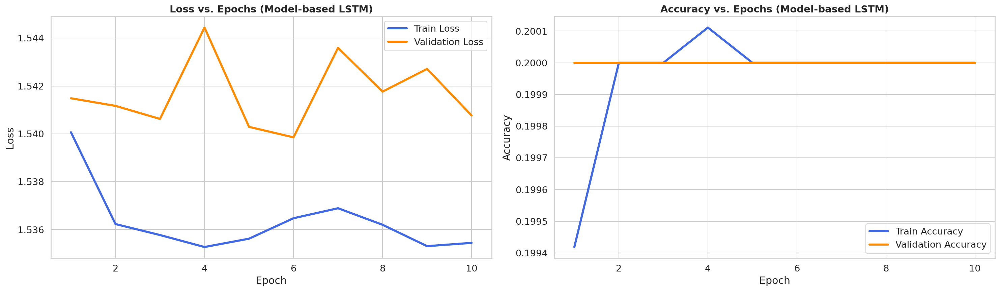

In [ ]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

# High-resolution figure
plt.figure(figsize=(20, 6), dpi=150)

# === 1. Loss Curve ===
plt.subplot(1, 2, 1)
sns.lineplot(x=range(1, len(train_losses) + 1), y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=range(1, len(val_losses) + 1), y=val_losses, label='Validation Loss', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss vs. Epochs (Model-based LSTM)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='upper right')

# === 2. Accuracy Curve ===
plt.subplot(1, 2, 2)
sns.lineplot(x=range(1, len(train_accuracies) + 1), y=train_accuracies, label='Train Accuracy', color='royalblue')
sns.lineplot(x=range(1, len(val_accuracies) + 1), y=val_accuracies, label='Validation Accuracy', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Epochs (Model-based LSTM)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

plt.tight_layout()
plt.show()

### **LSTM + Fasttext (300d) + SMOTE**

In [ ]:
model = LSTM_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=450,
    num_layers=1,
    dropout_prob=0.5,
    embedding_weights=embedding_matrix_fasttext,
    freeze_embeddings=False
).to(device)

print(model)
num_params = count_parameters(model)
print()
print(f"Total trainable parameters: {num_params}")

LSTM_Model(
  (embedding): Embedding(20933, 300)
  (lstm): LSTM(300, 450, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.5, inplace=False)
  (fc): Linear(in_features=900, out_features=5, bias=True)
)

Total trainable parameters: 8991605


In [ ]:
from imblearn.over_sampling import SMOTE
from torch.utils.data import DataLoader

BATCH_SIZE = 16

# Convert training tensors to numpy
X_train_np = X_train_tensor.cpu().numpy()
y_train_np = y_train_tensor.cpu().numpy()

# Create a mapping from vector to raw text for later retrieval
original_text_map = {
    tuple(vec): text for vec, text in zip(X_train_np, X_train)
}

# Apply SMOTE to training data
smote = SMOTE(sampling_strategy='auto', random_state=42)
X_resampled_np, y_resampled_np = smote.fit_resample(X_train_np, y_train_np)

# Reconstruct raw texts (if possible), else tag as synthetic
raw_text_resampled = []
for vec in X_resampled_np:
    key = tuple(vec)
    raw_text_resampled.append(
        original_text_map.get(key, "[Synthetic sample - no raw text]")
    )

# Convert back to tensors
X_resampled_tensor = torch.tensor(X_resampled_np, dtype=torch.float)
y_resampled_tensor = torch.tensor(y_resampled_np, dtype=torch.long)

# Create dataset and dataloader
train_dataset_smote = TextDataset(
    X_resampled_tensor, y_resampled_tensor, raw_text_data=raw_text_resampled
)
train_loader_smote = DataLoader(
    train_dataset_smote,
    batch_size=BATCH_SIZE,
    shuffle=True,
    collate_fn=custom_collate_fn  # Preserves original collation behavior
)

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


In [ ]:
learning_rate = 1e-3
num_epochs = 18
patience = 4
min_delta = 1e-4
monitor = "val_loss"

loss_function = nn.BCEWithLogitsLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min' if monitor == "val_loss" else 'max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-7
)

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []
val_f1s = []

best_metric = float('inf') if monitor == "val_loss" else -float('inf')
best_epoch = -1
stalled_epochs = 0
best_state = None

with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader_smote, optimizer, loss_function, device)
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)

        val_loss, val_acc, val_f1 = validate_epoch(model, val_loader, loss_function, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)
        val_f1s.append(val_f1)

        current_metric = val_loss if monitor == "val_loss" else val_f1
        scheduler.step(current_metric)

        # Early stopping logic
        improved = False
        if monitor == "val_loss":
            if current_metric < best_metric - min_delta:
                improved = True
        else:  # monitor == "val_f1"
            if current_metric > best_metric + min_delta:
                improved = True

        if improved:
            best_metric = current_metric
            best_epoch = epoch
            stalled_epochs = 0
            # save best weights (in-memory)
            best_state = {k: v.cpu().clone() for k, v in model.state_dict().items()}
        else:
            stalled_epochs += 1

        end_time = time.time()
        epoch_duration = end_time - start_time
        pbar.set_description(
            f"Epoch {epoch+1}/{num_epochs} - Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, "
            f"Train Acc: {train_acc:.2%}, Val Acc: {val_acc:.2%}, Val F1: {val_f1:.2%}, Time: {epoch_duration / 60:.2f} min"
        )
        pbar.update(1)

        if stalled_epochs >= patience:
            print(f"\nEarly stopping triggered (no improvement in {patience} epochs).")
            break

if best_state is not None:
    model.load_state_dict(best_state)
    print(f"Restored best model from epoch {best_epoch+1} with best {monitor} = {best_metric:.6f}.")
else:
    print("No best state recorded (no improvement during training).")

Epoch 6/18 - Train Loss: 1.6103, Val Loss: 1.6049, Train Acc: 19.43%, Val Acc: 20.00%, Val F1: 7.86%, Time: 1.08 min:  33%|███▎      | 6/18 [06:31<13:03, 65.28s/epoch]


Early stopping triggered (no improvement in 4 epochs).
Restored best model from epoch 2 with best val_loss = 1.602329.


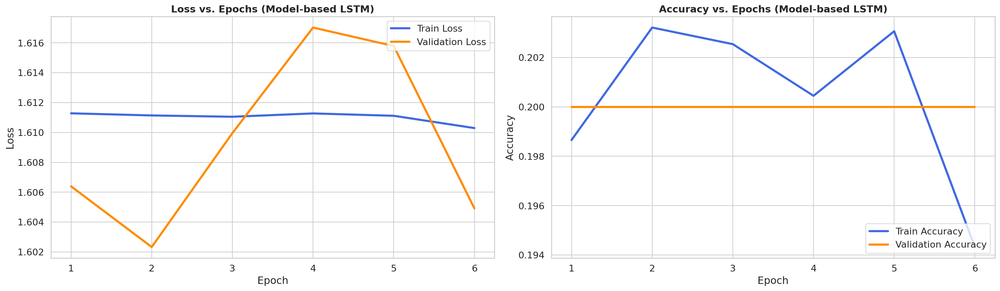

In [ ]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

# High-resolution figure
plt.figure(figsize=(20, 6), dpi=150)

# === 1. Loss Curve ===
plt.subplot(1, 2, 1)
sns.lineplot(x=range(1, len(train_losses) + 1), y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=range(1, len(val_losses) + 1), y=val_losses, label='Validation Loss', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss vs. Epochs (Model-based LSTM)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='upper right')

# === 2. Accuracy Curve ===
plt.subplot(1, 2, 2)
sns.lineplot(x=range(1, len(train_accuracies) + 1), y=train_accuracies, label='Train Accuracy', color='royalblue')
sns.lineplot(x=range(1, len(val_accuracies) + 1), y=val_accuracies, label='Validation Accuracy', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Epochs (Model-based LSTM)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

plt.tight_layout()
plt.show()

### **LSTM + Fasttext (300d) + Weight Class**

In [ ]:
class_weights = compute_class_weight('balanced', classes=np.unique(y_train_tensor.cpu().numpy()), y=y_train_tensor.cpu().numpy())
class_weights_tensor = torch.tensor(class_weights, dtype=torch.float).to(device)

batch_size = 16
train_dataset = TextDataset(X_train_tensor, y_train, raw_text_data=X_train)
val_dataset = TextDataset(X_val_tensor, y_val, raw_text_data=X_val)
test_dataset = TextDataset(X_test_tensor, y_test, raw_text_data=X_test)


train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)


In [ ]:
model = LSTM_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=450,
    num_layers=1,
    dropout_prob=0.5,
    embedding_weights=embedding_matrix_fasttext,
    freeze_embeddings=False
).to(device)

print(model)
num_params = count_parameters(model)
print()
print(f"Total trainable parameters: {num_params}")

In [ ]:
learning_rate = 1e-3
num_epochs = 18
patience = 4
min_delta = 1e-4
monitor = "val_loss"

loss_function = nn.BCEWithLogitsLoss(class_weights_tensor)
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min' if monitor == "val_loss" else 'max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-7
)

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []
val_f1s = []

best_metric = float('inf') if monitor == "val_loss" else -float('inf')
best_epoch = -1
stalled_epochs = 0
best_state = None

with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader, optimizer, loss_function, device)
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)

        val_loss, val_acc, val_f1 = validate_epoch(model, val_loader, loss_function, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)
        val_f1s.append(val_f1)

        current_metric = val_loss if monitor == "val_loss" else val_f1
        scheduler.step(current_metric)

        # Early stopping logic
        improved = False
        if monitor == "val_loss":
            if current_metric < best_metric - min_delta:
                improved = True
        else:  # monitor == "val_f1"
            if current_metric > best_metric + min_delta:
                improved = True

        if improved:
            best_metric = current_metric
            best_epoch = epoch
            stalled_epochs = 0
            # save best weights (in-memory)
            best_state = {k: v.cpu().clone() for k, v in model.state_dict().items()}
        else:
            stalled_epochs += 1

        end_time = time.time()
        epoch_duration = end_time - start_time
        pbar.set_description(
            f"Epoch {epoch+1}/{num_epochs} - Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, "
            f"Train Acc: {train_acc:.2%}, Val Acc: {val_acc:.2%}, Val F1: {val_f1:.2%}, Time: {epoch_duration / 60:.2f} min"
        )
        pbar.update(1)

        if stalled_epochs >= patience:
            print(f"\nEarly stopping triggered (no improvement in {patience} epochs).")
            break

if best_state is not None:
    model.load_state_dict(best_state)
    print(f"Restored best model from epoch {best_epoch+1} with best {monitor} = {best_metric:.6f}.")
else:
    print("No best state recorded (no improvement during training).")

Epoch 6/18 - Train Loss: 1.6099, Val Loss: 1.6098, Train Acc: 19.83%, Val Acc: 20.00%, Val F1: 3.40%, Time: 0.68 min:  33%|███▎      | 6/18 [04:04<08:08, 40.70s/epoch]


Early stopping triggered (no improvement in 4 epochs).
Restored best model from epoch 2 with best val_loss = 1.609105.


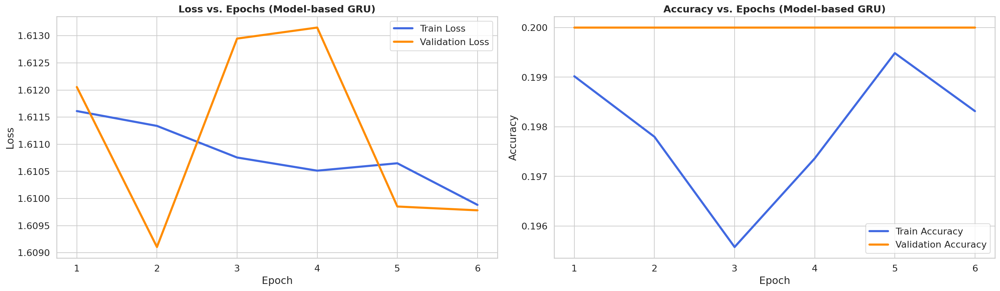

In [ ]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

# High-resolution figure
plt.figure(figsize=(20, 6), dpi=150)

# === 1. Loss Curve ===
plt.subplot(1, 2, 1)
sns.lineplot(x=range(1, len(train_losses) + 1), y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=range(1, len(val_losses) + 1), y=val_losses, label='Validation Loss', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='upper right')

# === 2. Accuracy Curve ===
plt.subplot(1, 2, 2)
sns.lineplot(x=range(1, len(train_accuracies) + 1), y=train_accuracies, label='Train Accuracy', color='royalblue')
sns.lineplot(x=range(1, len(val_accuracies) + 1), y=val_accuracies, label='Validation Accuracy', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

plt.tight_layout()
plt.show()

# **Adding (Bahdanau) attention for improving model prediction**

In [20]:
class BahdanauAttention(nn.Module):
    """
    Bahdanau Attention Mechanism.
    """
    def __init__(self, hidden_dim):
        super(BahdanauAttention, self).__init__()
        self.W = nn.Linear(hidden_dim * 2, hidden_dim)
        self.v = nn.Linear(hidden_dim, 1, bias=False)

    def forward(self, rnn_outputs):
        # rnn_outputs: [batch_size, seq_len, hidden_dim*2]
        score = torch.tanh(self.W(rnn_outputs))
        attn_weights = torch.softmax(self.v(score), dim=1)  # [batch_size, seq_len, 1]
        context = torch.sum(attn_weights * rnn_outputs, dim=1)  # [batch_size, hidden_dim*2]
        return context

class GRU_BahdanauAttention(nn.Module):
    def __init__(self, embedding_matrix, hidden_dim, num_layers=1, dropout_prob=0.6):
        super(GRU_BahdanauAttention, self).__init__()
        vocab_size, embedding_dim = embedding_matrix.shape
        self.embedding = nn.Embedding.from_pretrained(embedding_matrix, freeze=False)

        self.gru = nn.GRU(
            input_size=embedding_dim,
            hidden_size=hidden_dim,
            num_layers=num_layers,
            batch_first=True,
            bidirectional=True
        )

        self.attention = BahdanauAttention(hidden_dim)
        self.dropout = nn.Dropout(dropout_prob)
        self.fc = nn.Linear(hidden_dim * 2, 1)  # binary output

    def forward(self, x):
        embedded = self.embedding(x)
        gru_out, _ = self.gru(embedded)
        context = self.attention(gru_out)
        x = self.dropout(context)
        output = self.fc(x)  # raw logits (no sigmoid)
        return output

class LSTM_BahdanauAttention(nn.Module):
    """
    Bidirectional LSTM with Bahdanau Attention Mechanism for binary classification.
    """
    def __init__(self, embedding_matrix, hidden_dim, num_layers=1, dropout_prob=0.6):
        super(LSTM_BahdanauAttention, self).__init__()
        vocab_size, embedding_dim = embedding_matrix.shape
        self.embedding = nn.Embedding.from_pretrained(embedding_matrix, freeze=False)

        self.lstm = nn.LSTM(
            input_size=embedding_dim,
            hidden_size=hidden_dim,
            num_layers=num_layers,
            batch_first=True,
            dropout=dropout_prob if num_layers > 1 else 0,
            bidirectional=True
        )

        self.attention = BahdanauAttention(hidden_dim)
        self.dropout = nn.Dropout(dropout_prob)
        self.fc = nn.Linear(hidden_dim * 2, 1)  # binary output

    def forward(self, x):
        embedded = self.embedding(x)
        lstm_out, _ = self.lstm(embedded)
        context = self.attention(lstm_out)
        x = self.dropout(context)
        output = self.fc(x)  # raw logits (no sigmoid)
        return output

## **Validation Phase**

### **Bidirectional GRU + Fasttext (300d) + Bahdanau Attention**

In [ ]:
EMBEDDING_DIM = 300
embedding_matrix_fasttext = load_fasttext_embeddings('/content/drive/MyDrive/cc.en.300.vec/cc.en.300.vec', word_to_index, EMBEDDING_DIM)

In [ ]:
model = GRU_BahdanauAttention(embedding_matrix=embedding_matrix_fasttext, hidden_dim=450, num_layers=1, dropout_prob=0.5).to(device)

print(model)
num_params = count_parameters(model)
print()
print(f"Total trainable parameters: {num_params}")

GRU_BahdanauAttention(
  (embedding): Embedding(20933, 300)
  (gru): GRU(300, 450, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=900, out_features=450, bias=True)
    (v): Linear(in_features=450, out_features=1, bias=False)
  )
  (fc): Linear(in_features=900, out_features=5, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)

Total trainable parameters: 8720705


In [ ]:
learning_rate = 1e-3
num_epochs = 18
patience = 4
min_delta = 1e-4
monitor = "val_loss"

loss_function = nn.BCEWithLogitsLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min' if monitor == "val_loss" else 'max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-7
)

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []
val_f1s = []

best_metric = float('inf') if monitor == "val_loss" else -float('inf')
best_epoch = -1
stalled_epochs = 0
best_state = None

with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader_smote, optimizer, loss_function, device)
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)

        val_loss, val_acc, val_f1 = validate_epoch(model, val_loader, loss_function, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)
        val_f1s.append(val_f1)

        current_metric = val_loss if monitor == "val_loss" else val_f1
        scheduler.step(current_metric)

        # Early stopping logic
        improved = False
        if monitor == "val_loss":
            if current_metric < best_metric - min_delta:
                improved = True
        else:  # monitor == "val_f1"
            if current_metric > best_metric + min_delta:
                improved = True

        if improved:
            best_metric = current_metric
            best_epoch = epoch
            stalled_epochs = 0
            # save best weights (in-memory)
            best_state = {k: v.cpu().clone() for k, v in model.state_dict().items()}
        else:
            stalled_epochs += 1

        end_time = time.time()
        epoch_duration = end_time - start_time
        pbar.set_description(
            f"Epoch {epoch+1}/{num_epochs} - Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, "
            f"Train Acc: {train_acc:.2%}, Val Acc: {val_acc:.2%}, Val F1: {val_f1:.2%}, Time: {epoch_duration / 60:.2f} min"
        )
        pbar.update(1)

        if stalled_epochs >= patience:
            print(f"\nEarly stopping triggered (no improvement in {patience} epochs).")
            break

if best_state is not None:
    model.load_state_dict(best_state)
    print(f"Restored best model from epoch {best_epoch+1} with best {monitor} = {best_metric:.6f}.")
else:
    print("No best state recorded (no improvement during training).")

Epoch 5/18 - Train Loss: 0.3225, Val Loss: 1.8232, Train Acc: 86.60%, Val Acc: 50.17%, Val F1: 49.40%, Time: 0.98 min:  28%|██▊       | 5/18 [04:48<12:29, 57.69s/epoch]


Early stopping triggered (no improvement in 4 epochs).
Restored best model from epoch 1 with best val_loss = 0.941262.


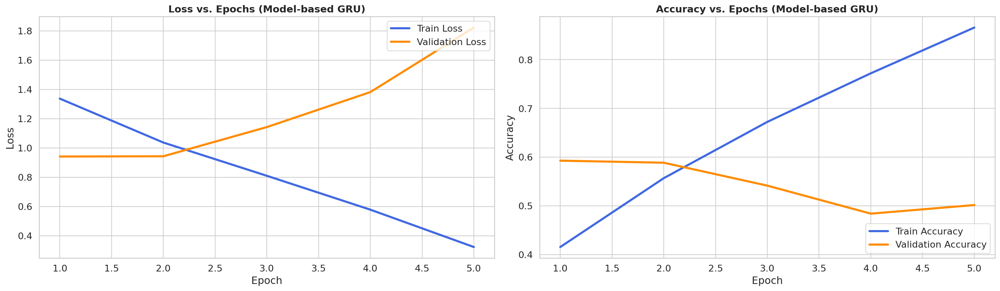

In [ ]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

# High-resolution figure
plt.figure(figsize=(20, 6), dpi=150)

# === 1. Loss Curve ===
plt.subplot(1, 2, 1)
sns.lineplot(x=range(1, len(train_losses) + 1), y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=range(1, len(val_losses) + 1), y=val_losses, label='Validation Loss', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='upper right')

# === 2. Accuracy Curve ===
plt.subplot(1, 2, 2)
sns.lineplot(x=range(1, len(train_accuracies) + 1), y=train_accuracies, label='Train Accuracy', color='royalblue')
sns.lineplot(x=range(1, len(val_accuracies) + 1), y=val_accuracies, label='Validation Accuracy', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

plt.tight_layout()
plt.show()

### **Bidirectional GRU + Fasttext (300d) + Bahdanau Attention + SMOTE**

In [ ]:
model = GRU_BahdanauAttention(embedding_matrix=embedding_matrix_fasttext, hidden_dim=420, num_layers=1, dropout_prob=0.3).to(device)

print(model)
num_params = count_parameters(model)
print()
print(f"Total trainable parameters: {num_params}")

GRU_BahdanauAttention(
  (embedding): Embedding(20933, 300)
  (gru): GRU(300, 420, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=840, out_features=420, bias=True)
    (v): Linear(in_features=420, out_features=1, bias=False)
  )
  (fc): Linear(in_features=840, out_features=5, bias=True)
  (dropout): Dropout(p=0.3, inplace=False)
)

Total trainable parameters: 8457185


In [ ]:
BATCH_SIZE = 16

# Convert training tensors to numpy
X_train_np = X_train_tensor.cpu().numpy()
y_train_np = y_train_tensor.cpu().numpy()

# Create a mapping from vector to raw text for later retrieval
original_text_map = {
    tuple(vec): text for vec, text in zip(X_train_np, X_train)
}

# Apply SMOTE to training data
smote = SMOTE(sampling_strategy='auto', random_state=42)
X_resampled_np, y_resampled_np = smote.fit_resample(X_train_np, y_train_np)

# Reconstruct raw texts (if possible), else tag as synthetic
raw_text_resampled = []
for vec in X_resampled_np:
    key = tuple(vec)
    raw_text_resampled.append(
        original_text_map.get(key, "[Synthetic sample - no raw text]")
    )

# Convert back to tensors
X_resampled_tensor = torch.tensor(X_resampled_np, dtype=torch.float)
y_resampled_tensor = torch.tensor(y_resampled_np, dtype=torch.long)

# Create dataset and dataloader
train_dataset_smote = TextDataset(
    X_resampled_tensor, y_resampled_tensor, raw_text_data=raw_text_resampled
)
train_loader_smote = DataLoader(
    train_dataset_smote,
    batch_size=BATCH_SIZE,
    shuffle=True,
    collate_fn=custom_collate_fn  # Preserves original collation behavior
)

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


In [ ]:
learning_rate = 1e-3
num_epochs = 18
patience = 4
min_delta = 1e-4
monitor = "val_loss"

loss_function = nn.BCEWithLogitsLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min' if monitor == "val_loss" else 'max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-7
)

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []
val_f1s = []

best_metric = float('inf') if monitor == "val_loss" else -float('inf')
best_epoch = -1
stalled_epochs = 0
best_state = None

with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader_smote, optimizer, loss_function, device)
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)

        val_loss, val_acc, val_f1 = validate_epoch(model, val_loader, loss_function, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)
        val_f1s.append(val_f1)

        current_metric = val_loss if monitor == "val_loss" else val_f1
        scheduler.step(current_metric)

        # Early stopping logic
        improved = False
        if monitor == "val_loss":
            if current_metric < best_metric - min_delta:
                improved = True
        else:  # monitor == "val_f1"
            if current_metric > best_metric + min_delta:
                improved = True

        if improved:
            best_metric = current_metric
            best_epoch = epoch
            stalled_epochs = 0
            # save best weights (in-memory)
            best_state = {k: v.cpu().clone() for k, v in model.state_dict().items()}
        else:
            stalled_epochs += 1

        end_time = time.time()
        epoch_duration = end_time - start_time
        pbar.set_description(
            f"Epoch {epoch+1}/{num_epochs} - Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, "
            f"Train Acc: {train_acc:.2%}, Val Acc: {val_acc:.2%}, Val F1: {val_f1:.2%}, Time: {epoch_duration / 60:.2f} min"
        )
        pbar.update(1)

        if stalled_epochs >= patience:
            print(f"\nEarly stopping triggered (no improvement in {patience} epochs).")
            break

if best_state is not None:
    model.load_state_dict(best_state)
    print(f"Restored best model from epoch {best_epoch+1} with best {monitor} = {best_metric:.6f}.")
else:
    print("No best state recorded (no improvement during training).")

Epoch 5/18 - Train Loss: 0.2817, Val Loss: 1.9210, Train Acc: 87.78%, Val Acc: 47.91%, Val F1: 47.56%, Time: 0.89 min:  28%|██▊       | 5/18 [04:26<11:32, 53.27s/epoch]


Early stopping triggered (no improvement in 4 epochs).
Restored best model from epoch 1 with best val_loss = 0.981128.


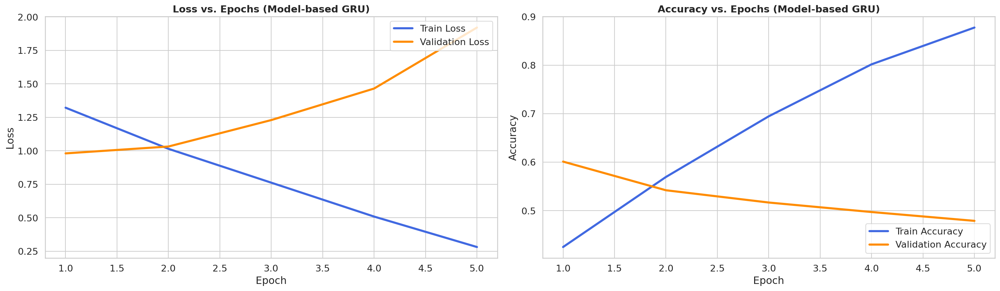

In [ ]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

# High-resolution figure
plt.figure(figsize=(20, 6), dpi=150)

# === 1. Loss Curve ===
plt.subplot(1, 2, 1)
sns.lineplot(x=range(1, len(train_losses) + 1), y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=range(1, len(val_losses) + 1), y=val_losses, label='Validation Loss', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='upper right')

# === 2. Accuracy Curve ===
plt.subplot(1, 2, 2)
sns.lineplot(x=range(1, len(train_accuracies) + 1), y=train_accuracies, label='Train Accuracy', color='royalblue')
sns.lineplot(x=range(1, len(val_accuracies) + 1), y=val_accuracies, label='Validation Accuracy', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

plt.tight_layout()
plt.show()

### **Bidirectional GRU + Fasttext (300d) + Bahdanau Attention + Weight Class**

In [ ]:
model = GRU_BahdanauAttention(embedding_matrix=embedding_matrix_fasttext, hidden_dim=400, num_layers=1, dropout_prob=0.5).to(device)

print(model)
num_params = count_parameters(model)
print()
print(f"Total trainable parameters: {num_params}")

GRU_BahdanauAttention(
  (embedding): Embedding(20933, 300)
  (gru): GRU(300, 400, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=800, out_features=400, bias=True)
    (v): Linear(in_features=400, out_features=1, bias=False)
  )
  (fc): Linear(in_features=800, out_features=5, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)

Total trainable parameters: 8289505


In [ ]:
class_weights = compute_class_weight('balanced', classes=np.unique(y_train_tensor.cpu().numpy()), y=y_train_tensor.cpu().numpy())
class_weights_tensor = torch.tensor(class_weights, dtype=torch.float).to(device)

batch_size = 16
train_dataset = TextDataset(X_train_tensor, y_train, raw_text_data=X_train)
val_dataset = TextDataset(X_val_tensor, y_val, raw_text_data=X_val)
test_dataset = TextDataset(X_test_tensor, y_test, raw_text_data=X_test)


train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)


In [ ]:
learning_rate = 1e-3
num_epochs = 18
patience = 4
min_delta = 1e-4
monitor = "val_loss"

loss_function = nn.BCEWithLogitsLoss(class_weights_tensor)
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min' if monitor == "val_loss" else 'max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-7
)

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []
val_f1s = []

best_metric = float('inf') if monitor == "val_loss" else -float('inf')
best_epoch = -1
stalled_epochs = 0
best_state = None

with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader_smote, optimizer, loss_function, device)
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)

        val_loss, val_acc, val_f1 = validate_epoch(model, val_loader, loss_function, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)
        val_f1s.append(val_f1)

        current_metric = val_loss if monitor == "val_loss" else val_f1
        scheduler.step(current_metric)

        # Early stopping logic
        improved = False
        if monitor == "val_loss":
            if current_metric < best_metric - min_delta:
                improved = True
        else:  # monitor == "val_f1"
            if current_metric > best_metric + min_delta:
                improved = True

        if improved:
            best_metric = current_metric
            best_epoch = epoch
            stalled_epochs = 0
            # save best weights (in-memory)
            best_state = {k: v.cpu().clone() for k, v in model.state_dict().items()}
        else:
            stalled_epochs += 1

        end_time = time.time()
        epoch_duration = end_time - start_time
        pbar.set_description(
            f"Epoch {epoch+1}/{num_epochs} - Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, "
            f"Train Acc: {train_acc:.2%}, Val Acc: {val_acc:.2%}, Val F1: {val_f1:.2%}, Time: {epoch_duration / 60:.2f} min"
        )
        pbar.update(1)

        if stalled_epochs >= patience:
            print(f"\nEarly stopping triggered (no improvement in {patience} epochs).")
            break

if best_state is not None:
    model.load_state_dict(best_state)
    print(f"Restored best model from epoch {best_epoch+1} with best {monitor} = {best_metric:.6f}.")
else:
    print("No best state recorded (no improvement during training).")

Epoch 5/18 - Train Loss: 0.3553, Val Loss: 1.7515, Train Acc: 85.80%, Val Acc: 50.98%, Val F1: 50.33%, Time: 0.81 min:  28%|██▊       | 5/18 [04:02<10:31, 48.57s/epoch]


Early stopping triggered (no improvement in 4 epochs).
Restored best model from epoch 1 with best val_loss = 0.935738.


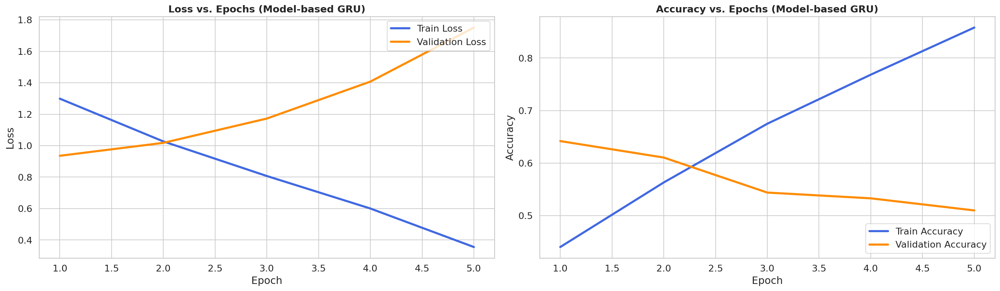

In [ ]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

# High-resolution figure
plt.figure(figsize=(20, 6), dpi=150)

# === 1. Loss Curve ===
plt.subplot(1, 2, 1)
sns.lineplot(x=range(1, len(train_losses) + 1), y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=range(1, len(val_losses) + 1), y=val_losses, label='Validation Loss', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='upper right')

# === 2. Accuracy Curve ===
plt.subplot(1, 2, 2)
sns.lineplot(x=range(1, len(train_accuracies) + 1), y=train_accuracies, label='Train Accuracy', color='royalblue')
sns.lineplot(x=range(1, len(val_accuracies) + 1), y=val_accuracies, label='Validation Accuracy', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

plt.tight_layout()
plt.show()

### **Bidirectional GRU + Glove (300d) + Bahdanau Attention**

In [ ]:
EMBEDDING_DIM = 300
embedding_matrix_glove = load_glove_embeddings('/content/drive/MyDrive/glove/glove.6B.300d.txt', word_to_index, EMBEDDING_DIM)

In [ ]:
model = GRU_BahdanauAttention(embedding_matrix=embedding_matrix_glove, hidden_dim=450, num_layers=1, dropout_prob=0.5).to(device)

print(model)
num_params = count_parameters(model)
print()
print(f"Total trainable parameters: {num_params}")

GRU_BahdanauAttention(
  (embedding): Embedding(20933, 300)
  (gru): GRU(300, 450, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=900, out_features=450, bias=True)
    (v): Linear(in_features=450, out_features=1, bias=False)
  )
  (fc): Linear(in_features=900, out_features=5, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)

Total trainable parameters: 8720705


In [ ]:
learning_rate = 1e-3
num_epochs = 18
patience = 4
min_delta = 1e-4
monitor = "val_loss"

loss_function = nn.BCEWithLogitsLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min' if monitor == "val_loss" else 'max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-7
)

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []
val_f1s = []

best_metric = float('inf') if monitor == "val_loss" else -float('inf')
best_epoch = -1
stalled_epochs = 0
best_state = None

with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader_smote, optimizer, loss_function, device)
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)

        val_loss, val_acc, val_f1 = validate_epoch(model, val_loader, loss_function, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)
        val_f1s.append(val_f1)

        current_metric = val_loss if monitor == "val_loss" else val_f1
        scheduler.step(current_metric)

        # Early stopping logic
        improved = False
        if monitor == "val_loss":
            if current_metric < best_metric - min_delta:
                improved = True
        else:  # monitor == "val_f1"
            if current_metric > best_metric + min_delta:
                improved = True

        if improved:
            best_metric = current_metric
            best_epoch = epoch
            stalled_epochs = 0
            # save best weights (in-memory)
            best_state = {k: v.cpu().clone() for k, v in model.state_dict().items()}
        else:
            stalled_epochs += 1

        end_time = time.time()
        epoch_duration = end_time - start_time
        pbar.set_description(
            f"Epoch {epoch+1}/{num_epochs} - Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, "
            f"Train Acc: {train_acc:.2%}, Val Acc: {val_acc:.2%}, Val F1: {val_f1:.2%}, Time: {epoch_duration / 60:.2f} min"
        )
        pbar.update(1)

        if stalled_epochs >= patience:
            print(f"\nEarly stopping triggered (no improvement in {patience} epochs).")
            break

if best_state is not None:
    model.load_state_dict(best_state)
    print(f"Restored best model from epoch {best_epoch+1} with best {monitor} = {best_metric:.6f}.")
else:
    print("No best state recorded (no improvement during training).")

Epoch 5/18 - Train Loss: 0.3459, Val Loss: 1.5694, Train Acc: 85.70%, Val Acc: 51.97%, Val F1: 51.72%, Time: 0.98 min:  28%|██▊       | 5/18 [04:53<12:41, 58.60s/epoch]


Early stopping triggered (no improvement in 4 epochs).
Restored best model from epoch 1 with best val_loss = 0.906661.


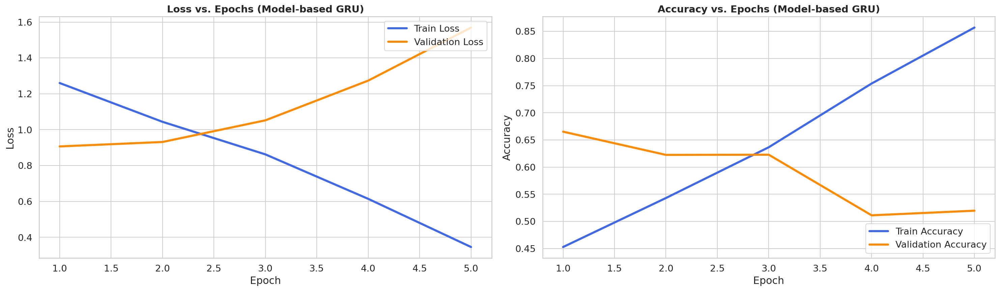

In [ ]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

# High-resolution figure
plt.figure(figsize=(20, 6), dpi=150)

# === 1. Loss Curve ===
plt.subplot(1, 2, 1)
sns.lineplot(x=range(1, len(train_losses) + 1), y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=range(1, len(val_losses) + 1), y=val_losses, label='Validation Loss', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='upper right')

# === 2. Accuracy Curve ===
plt.subplot(1, 2, 2)
sns.lineplot(x=range(1, len(train_accuracies) + 1), y=train_accuracies, label='Train Accuracy', color='royalblue')
sns.lineplot(x=range(1, len(val_accuracies) + 1), y=val_accuracies, label='Validation Accuracy', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

plt.tight_layout()
plt.show()

### **Bidirectional GRU + Glove (300d) + Bahdanau Attention +  SMOTE**

In [ ]:
model = GRU_BahdanauAttention(embedding_matrix=embedding_matrix_glove, hidden_dim=450, num_layers=1, dropout_prob=0.5).to(device)

print(model)
num_params = count_parameters(model)
print()
print(f"Total trainable parameters: {num_params}")

GRU_BahdanauAttention(
  (embedding): Embedding(20933, 300)
  (gru): GRU(300, 450, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=900, out_features=450, bias=True)
    (v): Linear(in_features=450, out_features=1, bias=False)
  )
  (fc): Linear(in_features=900, out_features=5, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)

Total trainable parameters: 8720705


In [ ]:
from imblearn.over_sampling import SMOTE
from torch.utils.data import DataLoader

BATCH_SIZE = 16

# Convert training tensors to numpy
X_train_np = X_train_tensor.cpu().numpy()
y_train_np = y_train_tensor.cpu().numpy()

# Create a mapping from vector to raw text for later retrieval
original_text_map = {
    tuple(vec): text for vec, text in zip(X_train_np, X_train)
}

# Apply SMOTE to training data
smote = SMOTE(sampling_strategy='auto', random_state=42)
X_resampled_np, y_resampled_np = smote.fit_resample(X_train_np, y_train_np)

# Reconstruct raw texts (if possible), else tag as synthetic
raw_text_resampled = []
for vec in X_resampled_np:
    key = tuple(vec)
    raw_text_resampled.append(
        original_text_map.get(key, "[Synthetic sample - no raw text]")
    )

# Convert back to tensors
X_resampled_tensor = torch.tensor(X_resampled_np, dtype=torch.float)
y_resampled_tensor = torch.tensor(y_resampled_np, dtype=torch.long)

# Create dataset and dataloader
train_dataset_smote = TextDataset(
    X_resampled_tensor, y_resampled_tensor, raw_text_data=raw_text_resampled
)
train_loader_smote = DataLoader(
    train_dataset_smote,
    batch_size=BATCH_SIZE,
    shuffle=True,
    collate_fn=custom_collate_fn  # Preserves original collation behavior
)

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


In [ ]:
learning_rate = 1e-3
num_epochs = 18
patience = 4
min_delta = 1e-4
monitor = "val_loss"

loss_function = nn.BCEWithLogitsLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min' if monitor == "val_loss" else 'max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-7
)

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []
val_f1s = []

best_metric = float('inf') if monitor == "val_loss" else -float('inf')
best_epoch = -1
stalled_epochs = 0
best_state = None

with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader_smote, optimizer, loss_function, device)
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)

        val_loss, val_acc, val_f1 = validate_epoch(model, val_loader, loss_function, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)
        val_f1s.append(val_f1)

        current_metric = val_loss if monitor == "val_loss" else val_f1
        scheduler.step(current_metric)

        # Early stopping logic
        improved = False
        if monitor == "val_loss":
            if current_metric < best_metric - min_delta:
                improved = True
        else:  # monitor == "val_f1"
            if current_metric > best_metric + min_delta:
                improved = True

        if improved:
            best_metric = current_metric
            best_epoch = epoch
            stalled_epochs = 0
            # save best weights (in-memory)
            best_state = {k: v.cpu().clone() for k, v in model.state_dict().items()}
        else:
            stalled_epochs += 1

        end_time = time.time()
        epoch_duration = end_time - start_time
        pbar.set_description(
            f"Epoch {epoch+1}/{num_epochs} - Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, "
            f"Train Acc: {train_acc:.2%}, Val Acc: {val_acc:.2%}, Val F1: {val_f1:.2%}, Time: {epoch_duration / 60:.2f} min"
        )
        pbar.update(1)

        if stalled_epochs >= patience:
            print(f"\nEarly stopping triggered (no improvement in {patience} epochs).")
            break

if best_state is not None:
    model.load_state_dict(best_state)
    print(f"Restored best model from epoch {best_epoch+1} with best {monitor} = {best_metric:.6f}.")
else:
    print("No best state recorded (no improvement during training).")

Epoch 5/18 - Train Loss: 0.3682, Val Loss: 1.5828, Train Acc: 85.00%, Val Acc: 52.90%, Val F1: 52.16%, Time: 1.09 min:  28%|██▊       | 5/18 [05:04<13:10, 60.83s/epoch]


Early stopping triggered (no improvement in 4 epochs).
Restored best model from epoch 1 with best val_loss = 0.895515.


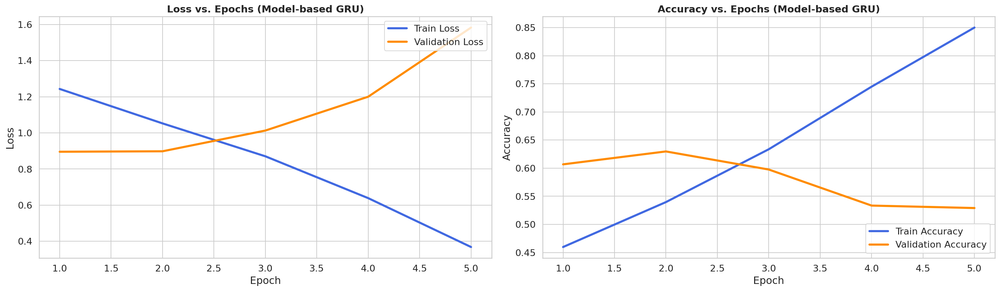

In [ ]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

# High-resolution figure
plt.figure(figsize=(20, 6), dpi=150)

# === 1. Loss Curve ===
plt.subplot(1, 2, 1)
sns.lineplot(x=range(1, len(train_losses) + 1), y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=range(1, len(val_losses) + 1), y=val_losses, label='Validation Loss', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='upper right')

# === 2. Accuracy Curve ===
plt.subplot(1, 2, 2)
sns.lineplot(x=range(1, len(train_accuracies) + 1), y=train_accuracies, label='Train Accuracy', color='royalblue')
sns.lineplot(x=range(1, len(val_accuracies) + 1), y=val_accuracies, label='Validation Accuracy', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

plt.tight_layout()
plt.show()

### **Bidirectional GRU + Glove (300d) + Bahdanau Attention + Weight Class**

In [ ]:
model = GRU_BahdanauAttention(embedding_matrix=embedding_matrix_fasttext, hidden_dim=400, num_layers=1, dropout_prob=0.5).to(device)

print(model)
num_params = count_parameters(model)
print()
print(f"Total trainable parameters: {num_params}")

GRU_BahdanauAttention(
  (embedding): Embedding(20933, 300)
  (gru): GRU(300, 400, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=800, out_features=400, bias=True)
    (v): Linear(in_features=400, out_features=1, bias=False)
  )
  (fc): Linear(in_features=800, out_features=5, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)

Total trainable parameters: 8289505


In [ ]:
class_weights = compute_class_weight('balanced', classes=np.unique(y_train_tensor.cpu().numpy()), y=y_train_tensor.cpu().numpy())
class_weights_tensor = torch.tensor(class_weights, dtype=torch.float).to(device)

batch_size = 16
train_dataset = TextDataset(X_train_tensor, y_train, raw_text_data=X_train)
val_dataset = TextDataset(X_val_tensor, y_val, raw_text_data=X_val)
test_dataset = TextDataset(X_test_tensor, y_test, raw_text_data=X_test)


train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)


In [ ]:
learning_rate = 1e-3
num_epochs = 18
patience = 4
min_delta = 1e-4
monitor = "val_loss"

loss_function = nn.BCEWithLogitsLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min' if monitor == "val_loss" else 'max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-7
)

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []
val_f1s = []

best_metric = float('inf') if monitor == "val_loss" else -float('inf')
best_epoch = -1
stalled_epochs = 0
best_state = None

with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader_smote, optimizer, loss_function, device)
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)

        val_loss, val_acc, val_f1 = validate_epoch(model, val_loader, loss_function, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)
        val_f1s.append(val_f1)

        current_metric = val_loss if monitor == "val_loss" else val_f1
        scheduler.step(current_metric)

        # Early stopping logic
        improved = False
        if monitor == "val_loss":
            if current_metric < best_metric - min_delta:
                improved = True
        else:  # monitor == "val_f1"
            if current_metric > best_metric + min_delta:
                improved = True

        if improved:
            best_metric = current_metric
            best_epoch = epoch
            stalled_epochs = 0
            # save best weights (in-memory)
            best_state = {k: v.cpu().clone() for k, v in model.state_dict().items()}
        else:
            stalled_epochs += 1

        end_time = time.time()
        epoch_duration = end_time - start_time
        pbar.set_description(
            f"Epoch {epoch+1}/{num_epochs} - Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, "
            f"Train Acc: {train_acc:.2%}, Val Acc: {val_acc:.2%}, Val F1: {val_f1:.2%}, Time: {epoch_duration / 60:.2f} min"
        )
        pbar.update(1)

        if stalled_epochs >= patience:
            print(f"\nEarly stopping triggered (no improvement in {patience} epochs).")
            break

if best_state is not None:
    model.load_state_dict(best_state)
    print(f"Restored best model from epoch {best_epoch+1} with best {monitor} = {best_metric:.6f}.")
else:
    print("No best state recorded (no improvement during training).")

Epoch 5/18 - Train Loss: 0.3549, Val Loss: 1.7298, Train Acc: 85.53%, Val Acc: 49.41%, Val F1: 49.87%, Time: 0.81 min:  28%|██▊       | 5/18 [04:31<11:45, 54.26s/epoch]


Early stopping triggered (no improvement in 4 epochs).
Restored best model from epoch 1 with best val_loss = 0.971161.


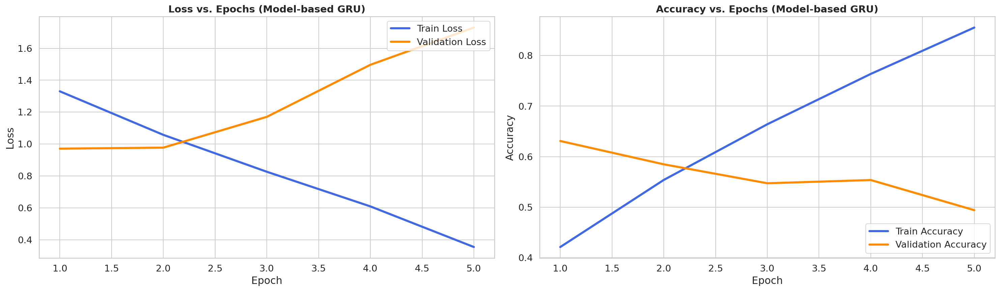

In [ ]:
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

# High-resolution figure
plt.figure(figsize=(20, 6), dpi=150)

# === 1. Loss Curve ===
plt.subplot(1, 2, 1)
sns.lineplot(x=range(1, len(train_losses) + 1), y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=range(1, len(val_losses) + 1), y=val_losses, label='Validation Loss', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='upper right')

# === 2. Accuracy Curve ===
plt.subplot(1, 2, 2)
sns.lineplot(x=range(1, len(train_accuracies) + 1), y=train_accuracies, label='Train Accuracy', color='royalblue')
sns.lineplot(x=range(1, len(val_accuracies) + 1), y=val_accuracies, label='Validation Accuracy', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

plt.tight_layout()
plt.show()

### **Bidirectional LSTM + Bahdanau Attention + SMOTE**

In [ ]:
model = LSTM_BahdanauAttention(embedding_matrix=embedding_matrix_glove, hidden_dim=450, num_layers=1, dropout_prob=0.5).to(device)

print(model)
num_params = count_parameters(model)
print()
print(f"Total trainable parameters: {num_params}")

LSTM_BahdanauAttention(
  (embedding): Embedding(20933, 300)
  (lstm): LSTM(300, 450, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=900, out_features=450, bias=True)
    (v): Linear(in_features=450, out_features=1, bias=False)
  )
  (dropout): Dropout(p=0.5, inplace=False)
  (fc): Linear(in_features=900, out_features=5, bias=True)
)

Total trainable parameters: 9397505


In [ ]:
BATCH_SIZE = 16

# Convert training tensors to numpy
X_train_np = X_train_tensor.cpu().numpy()
y_train_np = y_train_tensor.cpu().numpy()

# Create a mapping from vector to raw text for later retrieval
original_text_map = {
    tuple(vec): text for vec, text in zip(X_train_np, X_train)
}

# Apply SMOTE to training data
smote = SMOTE(sampling_strategy='auto', random_state=42)
X_resampled_np, y_resampled_np = smote.fit_resample(X_train_np, y_train_np)

# Reconstruct raw texts (if possible), else tag as synthetic
raw_text_resampled = []
for vec in X_resampled_np:
    key = tuple(vec)
    raw_text_resampled.append(
        original_text_map.get(key, "[Synthetic sample - no raw text]")
    )

# Convert back to tensors
X_resampled_tensor = torch.tensor(X_resampled_np, dtype=torch.float)
y_resampled_tensor = torch.tensor(y_resampled_np, dtype=torch.long)

# Create dataset and dataloader
train_dataset_smote = TextDataset(
    X_resampled_tensor, y_resampled_tensor, raw_text_data=raw_text_resampled
)
train_loader_smote = DataLoader(
    train_dataset_smote,
    batch_size=BATCH_SIZE,
    shuffle=True,
    collate_fn=custom_collate_fn  # Preserves original collation behavior
)

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


In [ ]:
learning_rate = 1e-3
num_epochs = 18
patience = 4
min_delta = 1e-4
monitor = "val_loss"

loss_function = nn.BCEWithLogitsLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min' if monitor == "val_loss" else 'max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-7
)

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []
val_f1s = []

best_metric = float('inf') if monitor == "val_loss" else -float('inf')
best_epoch = -1
stalled_epochs = 0
best_state = None

with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader_smote, optimizer, loss_function, device)
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)

        val_loss, val_acc, val_f1 = validate_epoch(model, test_loader, loss_function, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)
        val_f1s.append(val_f1)

        current_metric = val_loss if monitor == "val_loss" else val_f1
        scheduler.step(current_metric)

        # Early stopping logic
        improved = False
        if monitor == "val_loss":
            if current_metric < best_metric - min_delta:
                improved = True
        else:  # monitor == "val_f1"
            if current_metric > best_metric + min_delta:
                improved = True

        if improved:
            best_metric = current_metric
            best_epoch = epoch
            stalled_epochs = 0
            # save best weights (in-memory)
            best_state = {k: v.cpu().clone() for k, v in model.state_dict().items()}
        else:
            stalled_epochs += 1

        end_time = time.time()
        epoch_duration = end_time - start_time
        pbar.set_description(
            f"Epoch {epoch+1}/{num_epochs} - Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, "
            f"Train Acc: {train_acc:.2%}, Val Acc: {val_acc:.2%}, Val F1: {val_f1:.2%}, Time: {epoch_duration / 60:.2f} min"
        )
        pbar.update(1)

        if stalled_epochs >= patience:
            print(f"\nEarly stopping triggered (no improvement in {patience} epochs).")
            break

if best_state is not None:
    model.load_state_dict(best_state)
    print(f"Restored best model from epoch {best_epoch+1} with best {monitor} = {best_metric:.6f}.")
else:
    print("No best state recorded (no improvement during training).")

Epoch 5/18 - Train Loss: 0.2278, Val Loss: 1.7912, Train Acc: 87.69%, Val Acc: 45.89%, Val F1: 47.20%, Time: 1.40 min:  28%|██▊       | 5/18 [07:17<18:57, 87.53s/epoch]


Early stopping triggered (no improvement in 4 epochs).
Restored best model from epoch 1 with best val_loss = 1.331789.


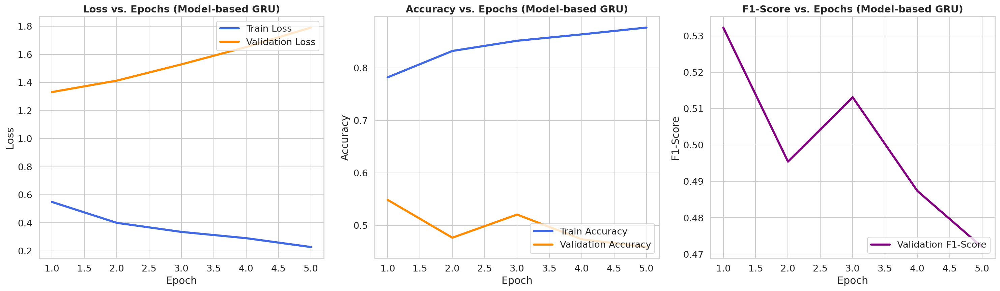

In [ ]:
# Set style and font size
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

# High-resolution figure
plt.figure(figsize=(20, 6), dpi=150)

# === 1. Loss Curve ===
plt.subplot(1, 3, 1)
sns.lineplot(x=range(1, len(train_losses) + 1), y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=range(1, len(val_losses) + 1), y=val_losses, label='Validation Loss', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='upper right')

# === 2. Accuracy Curve ===
plt.subplot(1, 3, 2)
sns.lineplot(x=range(1, len(train_accuracies) + 1), y=train_accuracies, label='Train Accuracy', color='royalblue')
sns.lineplot(x=range(1, len(val_accuracies) + 1), y=val_accuracies, label='Validation Accuracy', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

# === 3. F1-Score Curve ===
plt.subplot(1, 3, 3)
sns.lineplot(x=range(1, len(val_f1s) + 1), y=val_f1s, label='Validation F1-Score', color='purple')
plt.xlabel('Epoch')
plt.ylabel('F1-Score')
plt.title('F1-Score vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

# Layout adjustment and display
plt.tight_layout()
plt.show()

### **Bidirectional LSTM + Bahdanau Attention + Weight Class**

In [ ]:
model = LSTM_BahdanauAttention(embedding_matrix=embedding_matrix_glove, hidden_dim=450, num_layers=1, dropout_prob=0.5).to(device)

print(model)
num_params = count_parameters(model)
print()
print(f"Total trainable parameters: {num_params}")

In [ ]:
class_weights = compute_class_weight('balanced', classes=np.unique(y_train_tensor.cpu().numpy()), y=y_train_tensor.cpu().numpy())
class_weights_tensor = torch.tensor(class_weights, dtype=torch.float).to(device)

batch_size = 16
train_dataset = TextDataset(X_train_tensor, y_train, raw_text_data=X_train)
val_dataset = TextDataset(X_val_tensor, y_val, raw_text_data=X_val)
test_dataset = TextDataset(X_test_tensor, y_test, raw_text_data=X_test)


train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

In [ ]:
learning_rate = 1e-3
num_epochs = 18
patience = 4
min_delta = 1e-4
monitor = "val_loss"

loss_function = nn.BCEWithLogitsLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min' if monitor == "val_loss" else 'max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-7
)

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []
val_f1s = []

best_metric = float('inf') if monitor == "val_loss" else -float('inf')
best_epoch = -1
stalled_epochs = 0
best_state = None

with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_epoch(model, train_loader_smote, optimizer, loss_function, device)
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)

        val_loss, val_acc, val_f1 = validate_epoch(model, test_loader, loss_function, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)
        val_f1s.append(val_f1)

        current_metric = val_loss if monitor == "val_loss" else val_f1
        scheduler.step(current_metric)

        # Early stopping logic
        improved = False
        if monitor == "val_loss":
            if current_metric < best_metric - min_delta:
                improved = True
        else:  # monitor == "val_f1"
            if current_metric > best_metric + min_delta:
                improved = True

        if improved:
            best_metric = current_metric
            best_epoch = epoch
            stalled_epochs = 0
            # save best weights (in-memory)
            best_state = {k: v.cpu().clone() for k, v in model.state_dict().items()}
        else:
            stalled_epochs += 1

        end_time = time.time()
        epoch_duration = end_time - start_time
        pbar.set_description(
            f"Epoch {epoch+1}/{num_epochs} - Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, "
            f"Train Acc: {train_acc:.2%}, Val Acc: {val_acc:.2%}, Val F1: {val_f1:.2%}, Time: {epoch_duration / 60:.2f} min"
        )
        pbar.update(1)

        if stalled_epochs >= patience:
            print(f"\nEarly stopping triggered (no improvement in {patience} epochs).")
            break

if best_state is not None:
    model.load_state_dict(best_state)
    print(f"Restored best model from epoch {best_epoch+1} with best {monitor} = {best_metric:.6f}.")
else:
    print("No best state recorded (no improvement during training).")

In [ ]:
# Set style and font size
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

# High-resolution figure
plt.figure(figsize=(20, 6), dpi=150)

# === 1. Loss Curve ===
plt.subplot(1, 3, 1)
sns.lineplot(x=range(1, len(train_losses) + 1), y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=range(1, len(val_losses) + 1), y=val_losses, label='Validation Loss', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='upper right')

# === 2. Accuracy Curve ===
plt.subplot(1, 3, 2)
sns.lineplot(x=range(1, len(train_accuracies) + 1), y=train_accuracies, label='Train Accuracy', color='royalblue')
sns.lineplot(x=range(1, len(val_accuracies) + 1), y=val_accuracies, label='Validation Accuracy', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

# === 3. F1-Score Curve ===
plt.subplot(1, 3, 3)
sns.lineplot(x=range(1, len(val_f1s) + 1), y=val_f1s, label='Validation F1-Score', color='purple')
plt.xlabel('Epoch')
plt.ylabel('F1-Score')
plt.title('F1-Score vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

# Layout adjustment and display
plt.tight_layout()
plt.show()

# **V. Using contextual embeddings as input**

#### **V.1 BionmedNLP as embeddings**

In [15]:
# --- PubMedBERT Setup ---
BiomedNLP_model_name = "microsoft/BiomedNLP-PubMedBERT-base-uncased-abstract-fulltext"
tokenizer = AutoTokenizer.from_pretrained(BiomedNLP_model_name)
BiomedNLP = AutoModel.from_pretrained(BiomedNLP_model_name).to(device)

for param in BiomedNLP.parameters():
    param.requires_grad = True

BATCH_SIZE = 16

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


In [21]:
class BiomedNLP_GRU_Attention(nn.Module):
    """
    Binary classification model combining BiomedNLP embeddings, GRU layers, and Bahdanau Attention.
    """
    def __init__(self, bert_dim, hidden_dim, num_layers=1, dropout_prob=0.6):
        super(BiomedNLP_GRU_Attention, self).__init__()

        self.gru = nn.GRU(
            input_size=bert_dim,
            hidden_size=hidden_dim,
            num_layers=num_layers,
            batch_first=True,
            bidirectional=True
        )

        self.attention = BahdanauAttention(hidden_dim)
        self.fc = nn.Linear(hidden_dim * 2, 1)  # Binary output
        self.dropout = nn.Dropout(dropout_prob)

    def forward(self, input_ids, attention_mask):
        # Extract frozen BiomedNLP embeddings
        with torch.no_grad():
            bert_outputs = BiomedNLP(input_ids=input_ids, attention_mask=attention_mask)
        bert_embeds = bert_outputs.last_hidden_state  # [batch_size, seq_len, bert_dim]

        # GRU
        gru_out, _ = self.gru(bert_embeds)

        # Attention
        context = self.attention(gru_out)

        # Dropout + output
        x = self.dropout(context)
        output = self.fc(x)  # Raw logits
        return output

class BiomedNLP_LSTM_Attention(nn.Module):
    """
    Binary classification model combining BiomedNLP embeddings, LSTM layers, and Bahdanau Attention.
    """
    def __init__(self, bert_dim, hidden_dim, num_layers=1, dropout_prob=0.6):
        super(BiomedNLP_LSTM_Attention, self).__init__()

        self.lstm = nn.LSTM(
            input_size=bert_dim,
            hidden_size=hidden_dim,
            num_layers=num_layers,
            batch_first=True,
            bidirectional=True
        )

        self.attention = BahdanauAttention(hidden_dim)
        self.fc = nn.Linear(hidden_dim * 2, 1)  # Binary output
        self.dropout = nn.Dropout(dropout_prob)

    def forward(self, input_ids, attention_mask):
        # Extract frozen BiomedNLP embeddings
        with torch.no_grad():
            bert_outputs = BiomedNLP(input_ids=input_ids, attention_mask=attention_mask)
        bert_embeds = bert_outputs.last_hidden_state  # [batch_size, seq_len, bert_dim]

        # LSTM
        lstm_out, _ = self.lstm(bert_embeds)

        # Attention
        context = self.attention(lstm_out)

        # Dropout + output
        x = self.dropout(context)
        output = self.fc(x)  # Raw logits
        return output

In [22]:
def count_parameters(model):
    """
    Count the number of trainable parameters in the model.
    Args:
        model: The model whose parameters are to be counted.
    Returns:
        Total number of trainable parameters.
    """
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

def train_model(model, dataloader, optimizer, criterion, device):
    """
    Train the model for one epoch, calculating loss and accuracy.
    Args:
        model: The model to train.
        dataloader: DataLoader for the training dataset.
        optimizer: Optimizer for model parameters.
        criterion: Loss function.
        device: CPU/GPU device.
    Returns:
        Average loss and accuracy for the epoch.
    """
    model.train()
    total_loss = 0
    total_correct = 0
    total_samples = 0

    for batch in dataloader:
        input_ids = batch['input_ids'].to(device)
        attention_mask = batch['attention_mask'].to(device)
        labels = batch['labels'].float().to(device).unsqueeze(1)

        optimizer.zero_grad()
        logits = model(input_ids, attention_mask)
        loss = criterion(logits, labels)
        loss.backward()
        optimizer.step()

        total_loss += loss.item()

        preds = torch.sigmoid(logits).detach().cpu().numpy()
        preds = (preds > 0.5).astype(int)
        total_correct += np.sum(preds == labels.cpu().numpy())
        total_samples += labels.size(0)

    avg_loss = total_loss / len(dataloader)
    avg_accuracy = total_correct / total_samples
    return avg_loss, avg_accuracy

def evaluate_model(model, dataloader, criterion, device):
    """
    Validate the model for one epoch, including precision, F1, balanced accuracy, and recall.
    Args:
        model: Model instance.
        dataloader: DataLoader for validation data.
        criterion: Loss function (BCEWithLogitsLoss).
        device: CPU/GPU.
    Returns:
        Average validation loss, accuracy, F1-score.
    """
    model.eval()
    all_preds = []
    all_labels = []
    val_loss = 0.0

    with torch.no_grad():
        for batch in dataloader:
            input_ids = batch['input_ids'].to(device)
            attention_mask = batch['attention_mask'].to(device)
            labels = batch['labels'].float().to(device).unsqueeze(1)

            logits = model(input_ids, attention_mask)
            loss = criterion(logits, labels)
            val_loss += loss.item()

            preds = torch.sigmoid(logits).cpu().numpy()
            preds = (preds > 0.5).astype(int)
            labels_cpu = labels.cpu().numpy()

            all_preds.extend(preds)
            all_labels.extend(labels_cpu)

    val_loss /= len(dataloader)
    all_preds = np.array(all_preds)
    all_labels = np.array(all_labels)

    acc = accuracy_score(all_labels, all_preds)
    f1 = f1_score(all_labels, all_preds)

    return acc, f1, val_loss

def test_model(model, test_loader, criterion, device):
    """
    Evaluate the model on the test dataset, calculating loss, accuracy, F1-score, precision, recall, and balanced accuracy.
    Args:
        model: The model to evaluate.
        test_loader: DataLoader for the test dataset.
        criterion: Loss function (BCEWithLogitsLoss).
        device: CPU/GPU device.
    Returns:
        Average test loss, accuracy, F1-score, balanced accuracy, recall, and precision.
    """
    model.eval()
    total_loss = 0
    total_accuracy = 0
    all_labels = []
    all_preds = []

    with torch.no_grad():
        for batch in test_loader:
            input_ids = batch['input_ids'].to(device)
            attention_mask = batch['attention_mask'].to(device)
            target_tensor = batch['labels'].float().to(device).unsqueeze(1)

            output = model(input_ids, attention_mask)
            loss = criterion(output, target_tensor)
            total_loss += loss.item()

            preds = torch.sigmoid(output).cpu().numpy()
            preds_bin = (preds > 0.5).astype(int)
            total_accuracy += accuracy_score(target_tensor.cpu(), preds_bin) * len(target_tensor)

            all_preds.extend(preds_bin)
            all_labels.extend(target_tensor.cpu().numpy())

    avg_loss = total_loss / len(test_loader)
    avg_accuracy = total_accuracy / len(test_loader.dataset)
    all_preds = np.array(all_preds)
    all_labels = np.array(all_labels)

    f1 = f1_score(all_labels, all_preds, zero_division=0)
    balanced_acc = balanced_accuracy_score(all_labels, all_preds)
    precision = precision_score(all_labels, all_preds, zero_division=0)
    recall = recall_score(all_labels, all_preds, zero_division=0)

    return avg_loss, avg_accuracy, f1, balanced_acc, recall, precision

def get_hidden_states(model, dataloader, device):
    """
    This function extracts the hidden states from a model (either GRU or LSTM) for each sample in the dataloader.
    The hidden states are taken from the last time step of the sequence, which are typically used for classification tasks.

    Args:
        model: A PyTorch model that contains an embedding layer and either a GRU or LSTM layer.
        dataloader: A DataLoader containing batches of input data and their corresponding targets.
        device: The device (CPU or GPU) to run the model on.

    Returns:
        hidden_states: A numpy array containing the hidden states for each sample in the dataloader.
        labels: A numpy array containing the target labels corresponding to each input sample.
    """
    model.eval()
    hidden_states, labels = [], []

    with torch.no_grad():
        for inputs, targets, _ in dataloader:
            inputs = inputs.to(device)
            embedded = model.embedding(inputs)

            if hasattr(model, "gru"):
                output, _ = model.gru(embedded)
                state = output[:, -1, :]
            elif hasattr(model, "lstm"):
                _, (state, _) = model.lstm(embedded)
                state = state[-1]
            else:
                raise ValueError("Model must contain GRU or LSTM.")

            hidden_states.append(state.cpu().numpy())
            labels.append(targets.numpy())

    return np.concatenate(hidden_states), np.concatenate(labels)

def custom_collate_fn_(batch):
    input_ids = torch.stack([item[0] for item in batch])
    labels = torch.stack([item[1] for item in batch])
    raw_texts = [item[2] for item in batch]
    return input_ids, labels, raw_texts

In [26]:
class BiomedNLPDataset(Dataset):
    """
    Dataset class for multi-class classification using PubMedBERT embeddings.

    Args:
        texts (list of str): A list of raw text sequences.
        labels (list of int): A list of integer labels (0-4) corresponding to each text.
        tokenizer (transformers tokenizer): A tokenizer to preprocess the text data.
        max_length (int): Maximum length for padding/truncation. Default is 500.

    Attributes:
        texts (list of str): The raw text data.
        encodings (dict): Tokenized text data with input IDs and attention masks.
        labels (Tensor): Tensor of integer labels for the classification task.
    """

    def __init__(self, texts, labels, tokenizer, max_length=500):
        self.texts = texts
        self.encodings = tokenizer(texts, padding='max_length', truncation=True, max_length=max_length, return_tensors='pt')
        self.labels = torch.tensor(labels, dtype=torch.long)

    def __getitem__(self, idx):
        """
        Retrieve a single sample from the dataset.

        Args:
            idx (int): Index of the sample to retrieve.

        Returns:
            dict: Contains input IDs, attention masks, and the corresponding label and raw text.
        """
        item = {key: val[idx] for key, val in self.encodings.items()}
        item['labels'] = self.labels[idx]
        item['text'] = self.texts[idx]
        return item

    def __len__(self):
        """
        Returns the total number of samples in the dataset.

        Returns:
            int: Number of samples in the dataset.
        """
        return len(self.labels)

## **Validation Phase**

#### **Bidirectional GRU + BiomedNLP + Bahdanau Attention + No Resampling**

In [ ]:
# --- Load Data ---
train_dataset = BiomedNLPDataset(X_train.tolist(), y_train, tokenizer)
val_dataset = BiomedNLPDataset(X_val.tolist(), y_val, tokenizer)
test_dataset = BiomedNLPDataset(X_test.tolist(), y_test, tokenizer)

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)

# Combine the training and validation datasets (for test)
combined_dataset = ConcatDataset([train_dataset, val_dataset])
combined_loader = DataLoader(combined_dataset, batch_size=BATCH_SIZE, shuffle=True)

In [ ]:
BERT_DIM = 768
HIDDEN_DIM = 256
DROPOUT = 0.8

model = BiomedNLP_GRU_Attention(BERT_DIM, HIDDEN_DIM,num_layers=1, dropout_prob=DROPOUT).to(device)
print()
print(f"{count_parameters(model)} model parameters")
print()
print(model)


1708033 model parameters

BiomedNLP_GRU_Attention(
  (gru): GRU(768, 256, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=512, out_features=256, bias=True)
    (v): Linear(in_features=256, out_features=1, bias=False)
  )
  (fc): Linear(in_features=512, out_features=1, bias=True)
  (dropout): Dropout(p=0.8, inplace=False)
)


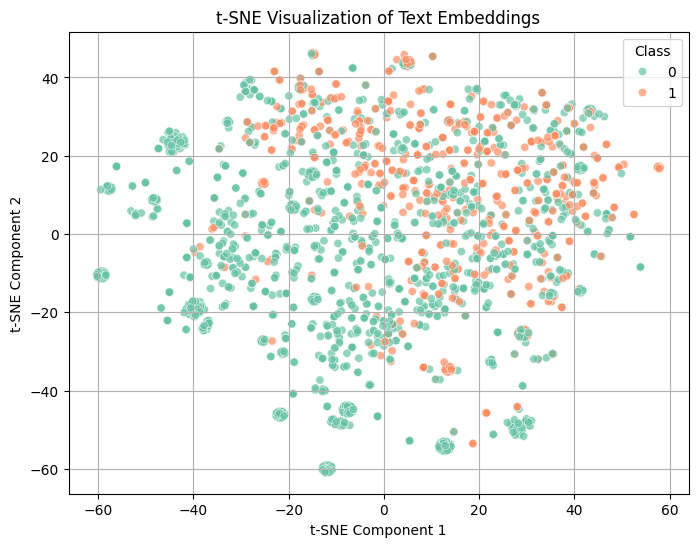

In [ ]:
model.eval()

embeddings = []
labels = []

with torch.no_grad():
    for batch in train_loader:
        input_ids = batch['input_ids'].to(device)
        attention_mask = batch['attention_mask'].to(device)
        labels_batch = batch['labels']

        bert_outputs = BiomedNLP(input_ids=input_ids, attention_mask=attention_mask)
        bert_embeds = bert_outputs.last_hidden_state  # [batch_size, seq_len, 768]

        # Mean pooling
        pooled = bert_embeds.mean(dim=1)  # [batch_size, 768]

        embeddings.append(pooled.cpu().numpy())
        labels.extend(labels_batch.cpu().numpy())

labels = np.array(labels)
embeddings = np.vstack(embeddings)
labels = np.array(labels)

tsne = TSNE(n_components=2, perplexity=30, random_state=42)
tsne_result = tsne.fit_transform(embeddings)

plt.figure(figsize=(8, 6))
sns.scatterplot(
    x=tsne_result[:, 0],
    y=tsne_result[:, 1],
    hue=labels,
    palette="Set2",
    alpha=0.7
)
plt.title("t-SNE Visualization of Text Embeddings")
plt.xlabel("t-SNE Component 1")
plt.ylabel("t-SNE Component 2")
plt.legend(title="Class")
plt.grid(True)
plt.show()

In [ ]:
learning_rate = 1e-3
num_epochs = 18
patience = 4
min_delta = 1e-4
monitor = "val_loss"

loss_function = nn.BCEWithLogitsLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min' if monitor == "val_loss" else 'max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-7
)

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []
val_f1s = []

best_metric = float('inf') if monitor == "val_loss" else -float('inf')
best_epoch = -1
stalled_epochs = 0
best_state = None

with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_model(model, train_loader, optimizer, loss_function, device)
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)

        val_loss, val_acc, val_f1 = evaluate_model(model, val_loader, loss_function, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)
        val_f1s.append(val_f1)

        current_metric = val_loss if monitor == "val_loss" else val_f1
        scheduler.step(current_metric)

        # Early stopping logic
        improved = False
        if monitor == "val_loss":
            if current_metric < best_metric - min_delta:
                improved = True
        else:  # monitor == "val_f1"
            if current_metric > best_metric + min_delta:
                improved = True

        if improved:
            best_metric = current_metric
            best_epoch = epoch
            stalled_epochs = 0
            # save best weights (in-memory)
            best_state = {k: v.cpu().clone() for k, v in model.state_dict().items()}
        else:
            stalled_epochs += 1

        end_time = time.time()
        epoch_duration = end_time - start_time
        pbar.set_description(
            f"Epoch {epoch+1}/{num_epochs} - Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, "
            f"Train Acc: {train_acc:.2%}, Val Acc: {val_acc:.2%}, Val F1: {val_f1:.2%}, Time: {epoch_duration / 60:.2f} min"
        )
        pbar.update(1)

        if stalled_epochs >= patience:
            print(f"\nEarly stopping triggered (no improvement in {patience} epochs).")
            break

if best_state is not None:
    model.load_state_dict(best_state)
    print(f"Restored best model from epoch {best_epoch+1} with best {monitor} = {best_metric:.6f}.")
else:
    print("No best state recorded (no improvement during training).")

Training Progress:   0%|          | 0/18 [00:00<?, ?epoch/s]/usr/local/lib/python3.11/dist-packages/torch/nn/modules/module.py:1750: FutureWarning: `encoder_attention_mask` is deprecated and will be removed in version 4.55.0 for `BertSdpaSelfAttention.forward`.
  return forward_call(*args, **kwargs)
Epoch 1/18 - Train Loss: 1.0426, Val Loss: 0.6053, Train Acc: 57.23%, Val Acc: 61.15%, Val F1: 88.07%, Time: 4.92 min:   6%|▌         | 1/18 [04:55<1:23:35, 295.05s/epoch]/usr/local/lib/python3.11/dist-packages/torch/nn/modules/module.py:1750: FutureWarning: `encoder_attention_mask` is deprecated and will be removed in version 4.55.0 for `BertSdpaSelfAttention.forward`.
  return forward_call(*args, **kwargs)
Epoch 2/18 - Train Loss: 0.9067, Val Loss: 0.6519, Train Acc: 62.28%, Val Acc: 64.69%, Val F1: 81.27%, Time: 4.85 min:  11%|█         | 2/18 [09:46<1:18:03, 292.71s/epoch]/usr/local/lib/python3.11/dist-packages/torch/nn/modules/module.py:1750: FutureWarning: `encoder_attention_mask` is 


Early stopping triggered (no improvement in 4 epochs).
Restored best model from epoch 1 with best val_loss = 0.605302.


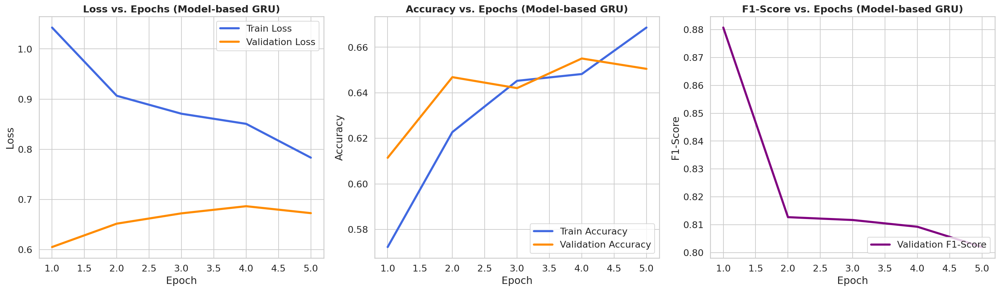

In [ ]:
# Set style and font size
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

# High-resolution figure
plt.figure(figsize=(20, 6), dpi=150)

# === 1. Loss Curve ===
plt.subplot(1, 3, 1)
sns.lineplot(x=range(1, len(train_losses) + 1), y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=range(1, len(val_losses) + 1), y=val_losses, label='Validation Loss', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='upper right')

# === 2. Accuracy Curve ===
plt.subplot(1, 3, 2)
sns.lineplot(x=range(1, len(train_accuracies) + 1), y=train_accuracies, label='Train Accuracy', color='royalblue')
sns.lineplot(x=range(1, len(val_accuracies) + 1), y=val_accuracies, label='Validation Accuracy', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

# === 3. F1-Score Curve ===
plt.subplot(1, 3, 3)
sns.lineplot(x=range(1, len(val_f1s) + 1), y=val_f1s, label='Validation F1-Score', color='purple')
plt.xlabel('Epoch')
plt.ylabel('F1-Score')
plt.title('F1-Score vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

# Layout adjustment and display
plt.tight_layout()
plt.show()

In [ ]:
BERT_DIM = 768
HIDDEN_DIM = 256
DROPOUT = 0.8

model = BiomedNLP_GRU_Attention(BERT_DIM, HIDDEN_DIM,num_layers=1, dropout_prob=DROPOUT).to(device)
print()
print(f"{count_parameters(model)} model parameters")
print()
print(model)


1710085 model parameters

BiomedNLP_GRU_Attention(
  (gru): GRU(768, 256, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=512, out_features=256, bias=True)
    (v): Linear(in_features=256, out_features=1, bias=False)
  )
  (fc): Linear(in_features=512, out_features=5, bias=True)
  (dropout): Dropout(p=0.8, inplace=False)
)


#### **Bidirectional GRU + BiomedNLP + Bahdanau Attention + SMOTE**

In [ ]:
X_train_np = X_train_tensor.cpu().numpy()
y_train_np = y_train_tensor.cpu().numpy()

original_text_map = {tuple(vec): text for vec, text in zip(X_train_np, X_train)}

smote = SMOTE(sampling_strategy='minority', random_state=42)
X_resampled_np, y_resampled_np = smote.fit_resample(X_train_np, y_train_np)

raw_text_resampled = []
for vec in X_resampled_np:
    key = tuple(vec)
    if key in original_text_map:
        raw_text_resampled.append(original_text_map[key])
    else:
        raw_text_resampled.append("[Synthetic sample - no raw text]")

X_resampled_tensor = torch.tensor(X_resampled_np, dtype=torch.float)
y_resampled_tensor = torch.tensor(y_resampled_np, dtype=torch.long)

train_dataset_smote = BiomedNLPDataset(raw_text_resampled, y_resampled_np, tokenizer)
val_dataset = BiomedNLPDataset(X_val.tolist(), y_val, tokenizer)
test_dataset = BiomedNLPDataset(X_test.tolist(), y_test, tokenizer)

train_loader_smote = DataLoader(train_dataset_smote, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)

In [ ]:
learning_rate = 1e-4
num_epochs = 18
patience = 4
min_delta = 1e-4
monitor = "val_loss"

loss_function = nn.BCEWithLogitsLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min' if monitor == "val_loss" else 'max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-7
)

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []
val_f1s = []

best_metric = float('inf') if monitor == "val_loss" else -float('inf')
best_epoch = -1
stalled_epochs = 0
best_state = None

with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_model(model, train_loader_smote, optimizer, loss_function, device)
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)

        val_loss, val_acc, val_f1 = evaluate_model(model, val_loader, loss_function, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)
        val_f1s.append(val_f1)

        current_metric = val_loss if monitor == "val_loss" else val_f1
        scheduler.step(current_metric)

        # Early stopping logic
        improved = False
        if monitor == "val_loss":
            if current_metric < best_metric - min_delta:
                improved = True
        else:  # monitor == "val_f1"
            if current_metric > best_metric + min_delta:
                improved = True

        if improved:
            best_metric = current_metric
            best_epoch = epoch
            stalled_epochs = 0
            # save best weights (in-memory)
            best_state = {k: v.cpu().clone() for k, v in model.state_dict().items()}
        else:
            stalled_epochs += 1

        end_time = time.time()
        epoch_duration = end_time - start_time
        pbar.set_description(
            f"Epoch {epoch+1}/{num_epochs} - Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, "
            f"Train Acc: {train_acc:.2%}, Val Acc: {val_acc:.2%}, Val F1: {val_f1:.2%}, Time: {epoch_duration / 60:.2f} min"
        )
        pbar.update(1)

        if stalled_epochs >= patience:
            print(f"\nEarly stopping triggered (no improvement in {patience} epochs).")
            break

if best_state is not None:
    model.load_state_dict(best_state)
    print(f"Restored best model from epoch {best_epoch+1} with best {monitor} = {best_metric:.6f}.")
else:
    print("No best state recorded (no improvement during training).")

Training Progress:   0%|          | 0/18 [00:00<?, ?epoch/s]/usr/local/lib/python3.11/dist-packages/torch/nn/modules/module.py:1750: FutureWarning: `encoder_attention_mask` is deprecated and will be removed in version 4.55.0 for `BertSdpaSelfAttention.forward`.
  return forward_call(*args, **kwargs)
Epoch 1/18 - Train Loss: 0.7987, Val Loss: 0.6092, Train Acc: 67.07%, Val Acc: 62.45%, Val F1: 83.53%, Time: 5.83 min:   6%|▌         | 1/18 [05:49<1:39:06, 349.81s/epoch]/usr/local/lib/python3.11/dist-packages/torch/nn/modules/module.py:1750: FutureWarning: `encoder_attention_mask` is deprecated and will be removed in version 4.55.0 for `BertSdpaSelfAttention.forward`.
  return forward_call(*args, **kwargs)
Epoch 2/18 - Train Loss: 0.6898, Val Loss: 0.6851, Train Acc: 71.30%, Val Acc: 64.74%, Val F1: 82.50%, Time: 5.80 min:  11%|█         | 2/18 [11:37<1:32:59, 348.75s/epoch]/usr/local/lib/python3.11/dist-packages/torch/nn/modules/module.py:1750: FutureWarning: `encoder_attention_mask` is 


Early stopping triggered (no improvement in 4 epochs).
Restored best model from epoch 1 with best val_loss = 0.609214.


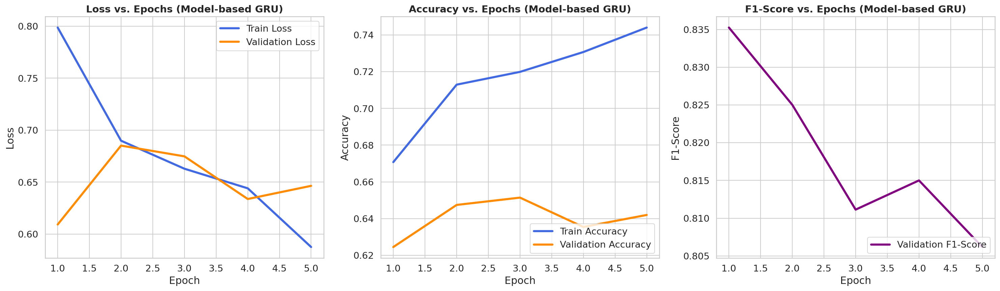

In [ ]:
# Set style and font size
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

# High-resolution figure
plt.figure(figsize=(20, 6), dpi=150)

# === 1. Loss Curve ===
plt.subplot(1, 3, 1)
sns.lineplot(x=range(1, len(train_losses) + 1), y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=range(1, len(val_losses) + 1), y=val_losses, label='Validation Loss', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='upper right')

# === 2. Accuracy Curve ===
plt.subplot(1, 3, 2)
sns.lineplot(x=range(1, len(train_accuracies) + 1), y=train_accuracies, label='Train Accuracy', color='royalblue')
sns.lineplot(x=range(1, len(val_accuracies) + 1), y=val_accuracies, label='Validation Accuracy', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

# === 3. F1-Score Curve ===
plt.subplot(1, 3, 3)
sns.lineplot(x=range(1, len(val_f1s) + 1), y=val_f1s, label='Validation F1-Score', color='purple')
plt.xlabel('Epoch')
plt.ylabel('F1-Score')
plt.title('F1-Score vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

# Layout adjustment and display
plt.tight_layout()
plt.show()

#### **Bidirectional GRU + BiomedNLP  + Bahdanau Attention + Weight Class**

In [ ]:
BATCH_SIZE = 16

# --- Load Data ---
train_dataset = BiomedNLPDataset(X_train.tolist(), y_train, tokenizer)
val_dataset = BiomedNLPDataset(X_val.tolist(), y_val, tokenizer)
test_dataset = BiomedNLPDataset(X_test.tolist(), y_test, tokenizer)

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)

# Combine the training and validation datasets (for test)
combined_dataset = ConcatDataset([train_dataset, val_dataset])
combined_loader = DataLoader(combined_dataset, batch_size=BATCH_SIZE, shuffle=True)

In [ ]:
class_weights = compute_class_weight('balanced', classes=np.unique(y_train_tensor.cpu().numpy()), y=y_train_tensor.cpu().numpy())
class_weights_tensor = torch.tensor(class_weights, dtype=torch.float).to(device)

In [ ]:
BERT_DIM = 768
HIDDEN_DIM = 256
DROPOUT = 0.5

model = BiomedNLP_GRU_Attention(BERT_DIM, HIDDEN_DIM,num_layers=1, dropout_prob=DROPOUT).to(device)
print()
print(f"{count_parameters(model)} model parameters")
print()
print(model)


1710085 model parameters

BiomedNLP_GRU_Attention(
  (gru): GRU(768, 256, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=512, out_features=256, bias=True)
    (v): Linear(in_features=256, out_features=1, bias=False)
  )
  (fc): Linear(in_features=512, out_features=5, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)


In [ ]:
learning_rate = 1e-3
num_epochs = 18
patience = 4
min_delta = 1e-4
monitor = "val_loss"

loss_function = nn.BCEWithLogitsLoss(class_weights_tensor)
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min' if monitor == "val_loss" else 'max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-7
)

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []
val_f1s = []

best_metric = float('inf') if monitor == "val_loss" else -float('inf')
best_epoch = -1
stalled_epochs = 0
best_state = None

with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_model(model, train_loader, optimizer, loss_function, device)
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)

        val_loss, val_acc, val_f1 = evaluate_model(model, val_loader, loss_function, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)
        val_f1s.append(val_f1)

        current_metric = val_loss if monitor == "val_loss" else val_f1
        scheduler.step(current_metric)

        # Early stopping logic
        improved = False
        if monitor == "val_loss":
            if current_metric < best_metric - min_delta:
                improved = True
        else:  # monitor == "val_f1"
            if current_metric > best_metric + min_delta:
                improved = True

        if improved:
            best_metric = current_metric
            best_epoch = epoch
            stalled_epochs = 0
            # save best weights (in-memory)
            best_state = {k: v.cpu().clone() for k, v in model.state_dict().items()}
        else:
            stalled_epochs += 1

        end_time = time.time()
        epoch_duration = end_time - start_time
        pbar.set_description(
            f"Epoch {epoch+1}/{num_epochs} - Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, "
            f"Train Acc: {train_acc:.2%}, Val Acc: {val_acc:.2%}, Val F1: {val_f1:.2%}, Time: {epoch_duration / 60:.2f} min"
        )
        pbar.update(1)

        if stalled_epochs >= patience:
            print(f"\nEarly stopping triggered (no improvement in {patience} epochs).")
            break

if best_state is not None:
    model.load_state_dict(best_state)
    print(f"Restored best model from epoch {best_epoch+1} with best {monitor} = {best_metric:.6f}.")
else:
    print("No best state recorded (no improvement during training).")

Training Progress:   0%|          | 0/18 [00:00<?, ?epoch/s]/usr/local/lib/python3.11/dist-packages/torch/nn/modules/module.py:1750: FutureWarning: `encoder_attention_mask` is deprecated and will be removed in version 4.55.0 for `BertSdpaSelfAttention.forward`.
  return forward_call(*args, **kwargs)
Epoch 1/18 - Train Loss: 0.9485, Val Loss: 0.6681, Train Acc: 58.73%, Val Acc: 62.18%, Val F1: 83.83%, Time: 4.82 min:   6%|▌         | 1/18 [04:49<1:22:00, 289.41s/epoch]/usr/local/lib/python3.11/dist-packages/torch/nn/modules/module.py:1750: FutureWarning: `encoder_attention_mask` is deprecated and will be removed in version 4.55.0 for `BertSdpaSelfAttention.forward`.
  return forward_call(*args, **kwargs)
Epoch 2/18 - Train Loss: 0.8008, Val Loss: 0.6835, Train Acc: 64.35%, Val Acc: 64.04%, Val F1: 80.19%, Time: 4.82 min:  11%|█         | 2/18 [09:38<1:17:07, 289.20s/epoch]/usr/local/lib/python3.11/dist-packages/torch/nn/modules/module.py:1750: FutureWarning: `encoder_attention_mask` is 


Early stopping triggered (no improvement in 4 epochs).
Restored best model from epoch 1 with best val_loss = 0.668124.


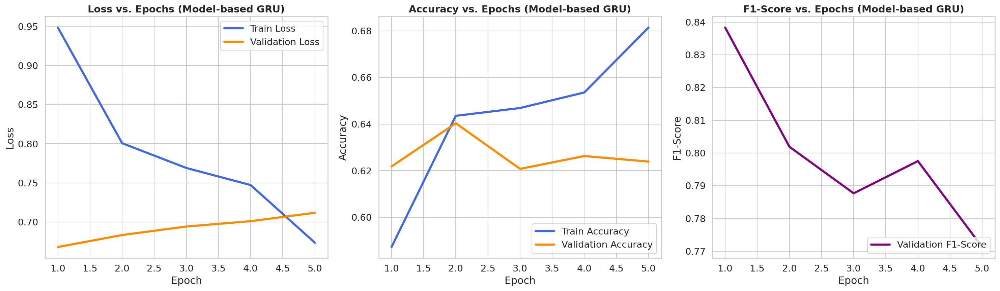

In [ ]:
# Set style and font size
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

# High-resolution figure
plt.figure(figsize=(20, 6), dpi=150)

# === 1. Loss Curve ===
plt.subplot(1, 3, 1)
sns.lineplot(x=range(1, len(train_losses) + 1), y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=range(1, len(val_losses) + 1), y=val_losses, label='Validation Loss', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='upper right')

# === 2. Accuracy Curve ===
plt.subplot(1, 3, 2)
sns.lineplot(x=range(1, len(train_accuracies) + 1), y=train_accuracies, label='Train Accuracy', color='royalblue')
sns.lineplot(x=range(1, len(val_accuracies) + 1), y=val_accuracies, label='Validation Accuracy', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

# === 3. F1-Score Curve ===
plt.subplot(1, 3, 3)
sns.lineplot(x=range(1, len(val_f1s) + 1), y=val_f1s, label='Validation F1-Score', color='purple')
plt.xlabel('Epoch')
plt.ylabel('F1-Score')
plt.title('F1-Score vs. Epochs (Model-based GRU)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

# Layout adjustment and display
plt.tight_layout()
plt.show()

#### **Bidirectional LSTM + BiomedNLP + Bahdanau Attention + No Resampling**

In [ ]:
BERT_DIM = 768
HIDDEN_DIM = 386
DROPOUT = 0.5

model = BiomedNLP_LSTM_Attention(BERT_DIM, HIDDEN_DIM, dropout_prob=DROPOUT).to(device)
print()
print(f"{count_parameters(model)} model parameters")
print()
print(model)


3872357 model parameters

BiomedNLP_LSTM_Attention(
  (lstm): LSTM(768, 386, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=772, out_features=386, bias=True)
    (v): Linear(in_features=386, out_features=1, bias=False)
  )
  (fc): Linear(in_features=772, out_features=5, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)


In [ ]:
# --- Load Data ---
train_dataset = BiomedNLPDataset(X_train.tolist(), y_train, tokenizer)
val_dataset = BiomedNLPDataset(X_val.tolist(), y_val, tokenizer)
test_dataset = BiomedNLPDataset(X_test.tolist(), y_test, tokenizer)

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)

# Combine the training and validation datasets (for test)
combined_dataset = ConcatDataset([train_dataset, val_dataset])
combined_loader = DataLoader(combined_dataset, batch_size=BATCH_SIZE, shuffle=True)

In [ ]:
learning_rate = 1e-3
num_epochs = 18
patience = 4
min_delta = 1e-4
monitor = "val_loss"

loss_function = nn.BCEWithLogitsLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min' if monitor == "val_loss" else 'max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-7
)

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []
val_f1s = []

best_metric = float('inf') if monitor == "val_loss" else -float('inf')
best_epoch = -1
stalled_epochs = 0
best_state = None

with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_model(model, train_loader, optimizer, loss_function, device)
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)

        val_loss, val_acc, val_f1 = evaluate_model(model, val_loader, loss_function, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)
        val_f1s.append(val_f1)

        current_metric = val_loss if monitor == "val_loss" else val_f1
        scheduler.step(current_metric)

        # Early stopping logic
        improved = False
        if monitor == "val_loss":
            if current_metric < best_metric - min_delta:
                improved = True
        else:  # monitor == "val_f1"
            if current_metric > best_metric + min_delta:
                improved = True

        if improved:
            best_metric = current_metric
            best_epoch = epoch
            stalled_epochs = 0
            # save best weights (in-memory)
            best_state = {k: v.cpu().clone() for k, v in model.state_dict().items()}
        else:
            stalled_epochs += 1

        end_time = time.time()
        epoch_duration = end_time - start_time
        pbar.set_description(
            f"Epoch {epoch+1}/{num_epochs} - Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, "
            f"Train Acc: {train_acc:.2%}, Val Acc: {val_acc:.2%}, Val F1: {val_f1:.2%}, Time: {epoch_duration / 60:.2f} min"
        )
        pbar.update(1)

        if stalled_epochs >= patience:
            print(f"\nEarly stopping triggered (no improvement in {patience} epochs).")
            break

if best_state is not None:
    model.load_state_dict(best_state)
    print(f"Restored best model from epoch {best_epoch+1} with best {monitor} = {best_metric:.6f}.")
else:
    print("No best state recorded (no improvement during training).")

Training Progress:   0%|          | 0/18 [00:00<?, ?epoch/s]/usr/local/lib/python3.11/dist-packages/torch/nn/modules/module.py:1750: FutureWarning: `encoder_attention_mask` is deprecated and will be removed in version 4.55.0 for `BertSdpaSelfAttention.forward`.
  return forward_call(*args, **kwargs)
Epoch 1/18 - Train Loss: 0.9734, Val Loss: 0.6754, Train Acc: 59.86%, Val Acc: 63.38%, Val F1: 84.98%, Time: 5.30 min:   6%|▌         | 1/18 [05:18<1:30:07, 318.08s/epoch]/usr/local/lib/python3.11/dist-packages/torch/nn/modules/module.py:1750: FutureWarning: `encoder_attention_mask` is deprecated and will be removed in version 4.55.0 for `BertSdpaSelfAttention.forward`.
  return forward_call(*args, **kwargs)
Epoch 2/18 - Train Loss: 0.8291, Val Loss: 0.6687, Train Acc: 64.47%, Val Acc: 62.30%, Val F1: 82.36%, Time: 5.28 min:  11%|█         | 2/18 [10:35<1:24:39, 317.46s/epoch]/usr/local/lib/python3.11/dist-packages/torch/nn/modules/module.py:1750: FutureWarning: `encoder_attention_mask` is 


Early stopping triggered (no improvement in 4 epochs).
Restored best model from epoch 3 with best val_loss = 0.600767.


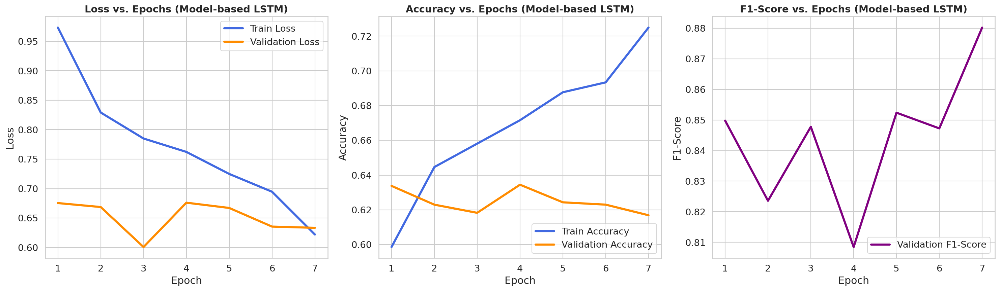

In [ ]:
# Set style and font size
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

# High-resolution figure
plt.figure(figsize=(20, 6), dpi=150)

# === 1. Loss Curve ===
plt.subplot(1, 3, 1)
sns.lineplot(x=range(1, len(train_losses) + 1), y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=range(1, len(val_losses) + 1), y=val_losses, label='Validation Loss', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss vs. Epochs (Model-based LSTM)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='upper right')

# === 2. Accuracy Curve ===
plt.subplot(1, 3, 2)
sns.lineplot(x=range(1, len(train_accuracies) + 1), y=train_accuracies, label='Train Accuracy', color='royalblue')
sns.lineplot(x=range(1, len(val_accuracies) + 1), y=val_accuracies, label='Validation Accuracy', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Epochs (Model-based LSTM)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

# === 3. F1-Score Curve ===
plt.subplot(1, 3, 3)
sns.lineplot(x=range(1, len(val_f1s) + 1), y=val_f1s, label='Validation F1-Score', color='purple')
plt.xlabel('Epoch')
plt.ylabel('F1-Score')
plt.title('F1-Score vs. Epochs (Model-based LSTM)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

# Layout adjustment and display
plt.tight_layout()
plt.show()

#### **Bidirectional LSTM + BiomedNLP + Bahdanau Attention + SMOTE**

In [ ]:
BERT_DIM = 768
HIDDEN_DIM = 386
DROPOUT = 0.5

model = BiomedNLP_LSTM_Attention(BERT_DIM, HIDDEN_DIM, dropout_prob=DROPOUT).to(device)
print()
print(f"{count_parameters(model)} model parameters")
print()
print(model)


3872357 model parameters

BiomedNLP_LSTM_Attention(
  (lstm): LSTM(768, 386, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=772, out_features=386, bias=True)
    (v): Linear(in_features=386, out_features=1, bias=False)
  )
  (fc): Linear(in_features=772, out_features=5, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)


In [ ]:
X_train_np = X_train_tensor.cpu().numpy()
y_train_np = y_train_tensor.cpu().numpy()

original_text_map = {tuple(vec): text for vec, text in zip(X_train_np, X_train)}

smote = SMOTE(sampling_strategy='minority', random_state=42)
X_resampled_np, y_resampled_np = smote.fit_resample(X_train_np, y_train_np)

raw_text_resampled = []
for vec in X_resampled_np:
    key = tuple(vec)
    if key in original_text_map:
        raw_text_resampled.append(original_text_map[key])
    else:
        raw_text_resampled.append("[Synthetic sample - no raw text]")

X_resampled_tensor = torch.tensor(X_resampled_np, dtype=torch.float)
y_resampled_tensor = torch.tensor(y_resampled_np, dtype=torch.long)

train_dataset_smote = BiomedNLPDataset(raw_text_resampled, y_resampled_np, tokenizer)
val_dataset = BiomedNLPDataset(X_val.tolist(), y_val, tokenizer)
test_dataset = BiomedNLPDataset(X_test.tolist(), y_test, tokenizer)

train_loader_smote = DataLoader(train_dataset_smote, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)

In [ ]:
learning_rate = 1e-3
num_epochs = 18
patience = 4
min_delta = 1e-4
monitor = "val_loss"

loss_function = nn.BCEWithLogitsLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min' if monitor == "val_loss" else 'max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-7
)

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []
val_f1s = []

best_metric = float('inf') if monitor == "val_loss" else -float('inf')
best_epoch = -1
stalled_epochs = 0
best_state = None

with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_model(model, train_loader_smote, optimizer, loss_function, device)
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)

        val_loss, val_acc, val_f1 = evaluate_model(model, val_loader, loss_function, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)
        val_f1s.append(val_f1)

        current_metric = val_loss if monitor == "val_loss" else val_f1
        scheduler.step(current_metric)

        # Early stopping logic
        improved = False
        if monitor == "val_loss":
            if current_metric < best_metric - min_delta:
                improved = True
        else:  # monitor == "val_f1"
            if current_metric > best_metric + min_delta:
                improved = True

        if improved:
            best_metric = current_metric
            best_epoch = epoch
            stalled_epochs = 0
            # save best weights (in-memory)
            best_state = {k: v.cpu().clone() for k, v in model.state_dict().items()}
        else:
            stalled_epochs += 1

        end_time = time.time()
        epoch_duration = end_time - start_time
        pbar.set_description(
            f"Epoch {epoch+1}/{num_epochs} - Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, "
            f"Train Acc: {train_acc:.2%}, Val Acc: {val_acc:.2%}, Val F1: {val_f1:.2%}, Time: {epoch_duration / 60:.2f} min"
        )
        pbar.update(1)

        if stalled_epochs >= patience:
            print(f"\nEarly stopping triggered (no improvement in {patience} epochs).")
            break

if best_state is not None:
    model.load_state_dict(best_state)
    print(f"Restored best model from epoch {best_epoch+1} with best {monitor} = {best_metric:.6f}.")
else:
    print("No best state recorded (no improvement during training).")

Training Progress:   0%|          | 0/18 [00:00<?, ?epoch/s]/usr/local/lib/python3.11/dist-packages/torch/nn/modules/module.py:1750: FutureWarning: `encoder_attention_mask` is deprecated and will be removed in version 4.55.0 for `BertSdpaSelfAttention.forward`.
  return forward_call(*args, **kwargs)
Epoch 1/18 - Train Loss: 0.8001, Val Loss: 0.6665, Train Acc: 66.26%, Val Acc: 62.33%, Val F1: 86.75%, Time: 6.30 min:   6%|▌         | 1/18 [06:17<1:47:04, 377.90s/epoch]/usr/local/lib/python3.11/dist-packages/torch/nn/modules/module.py:1750: FutureWarning: `encoder_attention_mask` is deprecated and will be removed in version 4.55.0 for `BertSdpaSelfAttention.forward`.
  return forward_call(*args, **kwargs)
Epoch 2/18 - Train Loss: 0.6781, Val Loss: 0.6621, Train Acc: 71.49%, Val Acc: 63.36%, Val F1: 81.02%, Time: 6.29 min:  11%|█         | 2/18 [12:35<1:40:39, 377.45s/epoch]/usr/local/lib/python3.11/dist-packages/torch/nn/modules/module.py:1750: FutureWarning: `encoder_attention_mask` is 


Early stopping triggered (no improvement in 4 epochs).
Restored best model from epoch 6 with best val_loss = 0.555024.


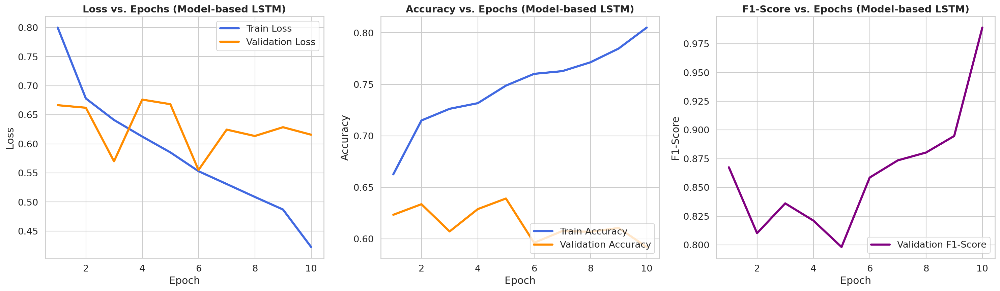

In [ ]:
# Set style and font size
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

# High-resolution figure
plt.figure(figsize=(20, 6), dpi=150)

# === 1. Loss Curve ===
plt.subplot(1, 3, 1)
sns.lineplot(x=range(1, len(train_losses) + 1), y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=range(1, len(val_losses) + 1), y=val_losses, label='Validation Loss', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss vs. Epochs (Model-based LSTM)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='upper right')

# === 2. Accuracy Curve ===
plt.subplot(1, 3, 2)
sns.lineplot(x=range(1, len(train_accuracies) + 1), y=train_accuracies, label='Train Accuracy', color='royalblue')
sns.lineplot(x=range(1, len(val_accuracies) + 1), y=val_accuracies, label='Validation Accuracy', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Epochs (Model-based LSTM)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

# === 3. F1-Score Curve ===
plt.subplot(1, 3, 3)
sns.lineplot(x=range(1, len(val_f1s) + 1), y=val_f1s, label='Validation F1-Score', color='purple')
plt.xlabel('Epoch')
plt.ylabel('F1-Score')
plt.title('F1-Score vs. Epochs (Model-based LSTM)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

# Layout adjustment and display
plt.tight_layout()
plt.show()

#### **Bidirectional LSTM + BiomedNLP + Bahdanau Attention + Weight Class**

In [ ]:
BERT_DIM = 768
HIDDEN_DIM = 386
DROPOUT = 0.5

model = BiomedNLP_LSTM_Attention(BERT_DIM, HIDDEN_DIM, dropout_prob=DROPOUT).to(device)
print()
print(f"{count_parameters(model)} model parameters")
print()
print(model)


3872357 model parameters

BiomedNLP_LSTM_Attention(
  (lstm): LSTM(768, 386, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=772, out_features=386, bias=True)
    (v): Linear(in_features=386, out_features=1, bias=False)
  )
  (fc): Linear(in_features=772, out_features=5, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)


In [ ]:
BATCH_SIZE = 16

# --- Load Data ---
train_dataset = BiomedNLPDataset(X_train.tolist(), y_train, tokenizer)
val_dataset = BiomedNLPDataset(X_val.tolist(), y_val, tokenizer)
test_dataset = BiomedNLPDataset(X_test.tolist(), y_test, tokenizer)

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)

# Combine the training and validation datasets (for test)
combined_dataset = ConcatDataset([train_dataset, val_dataset])
combined_loader = DataLoader(combined_dataset, batch_size=BATCH_SIZE, shuffle=True)

class_weights = compute_class_weight('balanced', classes=np.unique(y_train_tensor.cpu().numpy()), y=y_train_tensor.cpu().numpy())
class_weights_tensor = torch.tensor(class_weights, dtype=torch.float).to(device)

In [ ]:
learning_rate = 1e-3
num_epochs = 18
patience = 4
min_delta = 1e-4
monitor = "val_loss"

loss_function = nn.BCEWithLogitsLoss(class_weights_tensor)
optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min' if monitor == "val_loss" else 'max',
    factor=0.5,
    patience=2,
    verbose=True,
    min_lr=1e-7
)

train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []
val_f1s = []

best_metric = float('inf') if monitor == "val_loss" else -float('inf')
best_epoch = -1
stalled_epochs = 0
best_state = None

with tqdm(total=num_epochs, desc="Training Progress", unit="epoch") as pbar:
    for epoch in range(num_epochs):
        start_time = time.time()

        train_loss, train_acc = train_model(model, train_loader_smote, optimizer, loss_function, device)
        train_losses.append(train_loss)
        train_accuracies.append(train_acc)

        val_loss, val_acc, val_f1 = evaluate_model(model, val_loader, loss_function, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)
        val_f1s.append(val_f1)

        current_metric = val_loss if monitor == "val_loss" else val_f1
        scheduler.step(current_metric)

        # Early stopping logic
        improved = False
        if monitor == "val_loss":
            if current_metric < best_metric - min_delta:
                improved = True
        else:  # monitor == "val_f1"
            if current_metric > best_metric + min_delta:
                improved = True

        if improved:
            best_metric = current_metric
            best_epoch = epoch
            stalled_epochs = 0
            # save best weights (in-memory)
            best_state = {k: v.cpu().clone() for k, v in model.state_dict().items()}
        else:
            stalled_epochs += 1

        end_time = time.time()
        epoch_duration = end_time - start_time
        pbar.set_description(
            f"Epoch {epoch+1}/{num_epochs} - Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, "
            f"Train Acc: {train_acc:.2%}, Val Acc: {val_acc:.2%}, Val F1: {val_f1:.2%}, Time: {epoch_duration / 60:.2f} min"
        )
        pbar.update(1)

        if stalled_epochs >= patience:
            print(f"\nEarly stopping triggered (no improvement in {patience} epochs).")
            break

if best_state is not None:
    model.load_state_dict(best_state)
    print(f"Restored best model from epoch {best_epoch+1} with best {monitor} = {best_metric:.6f}.")
else:
    print("No best state recorded (no improvement during training).")

Training Progress:   0%|          | 0/18 [00:00<?, ?epoch/s]/usr/local/lib/python3.11/dist-packages/torch/nn/modules/module.py:1750: FutureWarning: `encoder_attention_mask` is deprecated and will be removed in version 4.55.0 for `BertSdpaSelfAttention.forward`.
  return forward_call(*args, **kwargs)
Epoch 1/18 - Train Loss: 0.6896, Val Loss: 0.6957, Train Acc: 64.71%, Val Acc: 59.96%, Val F1: 82.11%, Time: 6.29 min:   6%|▌         | 1/18 [06:17<1:46:56, 377.44s/epoch]/usr/local/lib/python3.11/dist-packages/torch/nn/modules/module.py:1750: FutureWarning: `encoder_attention_mask` is deprecated and will be removed in version 4.55.0 for `BertSdpaSelfAttention.forward`.
  return forward_call(*args, **kwargs)
Epoch 2/18 - Train Loss: 0.5661, Val Loss: 0.6936, Train Acc: 70.38%, Val Acc: 64.31%, Val F1: 78.59%, Time: 6.27 min:  11%|█         | 2/18 [12:33<1:40:28, 376.76s/epoch]/usr/local/lib/python3.11/dist-packages/torch/nn/modules/module.py:1750: FutureWarning: `encoder_attention_mask` is 

In [ ]:
# Set style and font size
sns.set(style="whitegrid", font_scale=1.2, rc={"lines.linewidth": 3})

# High-resolution figure
plt.figure(figsize=(20, 6), dpi=150)

# === 1. Loss Curve ===
plt.subplot(1, 3, 1)
sns.lineplot(x=range(1, len(train_losses) + 1), y=train_losses, label='Train Loss', color='royalblue')
sns.lineplot(x=range(1, len(val_losses) + 1), y=val_losses, label='Validation Loss', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss vs. Epochs (Model-based LSTM)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='upper right')

# === 2. Accuracy Curve ===
plt.subplot(1, 3, 2)
sns.lineplot(x=range(1, len(train_accuracies) + 1), y=train_accuracies, label='Train Accuracy', color='royalblue')
sns.lineplot(x=range(1, len(val_accuracies) + 1), y=val_accuracies, label='Validation Accuracy', color='darkorange')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Epochs (Model-based LSTM)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

# === 3. F1-Score Curve ===
plt.subplot(1, 3, 3)
sns.lineplot(x=range(1, len(val_f1s) + 1), y=val_f1s, label='Validation F1-Score', color='purple')
plt.xlabel('Epoch')
plt.ylabel('F1-Score')
plt.title('F1-Score vs. Epochs (Model-based LSTM)', fontsize=14, weight='bold')
plt.legend(frameon=True, loc='lower right')

# Layout adjustment and display
plt.tight_layout()
plt.show()

# **IV. Test Phase**

## **1.Model-based LSTM and GRU with embeddings learn from scratch**

In [ ]:
def train_and_evaluate(model_name, model, train_loader, test_loader, word_to_index, criterion, device, patience=4, num_epochs=30):
    print(f"\n🔷 Training {model_name} model")
    print(model)
    num_params = count_parameters(model)
    print(f"Total trainable parameters: {num_params}\n")

    # --- Set learning rate based on model type ---
    if model_name.upper() == "LSTM":
        learning_rate = 1e-3
    elif model_name.upper() == "GRU":
        learning_rate = 1e-4
    else:
        learning_rate = 1e-3

    best_model_path = f"best_{model_name}.pth"

    optimizer = torch.optim.RMSprop(model.parameters(), lr=learning_rate)
    loss_function = criterion

    # --- Tracking ---
    train_losses, test_losses = [], []
    train_accuracies, test_accuracies = [], []
    test_f1s, test_bal_accs, test_recalls, test_precisions = [], [], [], []

    best_bal_acc = 0
    patience_counter = 0

    with tqdm(total=num_epochs, desc=f"{model_name} Training", unit="epoch") as epoch_pbar:
        for epoch in range(num_epochs):
            start_time = time.time()

            train_loss, train_acc = train_epoch(model, train_loader, optimizer, loss_function, device)
            test_loss, test_acc, test_f1, test_bal_acc, test_recall, test_precision = test_epoch(
                model, test_loader, loss_function, device
            )

            train_losses.append(train_loss)
            train_accuracies.append(train_acc)
            test_losses.append(test_loss)
            test_accuracies.append(test_acc)
            test_f1s.append(test_f1)
            test_bal_accs.append(test_bal_acc)
            test_recalls.append(test_recall)
            test_precisions.append(test_precision)

            # Early stopping
            if test_bal_acc > best_bal_acc:
                best_bal_acc = test_bal_acc
                torch.save(model.state_dict(), best_model_path)
                patience_counter = 0
            else:
                patience_counter += 1
                if patience_counter >= patience:
                    print(f"\nEarly stopping for {model_name} at epoch {epoch+1}")
                    break

            epoch_duration = time.time() - start_time
            epoch_pbar.set_postfix({
                "Train Loss": f"{train_loss:.4f}",
                "Test Loss": f"{test_loss:.4f}",
                "Train Acc": f"{train_acc:.2%}",
                "Test Bal Acc": f"{test_bal_acc:.2%}",
                "F1": f"{test_f1:.2%}",
                "Prec": f"{test_precision:.2%}",
                "Recall": f"{test_recall:.2%}",
                "Time": f"{epoch_duration/60:.2f}m"
            })
            epoch_pbar.update(1)

    # --- Load best model ---
    model.load_state_dict(torch.load(best_model_path))
    model.eval()

    # --- Final evaluation ---
    final_test_loss, final_test_acc, final_test_f1, final_test_bal_acc, final_test_recall, final_test_precision = test_epoch(
        model, test_loader, loss_function, device
    )

    # --- Report ---
    print(f"\n✅ Final Evaluation for {model_name}:")
    print(f"Test Loss         : {final_test_loss:.4f}")
    print(f"Test Accuracy     : {final_test_acc:.2%}")
    print(f"F1 Score          : {final_test_f1:.2%}")
    print(f"Balanced Accuracy : {final_test_bal_acc:.2%}")
    print(f"Precision         : {final_test_precision:.2%}")
    print(f"Recall            : {final_test_recall:.2%}\n")

#### **a. Without SMOTE and Weight Class**

In [ ]:
batch_size = 16
train_dataset = TextDataset(X_train_tensor, y_train, raw_text_data=X_train)
val_dataset = TextDataset(X_val_tensor, y_val, raw_text_data=X_val)
test_dataset = TextDataset(X_test_tensor, y_test, raw_text_data=X_test)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

combined_dataset = ConcatDataset([train_dataset, val_dataset])
combined_loader = DataLoader(combined_dataset, batch_size=batch_size, shuffle=True)

print(f"Training set size: {len(train_dataset)}")
print(f"Validation set size: {len(val_dataset)}")
print(f"Test set size: {len(test_dataset)}")
print(f"Combined dataset size: {len(combined_dataset)}")

NUM_CLASSES = len(torch.unique(y_train_tensor))
VOCAB_SIZE = len(word_to_index)
print(NUM_CLASSES)

In [ ]:
# --- Loaders assumed already defined ---
# combined_loader for training, test_loader for evaluation

criterion = nn.BCEWithLogitsLoss()

# --- Run for LSTM ---
lstm_model = LSTM_Model(
    vocab_size=len(word_to_index),
    embedding_dim=350,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.4
).to(device)

train_and_evaluate("LSTM", lstm_model, combined_loader, test_loader, word_to_index, criterion, device, patience=7, num_epochs=20)

In [ ]:
# --- Run for GRU ---
gru_model = GRU_Model(
    vocab_size=len(word_to_index),
    embedding_dim=350,
    hidden_dim=480,
    num_layers=1,
    dropout_prob=0.2
).to(device)

train_and_evaluate("GRU", gru_model, combined_loader, test_loader, word_to_index, criterion, device, patience=7, num_epochs=20)


🔷 Training GRU model
GRU_Model(
  (embedding): Embedding(40867, 350)
  (gru): GRU(350, 480, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.2, inplace=False)
  (fc): Linear(in_features=960, out_features=1, bias=True)
)
Total trainable parameters: 16700571



GRU Training:  80%|████████  | 16/20 [03:57<00:59, 14.84s/epoch, Train Loss=0.1572, Test Loss=0.7244, Train Acc=91.10%, Test Bal Acc=70.69%, F1=59.39%, Prec=62.59%, Recall=56.49%, Time=0.20m]


Early stopping for GRU at epoch 17



✅ Final Evaluation for GRU:
Test Loss         : 0.6480
Test Accuracy     : 77.31%
F1 Score          : 62.21%
Balanced Accuracy : 72.64%
Precision         : 64.14%
Recall            : 60.39%



#### **b. With SMOTE**

In [ ]:
BATCH_SIZE = 16

X_train_val_tensor = torch.cat([X_train_tensor, X_val_tensor], dim=0)
y_train_val_tensor = torch.cat([y_train_tensor, y_val_tensor], dim=0)

X_train_val_np = X_train_val_tensor.cpu().numpy()
y_train_val_np = y_train_val_tensor.cpu().numpy()

original_text_map = {
    tuple(vec): text for vec, text in zip(X_train_val_np, list(X_train) + list(X_val))
}

smote = SMOTE(sampling_strategy='minority', random_state=42)
X_resampled_np, y_resampled_np = smote.fit_resample(X_train_val_np, y_train_val_np)

raw_text_resampled = [
    original_text_map.get(tuple(vec), "[Synthetic sample - no raw text]")
    for vec in X_resampled_np
]

X_resampled_tensor = torch.tensor(X_resampled_np, dtype=torch.float)
y_resampled_tensor = torch.tensor(y_resampled_np, dtype=torch.long)

train_dataset_smote = TextDataset(
    X_resampled_tensor,
    y_resampled_tensor,
    raw_text_data=raw_text_resampled
)

train_loader_smote = DataLoader(
    train_dataset_smote,
    batch_size=BATCH_SIZE,
    shuffle=True,
    collate_fn=custom_collate_fn
)

X_test_tensor = X_test_tensor.to(torch.float)  # already preprocessed
y_test_tensor = y_test_tensor.to(torch.long)

test_dataset = TextDataset(X_test_tensor, y_test_tensor)
test_loader = DataLoader(
    test_dataset,
    batch_size=BATCH_SIZE,
    shuffle=False,
    collate_fn=custom_collate_fn
)

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


In [ ]:
# --- Loaders assumed already defined ---
# combined_loader for training, test_loader for evaluation

criterion = nn.BCEWithLogitsLoss()

# --- Run for LSTM ---
lstm_model = LSTM_Model(
    vocab_size=len(word_to_index),
    embedding_dim=450,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.2
).to(device)

train_and_evaluate("LSTM", lstm_model, train_loader_smote, test_loader, word_to_index, criterion, device, patience=7, num_epochs=20)


🔷 Training LSTM model
LSTM_Model(
  (embedding): Embedding(40867, 450)
  (lstm): LSTM(450, 500, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.2, inplace=False)
  (fc): Linear(in_features=1000, out_features=1, bias=True)
)
Total trainable parameters: 22199151



LSTM Training:  60%|██████    | 12/20 [05:13<03:29, 26.14s/epoch, Train Loss=0.1118, Test Loss=0.9196, Train Acc=94.75%, Test Bal Acc=70.95%, F1=60.00%, Prec=56.25%, Recall=64.29%, Time=0.44m]


Early stopping for LSTM at epoch 13



✅ Final Evaluation for LSTM:
Test Loss         : 0.8283
Test Accuracy     : 74.70%
F1 Score          : 61.11%
Balanced Accuracy : 71.82%
Precision         : 58.24%
Recall            : 64.29%



In [ ]:
# --- Run for GRU ---
gru_model = GRU_Model(
    vocab_size=len(word_to_index),
    embedding_dim=350,
    hidden_dim=400,
    num_layers=1,
    dropout_prob=0.2
).to(device)

train_and_evaluate("GRU", gru_model, train_loader_smote, test_loader, word_to_index, criterion, device, patience=7)


🔷 Training GRU model
GRU_Model(
  (embedding): Embedding(40867, 350)
  (gru): GRU(350, 400, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.2, inplace=False)
  (fc): Linear(in_features=800, out_features=1, bias=True)
)
Total trainable parameters: 16109051



GRU Training:  60%|██████    | 18/30 [04:30<03:00, 15.05s/epoch, Train Loss=0.1336, Test Loss=0.6340, Train Acc=94.01%, Test Bal Acc=71.91%, F1=61.18%, Prec=62.00%, Recall=60.39%, Time=0.29m]


Early stopping for GRU at epoch 19



✅ Final Evaluation for GRU:
Test Loss         : 0.6538
Test Accuracy     : 79.32%
F1 Score          : 65.55%
Balanced Accuracy : 74.99%
Precision         : 67.59%
Recall            : 63.64%



#### **c. With Weight Class**

In [ ]:
batch_size = 16
train_dataset = TextDataset(X_train_tensor, y_train, raw_text_data=X_train)
val_dataset = TextDataset(X_val_tensor, y_val, raw_text_data=X_val)
test_dataset = TextDataset(X_test_tensor, y_test, raw_text_data=X_test)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

combined_dataset = ConcatDataset([train_dataset, val_dataset])
combined_loader = DataLoader(combined_dataset, batch_size=batch_size, shuffle=True)

print(f"Training set size: {len(train_dataset)}")
print(f"Validation set size: {len(val_dataset)}")
print(f"Test set size: {len(test_dataset)}")
print(f"Combined dataset size: {len(combined_dataset)}")

NUM_CLASSES = len(torch.unique(y_train_tensor))
VOCAB_SIZE = len(word_to_index)
print(NUM_CLASSES)

Training set size: 2321
Validation set size: 497
Test set size: 498
Combined dataset size: 2818
2


/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)


In [ ]:
# --- Loaders assumed already defined ---
# combined_loader for training, test_loader for evaluation

class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# --- Run for LSTM ---
lstm_model = LSTM_Model(
    vocab_size=len(word_to_index),
    embedding_dim=450,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.3
).to(device)

train_and_evaluate("LSTM", lstm_model, combined_loader, test_loader, word_to_index, criterion, device, patience=7, num_epochs=20)

Class weights: [0.69741587 1.76636225]

🔷 Training LSTM model
LSTM_Model(
  (embedding): Embedding(40867, 450)
  (lstm): LSTM(450, 500, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (fc): Linear(in_features=1000, out_features=1, bias=True)
)
Total trainable parameters: 22199151



LSTM Training:  40%|████      | 8/20 [02:42<04:03, 20.29s/epoch, Train Loss=0.2120, Test Loss=1.3865, Train Acc=93.28%, Test Bal Acc=73.26%, F1=62.94%, Prec=57.53%, Recall=69.48%, Time=0.29m]


Early stopping for LSTM at epoch 9



✅ Final Evaluation for LSTM:
Test Loss         : 0.9161
Test Accuracy     : 76.31%
F1 Score          : 63.80%
Balanced Accuracy : 73.88%
Precision         : 60.47%
Recall            : 67.53%



In [ ]:
# --- Run for GRU ---
gru_model = GRU_Model(
    vocab_size=len(word_to_index),
    embedding_dim=350,
    hidden_dim=400,
    num_layers=1,
    dropout_prob=0.2
).to(device)

train_and_evaluate("GRU", gru_model, combined_loader, test_loader, word_to_index, criterion, device, patience=7, num_epochs=20)


🔷 Training GRU model
GRU_Model(
  (embedding): Embedding(40867, 350)
  (gru): GRU(350, 400, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.2, inplace=False)
  (fc): Linear(in_features=800, out_features=1, bias=True)
)
Total trainable parameters: 16109051



GRU Training:  65%|██████▌   | 13/20 [02:40<01:26, 12.35s/epoch, Train Loss=0.2573, Test Loss=1.1499, Train Acc=92.93%, Test Bal Acc=73.57%, F1=63.46%, Prec=62.66%, Recall=64.29%, Time=0.17m]


Early stopping for GRU at epoch 14



✅ Final Evaluation for GRU:
Test Loss         : 0.9656
Test Accuracy     : 78.51%
F1 Score          : 67.08%
Balanced Accuracy : 76.38%
Precision         : 63.74%
Recall            : 70.78%



## **2.Model-based LSTM and GRU using word embeddings (Glove (300d) and Fasttext (300d))**

In [ ]:
EMBEDDING_DIM = 300
embedding_matrix_glove = load_glove_embeddings('/content/drive/MyDrive/glove.6B.300d.txt', word_to_index, EMBEDDING_DIM)
embedding_matrix_fasttext = load_fasttext_embeddings('/content/drive/MyDrive/cc.en.300.vec/cc.en.300.vec', word_to_index, EMBEDDING_DIM)

#### **a. Without SMOTE and Weight Class**

In [ ]:
batch_size = 16
train_dataset = TextDataset(X_train_tensor, y_train, raw_text_data=X_train)
val_dataset = TextDataset(X_val_tensor, y_val, raw_text_data=X_val)
test_dataset = TextDataset(X_test_tensor, y_test, raw_text_data=X_test)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

combined_dataset = ConcatDataset([train_dataset, val_dataset])
combined_loader = DataLoader(combined_dataset, batch_size=batch_size, shuffle=True)

print(f"Training set size: {len(train_dataset)}")
print(f"Validation set size: {len(val_dataset)}")
print(f"Test set size: {len(test_dataset)}")
print(f"Combined dataset size: {len(combined_dataset)}")

NUM_CLASSES = len(torch.unique(y_train_tensor))
VOCAB_SIZE = len(word_to_index)
print(NUM_CLASSES)

In [ ]:
# --- Loaders assumed already defined ---
# combined_loader for training, test_loader for evaluation

criterion = nn.BCEWithLogitsLoss()

# --- Run for LSTM ---
lstm_model = LSTM_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=356,
    num_layers=1,
    dropout_prob=0.5,
    embedding_weights=embedding_matrix_glove,
    freeze_embeddings=False
).to(device)

train_and_evaluate("LSTM", lstm_model, combined_loader, test_loader, word_to_index, criterion, device, patience=7, num_epochs=20)


🔷 Training LSTM model
LSTM_Model(
  (embedding): Embedding(40867, 300)
  (lstm): LSTM(300, 356, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.5, inplace=False)
  (fc): Linear(in_features=712, out_features=1, bias=True)
)
Total trainable parameters: 14134797



LSTM Training:  75%|███████▌  | 15/20 [02:38<00:52, 10.56s/epoch, Train Loss=0.1534, Test Loss=0.6938, Train Acc=90.69%, Test Bal Acc=71.04%, F1=60.00%, Prec=59.62%, Recall=60.39%, Time=0.16m]


Early stopping for LSTM at epoch 16



✅ Final Evaluation for LSTM:
Test Loss         : 0.5833
Test Accuracy     : 75.70%
F1 Score          : 65.92%
Balanced Accuracy : 75.78%
Precision         : 58.21%
Recall            : 75.97%



In [ ]:
# --- Run for GRU ---
gru_model = GRU_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.2,
    embedding_weights=embedding_matrix_glove,
    freeze_embeddings=False
).to(device)

train_and_evaluate("GRU", gru_model, combined_loader, test_loader, word_to_index, criterion, device, patience=7, num_epochs=20)


🔷 Training GRU model
GRU_Model(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 500, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.2, inplace=False)
  (fc): Linear(in_features=1000, out_features=1, bias=True)
)
Total trainable parameters: 14667101



GRU Training: 100%|██████████| 20/20 [04:03<00:00, 12.19s/epoch, Train Loss=0.1620, Test Loss=0.6544, Train Acc=90.76%, Test Bal Acc=70.48%, F1=59.03%, Prec=63.43%, Recall=55.19%, Time=0.20m]



✅ Final Evaluation for GRU:
Test Loss         : 0.6600
Test Accuracy     : 77.51%
F1 Score          : 65.85%
Balanced Accuracy : 75.47%
Precision         : 62.07%
Recall            : 70.13%



In [ ]:
# --- Loaders assumed already defined ---
# combined_loader for training, test_loader for evaluation

criterion = nn.BCEWithLogitsLoss()

# --- Run for LSTM ---
lstm_model = LSTM_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=356,
    num_layers=1,
    dropout_prob=0.5,
    embedding_weights=embedding_matrix_fasttext,
    freeze_embeddings=False
).to(device)

train_and_evaluate("LSTM", lstm_model, combined_loader, test_loader, word_to_index, criterion, device, patience=7, num_epochs=20)


🔷 Training LSTM model
LSTM_Model(
  (embedding): Embedding(40867, 300)
  (lstm): LSTM(300, 356, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.5, inplace=False)
  (fc): Linear(in_features=712, out_features=1, bias=True)
)
Total trainable parameters: 14134797



LSTM Training:  50%|█████     | 10/20 [01:45<01:45, 10.58s/epoch, Train Loss=0.1764, Test Loss=0.6335, Train Acc=90.77%, Test Bal Acc=71.14%, F1=60.19%, Prec=58.18%, Recall=62.34%, Time=0.16m]


Early stopping for LSTM at epoch 11



✅ Final Evaluation for LSTM:
Test Loss         : 0.5709
Test Accuracy     : 73.69%
F1 Score          : 61.58%
Balanced Accuracy : 72.17%
Precision         : 56.15%
Recall            : 68.18%



In [ ]:
# --- Run for GRU ---
gru_model = GRU_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.3,
    embedding_weights=embedding_matrix_fasttext,
    freeze_embeddings=False
).to(device)

train_and_evaluate("GRU", gru_model, combined_loader, test_loader, word_to_index, criterion, device, patience=7, num_epochs=20)


🔷 Training GRU model
GRU_Model(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 500, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (fc): Linear(in_features=1000, out_features=1, bias=True)
)
Total trainable parameters: 14667101



GRU Training:  85%|████████▌ | 17/20 [03:38<00:38, 12.84s/epoch, Train Loss=0.1536, Test Loss=0.6166, Train Acc=91.21%, Test Bal Acc=70.95%, F1=59.72%, Prec=64.18%, Recall=55.84%, Time=0.20m]


Early stopping for GRU at epoch 18



✅ Final Evaluation for GRU:
Test Loss         : 0.6372
Test Accuracy     : 79.12%
F1 Score          : 67.50%
Balanced Accuracy : 76.63%
Precision         : 65.06%
Recall            : 70.13%



#### **b. With SMOTE**

In [ ]:
X_train_val_tensor = torch.cat([X_train_tensor, X_val_tensor], dim=0)
y_train_val_tensor = torch.cat([y_train_tensor, y_val_tensor], dim=0)

X_train_val_np = X_train_val_tensor.cpu().numpy()
y_train_val_np = y_train_val_tensor.cpu().numpy()

original_text_map = {
    tuple(vec): text for vec, text in zip(X_train_val_np, list(X_train) + list(X_val))
}

smote = SMOTE(sampling_strategy='minority', random_state=42)
X_resampled_np, y_resampled_np = smote.fit_resample(X_train_val_np, y_train_val_np)

raw_text_resampled = [
    original_text_map.get(tuple(vec), "[Synthetic sample - no raw text]")
    for vec in X_resampled_np
]

X_resampled_tensor = torch.tensor(X_resampled_np, dtype=torch.float)
y_resampled_tensor = torch.tensor(y_resampled_np, dtype=torch.long)

train_dataset_smote = TextDataset(
    X_resampled_tensor,
    y_resampled_tensor,
    raw_text_data=raw_text_resampled
)

train_loader_smote = DataLoader(
    train_dataset_smote,
    batch_size=BATCH_SIZE,
    shuffle=True,
    collate_fn=custom_collate_fn
)

X_test_tensor = X_test_tensor.to(torch.float)  # already preprocessed
y_test_tensor = y_test_tensor.to(torch.long)

test_dataset = TextDataset(X_test_tensor, y_test_tensor)
test_loader = DataLoader(
    test_dataset,
    batch_size=BATCH_SIZE,
    shuffle=False,
    collate_fn=custom_collate_fn
)

In [ ]:
# --- Loaders assumed already defined ---
# combined_loader for training, test_loader for evaluation

criterion = nn.BCEWithLogitsLoss()

# --- Run for LSTM ---
lstm_model = LSTM_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=356,
    num_layers=1,
    dropout_prob=0.5,
    embedding_weights=embedding_matrix_glove,
    freeze_embeddings=False
).to(device)

train_and_evaluate("LSTM", lstm_model, train_loader_smote, test_loader, word_to_index, criterion, device, patience=5, num_epochs=20)


🔷 Training LSTM model
LSTM_Model(
  (embedding): Embedding(40867, 300)
  (lstm): LSTM(300, 356, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.5, inplace=False)
  (fc): Linear(in_features=712, out_features=1, bias=True)
)
Total trainable parameters: 14134797



LSTM Training:  95%|█████████▌| 19/20 [04:32<00:14, 14.36s/epoch, Train Loss=0.1116, Test Loss=0.9357, Train Acc=94.75%, Test Bal Acc=74.22%, F1=64.04%, Prec=56.44%, Recall=74.03%, Time=0.22m]


Early stopping for LSTM at epoch 20



✅ Final Evaluation for LSTM:
Test Loss         : 0.8719
Test Accuracy     : 75.10%
F1 Score          : 64.77%
Balanced Accuracy : 74.80%
Precision         : 57.58%
Recall            : 74.03%



In [ ]:
# --- Run for GRU ---
gru_model = GRU_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.3,
    embedding_weights=embedding_matrix_glove,
    freeze_embeddings=False
).to(device)

train_and_evaluate("GRU", gru_model, train_loader_smote, test_loader, word_to_index, criterion, device, patience=5, num_epochs=20)


🔷 Training GRU model
GRU_Model(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 500, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (fc): Linear(in_features=1000, out_features=1, bias=True)
)
Total trainable parameters: 14667101



GRU Training:  45%|████▌     | 9/20 [03:12<03:54, 21.34s/epoch, Train Loss=0.2404, Test Loss=0.5754, Train Acc=90.30%, Test Bal Acc=77.73%, F1=68.14%, Prec=59.42%, Recall=79.87%, Time=0.31m]


Early stopping for GRU at epoch 10



✅ Final Evaluation for GRU:
Test Loss         : 0.5481
Test Accuracy     : 77.91%
F1 Score          : 68.93%
Balanced Accuracy : 78.27%
Precision         : 61.00%
Recall            : 79.22%



In [ ]:
# --- Loaders assumed already defined ---
# combined_loader for training, test_loader for evaluation

criterion = nn.BCEWithLogitsLoss()

# --- Run for LSTM ---
lstm_model = LSTM_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=356,
    num_layers=1,
    dropout_prob=0.5,
    embedding_weights=embedding_matrix_fasttext,
    freeze_embeddings=False
).to(device)

train_and_evaluate("LSTM", lstm_model, train_loader_smote, test_loader, word_to_index, criterion, device, patience=5, num_epochs=20)


🔷 Training LSTM model
LSTM_Model(
  (embedding): Embedding(40867, 300)
  (lstm): LSTM(300, 356, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.5, inplace=False)
  (fc): Linear(in_features=712, out_features=1, bias=True)
)
Total trainable parameters: 14134797



LSTM Training:  90%|█████████ | 18/20 [04:54<00:32, 16.34s/epoch, Train Loss=0.1183, Test Loss=0.7391, Train Acc=94.68%, Test Bal Acc=73.81%, F1=63.66%, Prec=59.22%, Recall=68.83%, Time=0.23m]


Early stopping for LSTM at epoch 19



✅ Final Evaluation for LSTM:
Test Loss         : 0.7493
Test Accuracy     : 76.10%
F1 Score          : 67.22%
Balanced Accuracy : 76.97%
Precision         : 58.37%
Recall            : 79.22%



In [ ]:
# --- Run for GRU ---
gru_model = GRU_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.3,
    embedding_weights=embedding_matrix_fasttext,
    freeze_embeddings=False
).to(device)

train_and_evaluate("GRU", gru_model, train_loader_smote, test_loader, word_to_index, criterion, device, patience=5, num_epochs=20)


🔷 Training GRU model
GRU_Model(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 500, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (fc): Linear(in_features=1000, out_features=1, bias=True)
)
Total trainable parameters: 14667101



GRU Training:  75%|███████▌  | 15/20 [04:32<01:30, 18.16s/epoch, Train Loss=0.1436, Test Loss=0.6790, Train Acc=94.26%, Test Bal Acc=75.99%, F1=66.67%, Prec=64.63%, Recall=68.83%, Time=0.28m]


Early stopping for GRU at epoch 16



✅ Final Evaluation for GRU:
Test Loss         : 0.6000
Test Accuracy     : 80.52%
F1 Score          : 71.22%
Balanced Accuracy : 79.80%
Precision         : 65.57%
Recall            : 77.92%



#### **c. With Class Weighting**

In [ ]:
batch_size = 16
train_dataset = TextDataset(X_train_tensor, y_train, raw_text_data=X_train)
val_dataset = TextDataset(X_val_tensor, y_val, raw_text_data=X_val)
test_dataset = TextDataset(X_test_tensor, y_test, raw_text_data=X_test)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

combined_dataset = ConcatDataset([train_dataset, val_dataset])
combined_loader = DataLoader(combined_dataset, batch_size=batch_size, shuffle=True)

print(f"Training set size: {len(train_dataset)}")
print(f"Validation set size: {len(val_dataset)}")
print(f"Test set size: {len(test_dataset)}")
print(f"Combined dataset size: {len(combined_dataset)}")

NUM_CLASSES = len(torch.unique(y_train_tensor))
VOCAB_SIZE = len(word_to_index)
print(NUM_CLASSES)

In [ ]:
# --- Loaders assumed already defined ---
# combined_loader for training, test_loader for evaluation

class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# --- Run for LSTM ---
lstm_model = LSTM_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=356,
    num_layers=1,
    dropout_prob=0.5,
    embedding_weights=embedding_matrix_glove,
    freeze_embeddings=False
).to(device)

train_and_evaluate("LSTM", lstm_model, combined_loader, test_loader, word_to_index, criterion, device, patience=15)

Class weights: [0.69741587 1.76636225]

🔷 Training LSTM model
LSTM_Model(
  (embedding): Embedding(40867, 300)
  (lstm): LSTM(300, 356, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.5, inplace=False)
  (fc): Linear(in_features=712, out_features=1, bias=True)
)
Total trainable parameters: 14134797



LSTM Training: 100%|██████████| 30/30 [04:48<00:00,  9.60s/epoch, Train Loss=0.1916, Test Loss=1.6540, Train Acc=93.98%, Test Bal Acc=74.11%, F1=63.89%, Prec=55.83%, Recall=74.68%, Time=0.16m]



✅ Final Evaluation for LSTM:
Test Loss         : 1.6540
Test Accuracy     : 73.90%
F1 Score          : 63.89%
Balanced Accuracy : 74.11%
Precision         : 55.83%
Recall            : 74.68%



In [ ]:
# --- Run for GRU ---
gru_model = GRU_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.3,
    embedding_weights=embedding_matrix_glove,
    freeze_embeddings=False
).to(device)

train_and_evaluate("GRU", gru_model, combined_loader, test_loader, word_to_index, criterion, device, patience=15)


🔷 Training GRU model
GRU_Model(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 500, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (fc): Linear(in_features=1000, out_features=1, bias=True)
)
Total trainable parameters: 14667101



GRU Training:  70%|███████   | 21/30 [04:27<01:54, 12.72s/epoch, Train Loss=0.2484, Test Loss=0.9205, Train Acc=92.90%, Test Bal Acc=76.40%, F1=66.86%, Prec=60.96%, Recall=74.03%, Time=0.20m]


Early stopping for GRU at epoch 22



✅ Final Evaluation for GRU:
Test Loss         : 0.7243
Test Accuracy     : 76.51%
F1 Score          : 69.45%
Balanced Accuracy : 79.23%
Precision         : 58.08%
Recall            : 86.36%



In [ ]:
# --- Loaders assumed already defined ---
# combined_loader for training, test_loader for evaluation

class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# --- Run for LSTM ---
lstm_model = LSTM_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=356,
    num_layers=1,
    dropout_prob=0.5,
    embedding_weights=embedding_matrix_fasttext,
    freeze_embeddings=False
).to(device)

train_and_evaluate("LSTM", lstm_model, combined_loader, test_loader, word_to_index, criterion, device, patience=7, num_epochs=20)

Class weights: [0.69741587 1.76636225]

🔷 Training LSTM model
LSTM_Model(
  (embedding): Embedding(40867, 300)
  (lstm): LSTM(300, 356, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.5, inplace=False)
  (fc): Linear(in_features=712, out_features=1, bias=True)
)
Total trainable parameters: 14134797



LSTM Training: 100%|██████████| 20/20 [03:33<00:00, 10.69s/epoch, Train Loss=0.2203, Test Loss=1.3375, Train Acc=93.47%, Test Bal Acc=75.69%, F1=65.60%, Prec=55.66%, Recall=79.87%, Time=0.16m]



✅ Final Evaluation for LSTM:
Test Loss         : 1.2965
Test Accuracy     : 75.70%
F1 Score          : 65.92%
Balanced Accuracy : 75.78%
Precision         : 58.21%
Recall            : 75.97%



In [ ]:
# --- Run for GRU ---
gru_model = GRU_Model(
    vocab_size=VOCAB_SIZE,
    embedding_dim=EMBEDDING_DIM,
    hidden_dim=500,
    num_layers=1,
    dropout_prob=0.3,
    embedding_weights=embedding_matrix_fasttext,
    freeze_embeddings=False
).to(device)

train_and_evaluate("GRU", gru_model, combined_loader, test_loader, word_to_index, criterion, device, patience=7, num_epochs=20)


🔷 Training GRU model
GRU_Model(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 500, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (fc): Linear(in_features=1000, out_features=1, bias=True)
)
Total trainable parameters: 14667101



GRU Training:  55%|█████▌    | 11/20 [02:25<01:59, 13.24s/epoch, Train Loss=0.2759, Test Loss=0.8011, Train Acc=92.64%, Test Bal Acc=75.62%, F1=66.06%, Prec=62.43%, Recall=70.13%, Time=0.20m]


Early stopping for GRU at epoch 12



✅ Final Evaluation for GRU:
Test Loss         : 0.7397
Test Accuracy     : 78.92%
F1 Score          : 71.07%
Balanced Accuracy : 80.26%
Precision         : 61.72%
Recall            : 83.77%



## **3.Model-based LSTM and GRU + Bahdanau attention using word embeddings (Glove (300d) and Fasttext (300d))**

#### **a. Without SMOTE and Weight Class**

In [ ]:
batch_size = 16
train_dataset = TextDataset(X_train_tensor, y_train, raw_text_data=X_train)
val_dataset = TextDataset(X_val_tensor, y_val, raw_text_data=X_val)
test_dataset = TextDataset(X_test_tensor, y_test, raw_text_data=X_test)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

combined_dataset = ConcatDataset([train_dataset, val_dataset])
combined_loader = DataLoader(combined_dataset, batch_size=batch_size, shuffle=True)

print(f"Training set size: {len(train_dataset)}")
print(f"Validation set size: {len(val_dataset)}")
print(f"Test set size: {len(test_dataset)}")
print(f"Combined dataset size: {len(combined_dataset)}")

NUM_CLASSES = len(torch.unique(y_train_tensor))
VOCAB_SIZE = len(word_to_index)
print(NUM_CLASSES)

Training set size: 2321
Validation set size: 497
Test set size: 498
Combined dataset size: 2818
2


/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)


In [ ]:
# --- Loaders assumed already defined ---
# combined_loader for training, test_loader for evaluation

criterion = nn.BCEWithLogitsLoss()

# --- Run for LSTM ---
lstm_model = LSTM_BahdanauAttention(embedding_matrix=embedding_matrix_glove, hidden_dim=400, num_layers=1, dropout_prob=0.5).to(device)

train_and_evaluate("LSTM", lstm_model, combined_loader, test_loader, word_to_index, criterion, device, patience=7, num_epochs=20)


🔷 Training LSTM model
LSTM_BahdanauAttention(
  (embedding): Embedding(40867, 300)
  (lstm): LSTM(300, 400, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=800, out_features=400, bias=True)
    (v): Linear(in_features=400, out_features=1, bias=False)
  )
  (dropout): Dropout(p=0.5, inplace=False)
  (fc): Linear(in_features=800, out_features=1, bias=True)
)
Total trainable parameters: 14828101



LSTM Training:  45%|████▌     | 9/20 [02:12<02:41, 14.72s/epoch, Train Loss=0.1613, Test Loss=0.4260, Train Acc=91.15%, Test Bal Acc=82.54%, F1=73.95%, Prec=65.02%, Recall=85.71%, Time=0.22m]


Early stopping for LSTM at epoch 10



✅ Final Evaluation for LSTM:
Test Loss         : 0.4100
Test Accuracy     : 83.13%
F1 Score          : 76.80%
Balanced Accuracy : 85.10%
Precision         : 66.83%
Recall            : 90.26%



In [ ]:
# --- Run for GRU ---
gru_model = GRU_BahdanauAttention(embedding_matrix=embedding_matrix_fasttext, hidden_dim=400, num_layers=1, dropout_prob=0.5).to(device)

train_and_evaluate("GRU", gru_model, combined_loader, test_loader, word_to_index, criterion, device, patience=7, num_epochs=20)


🔷 Training GRU model
GRU_Model(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 500, batch_first=True, bidirectional=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (fc): Linear(in_features=1000, out_features=1, bias=True)
)
Total trainable parameters: 14667101



GRU Training:  90%|█████████ | 18/20 [03:51<00:25, 12.85s/epoch, Train Loss=0.1684, Test Loss=0.6951, Train Acc=90.72%, Test Bal Acc=71.89%, F1=61.11%, Prec=65.67%, Recall=57.14%, Time=0.20m]


Early stopping for GRU at epoch 19



✅ Final Evaluation for GRU:
Test Loss         : 0.6104
Test Accuracy     : 77.11%
F1 Score          : 66.86%
Balanced Accuracy : 76.44%
Precision         : 60.53%
Recall            : 74.68%



In [ ]:
# --- Loaders assumed already defined ---
# combined_loader for training, test_loader for evaluation

# --- Run for LSTM ---
lstm_model = LSTM_BahdanauAttention(embedding_matrix=embedding_matrix_fasttext, hidden_dim=400, num_layers=1, dropout_prob=0.5).to(device)

train_and_evaluate("LSTM", lstm_model, combined_loader, test_loader, word_to_index, criterion, device, patience=7, num_epochs=20)


🔷 Training LSTM model
LSTM_BahdanauAttention(
  (embedding): Embedding(40867, 300)
  (lstm): LSTM(300, 400, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=800, out_features=400, bias=True)
    (v): Linear(in_features=400, out_features=1, bias=False)
  )
  (dropout): Dropout(p=0.5, inplace=False)
  (fc): Linear(in_features=800, out_features=1, bias=True)
)
Total trainable parameters: 14828101



LSTM Training:  75%|███████▌  | 15/20 [03:44<01:14, 14.96s/epoch, Train Loss=0.1393, Test Loss=0.8595, Train Acc=90.62%, Test Bal Acc=68.99%, F1=56.95%, Prec=59.57%, Recall=54.55%, Time=0.24m]


Early stopping for LSTM at epoch 16



✅ Final Evaluation for LSTM:
Test Loss         : 0.6726
Test Accuracy     : 78.92%
F1 Score          : 65.80%
Balanced Accuracy : 75.23%
Precision         : 66.01%
Recall            : 65.58%



In [ ]:
# --- Run for GRU ---
gru_model = GRU_BahdanauAttention(embedding_matrix=embedding_matrix_fasttext, hidden_dim=400, num_layers=1, dropout_prob=0.5).to(device)

train_and_evaluate("GRU", gru_model, combined_loader, test_loader, word_to_index, criterion, device, patience=7, num_epochs=20)


🔷 Training GRU model
GRU_BahdanauAttention(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 400, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=800, out_features=400, bias=True)
    (v): Linear(in_features=400, out_features=1, bias=False)
  )
  (dropout): Dropout(p=0.5, inplace=False)
  (fc): Linear(in_features=800, out_features=1, bias=True)
)
Total trainable parameters: 14266501



GRU Training:  55%|█████▌    | 11/20 [02:22<01:56, 12.92s/epoch, Train Loss=0.1871, Test Loss=0.4063, Train Acc=90.42%, Test Bal Acc=80.46%, F1=72.39%, Prec=68.60%, Recall=76.62%, Time=0.18m]


Early stopping for GRU at epoch 12



✅ Final Evaluation for GRU:
Test Loss         : 0.3831
Test Accuracy     : 83.13%
F1 Score          : 75.58%
Balanced Accuracy : 83.49%
Precision         : 68.42%
Recall            : 84.42%



#### **b. With SMOTE**

In [ ]:
BATCH_SIZE = 16
X_train_val_tensor = torch.cat([X_train_tensor, X_val_tensor], dim=0)
y_train_val_tensor = torch.cat([y_train_tensor, y_val_tensor], dim=0)

X_train_val_np = X_train_val_tensor.cpu().numpy()
y_train_val_np = y_train_val_tensor.cpu().numpy()

original_text_map = {
    tuple(vec): text for vec, text in zip(X_train_val_np, list(X_train) + list(X_val))
}

smote = SMOTE(sampling_strategy='minority', random_state=42)
X_resampled_np, y_resampled_np = smote.fit_resample(X_train_val_np, y_train_val_np)

raw_text_resampled = [
    original_text_map.get(tuple(vec), "[Synthetic sample - no raw text]")
    for vec in X_resampled_np
]

X_resampled_tensor = torch.tensor(X_resampled_np, dtype=torch.float)
y_resampled_tensor = torch.tensor(y_resampled_np, dtype=torch.long)

train_dataset_smote = TextDataset(
    X_resampled_tensor,
    y_resampled_tensor,
    raw_text_data=raw_text_resampled
)

train_loader_smote = DataLoader(
    train_dataset_smote,
    batch_size=BATCH_SIZE,
    shuffle=True,
    collate_fn=custom_collate_fn
)

X_test_tensor = X_test_tensor.to(torch.float)  # already preprocessed
y_test_tensor = y_test_tensor.to(torch.long)

test_dataset = TextDataset(X_test_tensor, y_test_tensor)
test_loader = DataLoader(
    test_dataset,
    batch_size=BATCH_SIZE,
    shuffle=False,
    collate_fn=custom_collate_fn
)

/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)
/tmp/ipython-input-912490951.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.y = torch.tensor(y_data, dtype=torch.long)


In [ ]:
# --- Loaders assumed already defined ---
# combined_loader for training, test_loader for evaluation

criterion = nn.BCEWithLogitsLoss()

# --- Run for LSTM ---
lstm_model = LSTM_BahdanauAttention(embedding_matrix=embedding_matrix_glove, hidden_dim=400, num_layers=1, dropout_prob=0.5).to(device)

train_and_evaluate("LSTM", lstm_model, train_loader_smote, test_loader, word_to_index, criterion, device, patience=5, num_epochs=20)


🔷 Training LSTM model
LSTM_BahdanauAttention(
  (embedding): Embedding(40867, 300)
  (lstm): LSTM(300, 400, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=800, out_features=400, bias=True)
    (v): Linear(in_features=400, out_features=1, bias=False)
  )
  (dropout): Dropout(p=0.5, inplace=False)
  (fc): Linear(in_features=800, out_features=1, bias=True)
)
Total trainable parameters: 14828101



LSTM Training:  70%|███████   | 14/20 [04:31<01:56, 19.42s/epoch, Train Loss=0.1147, Test Loss=0.7333, Train Acc=94.46%, Test Bal Acc=79.09%, F1=70.52%, Prec=66.29%, Recall=75.32%, Time=0.30m]


Early stopping for LSTM at epoch 15



✅ Final Evaluation for LSTM:
Test Loss         : 0.5247
Test Accuracy     : 81.93%
F1 Score          : 73.53%
Balanced Accuracy : 81.72%
Precision         : 67.20%
Recall            : 81.17%



In [ ]:
# --- Run for GRU ---
gru_model = GRU_BahdanauAttention(embedding_matrix=embedding_matrix_glove, hidden_dim=400, num_layers=1, dropout_prob=0.5).to(device)

train_and_evaluate("GRU", gru_model, train_loader_smote, test_loader, word_to_index, criterion, device, patience=7, num_epochs=20)


🔷 Training GRU model
GRU_BahdanauAttention(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 400, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=800, out_features=400, bias=True)
    (v): Linear(in_features=400, out_features=1, bias=False)
  )
  (dropout): Dropout(p=0.5, inplace=False)
  (fc): Linear(in_features=800, out_features=1, bias=True)
)
Total trainable parameters: 14266501



GRU Training:  55%|█████▌    | 11/20 [02:49<02:18, 15.42s/epoch, Train Loss=0.1770, Test Loss=0.4629, Train Acc=92.55%, Test Bal Acc=74.85%, F1=65.51%, Prec=70.68%, Recall=61.04%, Time=0.24m]


Early stopping for GRU at epoch 12



✅ Final Evaluation for GRU:
Test Loss         : 0.4340
Test Accuracy     : 81.73%
F1 Score          : 73.78%
Balanced Accuracy : 82.11%
Precision         : 66.32%
Recall            : 83.12%



In [ ]:
# --- Loaders assumed already defined ---
# combined_loader for training, test_loader for evaluation

# --- Run for LSTM ---
lstm_model = LSTM_BahdanauAttention(embedding_matrix=embedding_matrix_fasttext, hidden_dim=400, num_layers=1, dropout_prob=0.5).to(device)

train_and_evaluate("LSTM", lstm_model, train_loader_smote, test_loader, word_to_index, criterion, device, patience=7, num_epochs=20)


🔷 Training LSTM model
LSTM_BahdanauAttention(
  (embedding): Embedding(40867, 300)
  (lstm): LSTM(300, 400, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=800, out_features=400, bias=True)
    (v): Linear(in_features=400, out_features=1, bias=False)
  )
  (dropout): Dropout(p=0.5, inplace=False)
  (fc): Linear(in_features=800, out_features=1, bias=True)
)
Total trainable parameters: 14828101



LSTM Training:  35%|███▌      | 7/20 [02:22<04:24, 20.36s/epoch, Train Loss=0.1549, Test Loss=0.7073, Train Acc=93.79%, Test Bal Acc=68.84%, F1=55.91%, Prec=71.00%, Recall=46.10%, Time=0.30m]


Early stopping for LSTM at epoch 8



✅ Final Evaluation for LSTM:
Test Loss         : 0.5066
Test Accuracy     : 80.32%
F1 Score          : 73.66%
Balanced Accuracy : 82.71%
Precision         : 62.84%
Recall            : 88.96%



In [ ]:
# --- Run for GRU ---
gru_model = GRU_BahdanauAttention(embedding_matrix=embedding_matrix_fasttext, hidden_dim=400, num_layers=1, dropout_prob=0.5).to(device)

train_and_evaluate("GRU", gru_model, train_loader_smote, test_loader, word_to_index, criterion, device, patience=7, num_epochs=20)


🔷 Training GRU model
GRU_BahdanauAttention(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 400, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=800, out_features=400, bias=True)
    (v): Linear(in_features=400, out_features=1, bias=False)
  )
  (dropout): Dropout(p=0.5, inplace=False)
  (fc): Linear(in_features=800, out_features=1, bias=True)
)
Total trainable parameters: 14266501



GRU Training:  75%|███████▌  | 15/20 [03:48<01:16, 15.21s/epoch, Train Loss=0.1445, Test Loss=0.5300, Train Acc=94.28%, Test Bal Acc=76.18%, F1=67.35%, Prec=70.71%, Recall=64.29%, Time=0.23m]


Early stopping for GRU at epoch 16



✅ Final Evaluation for GRU:
Test Loss         : 0.4713
Test Accuracy     : 84.14%
F1 Score          : 77.10%
Balanced Accuracy : 84.75%
Precision         : 69.63%
Recall            : 86.36%



#### **c. With Weight Class**

In [ ]:
batch_size = 16
train_dataset = TextDataset(X_train_tensor, y_train, raw_text_data=X_train)
val_dataset = TextDataset(X_val_tensor, y_val, raw_text_data=X_val)
test_dataset = TextDataset(X_test_tensor, y_test, raw_text_data=X_test)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

combined_dataset = ConcatDataset([train_dataset, val_dataset])
combined_loader = DataLoader(combined_dataset, batch_size=batch_size, shuffle=True)

print(f"Training set size: {len(train_dataset)}")
print(f"Validation set size: {len(val_dataset)}")
print(f"Test set size: {len(test_dataset)}")
print(f"Combined dataset size: {len(combined_dataset)}")

NUM_CLASSES = len(torch.unique(y_train_tensor))
VOCAB_SIZE = len(word_to_index)
print(NUM_CLASSES)

Training set size: 2321
Validation set size: 497
Test set size: 498
Combined dataset size: 2818
2


/tmp/ipython-input-912490951.py:44: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.X = torch.tensor(X_data, dtype=torch.long)


In [ ]:
# --- Loaders assumed already defined ---
# combined_loader for training, test_loader for evaluation

class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# --- Run for LSTM ---
lstm_model = LSTM_BahdanauAttention(embedding_matrix=embedding_matrix_glove, hidden_dim=400, num_layers=1, dropout_prob=0.5).to(device)

train_and_evaluate("LSTM", lstm_model, combined_loader, test_loader, word_to_index, criterion, device, patience=7, num_epochs=20)

Class weights: [0.69741587 1.76636225]

🔷 Training LSTM model
LSTM_BahdanauAttention(
  (embedding): Embedding(40867, 300)
  (lstm): LSTM(300, 400, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=800, out_features=400, bias=True)
    (v): Linear(in_features=400, out_features=1, bias=False)
  )
  (dropout): Dropout(p=0.5, inplace=False)
  (fc): Linear(in_features=800, out_features=1, bias=True)
)
Total trainable parameters: 14828101



LSTM Training:  65%|██████▌   | 13/20 [02:58<01:36, 13.72s/epoch, Train Loss=0.2180, Test Loss=0.8011, Train Acc=93.18%, Test Bal Acc=81.88%, F1=72.83%, Prec=62.62%, Recall=87.01%, Time=0.21m]


Early stopping for LSTM at epoch 14



✅ Final Evaluation for LSTM:
Test Loss         : 0.8139
Test Accuracy     : 80.52%
F1 Score          : 74.81%
Balanced Accuracy : 84.11%
Precision         : 62.34%
Recall            : 93.51%



In [ ]:
# --- Run for GRU ---
gru_model = GRU_BahdanauAttention(embedding_matrix=embedding_matrix_glove, hidden_dim=400, num_layers=1, dropout_prob=0.5).to(device)

train_and_evaluate("GRU", gru_model, combined_loader, test_loader, word_to_index, criterion, device, patience=7, num_epochs=20)


🔷 Training GRU model
GRU_BahdanauAttention(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 400, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=800, out_features=400, bias=True)
    (v): Linear(in_features=400, out_features=1, bias=False)
  )
  (dropout): Dropout(p=0.5, inplace=False)
  (fc): Linear(in_features=800, out_features=1, bias=True)
)
Total trainable parameters: 14266501



GRU Training: 100%|██████████| 20/20 [03:21<00:00, 10.06s/epoch, Train Loss=0.2536, Test Loss=0.6777, Train Acc=93.04%, Test Bal Acc=81.64%, F1=73.20%, Prec=65.80%, Recall=82.47%, Time=0.17m]



✅ Final Evaluation for GRU:
Test Loss         : 0.6541
Test Accuracy     : 82.73%
F1 Score          : 75.98%
Balanced Accuracy : 84.27%
Precision         : 66.67%
Recall            : 88.31%



In [ ]:
# --- Loaders assumed already defined ---
# combined_loader for training, test_loader for evaluation

class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# --- Run for LSTM ---
lstm_model = LSTM_BahdanauAttention(embedding_matrix=embedding_matrix_fasttext, hidden_dim=400, num_layers=1, dropout_prob=0.5).to(device)

train_and_evaluate("LSTM", lstm_model, combined_loader, test_loader, word_to_index, criterion, device, patience=7, num_epochs=20)

Class weights: [0.69741587 1.76636225]

🔷 Training LSTM model
LSTM_BahdanauAttention(
  (embedding): Embedding(40867, 300)
  (lstm): LSTM(300, 400, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=800, out_features=400, bias=True)
    (v): Linear(in_features=400, out_features=1, bias=False)
  )
  (dropout): Dropout(p=0.5, inplace=False)
  (fc): Linear(in_features=800, out_features=1, bias=True)
)
Total trainable parameters: 14828101



LSTM Training: 100%|██████████| 20/20 [04:14<00:00, 12.74s/epoch, Train Loss=0.2075, Test Loss=1.0408, Train Acc=93.41%, Test Bal Acc=81.74%, F1=73.03%, Prec=64.36%, Recall=84.42%, Time=0.21m]



✅ Final Evaluation for LSTM:
Test Loss         : 0.7618
Test Accuracy     : 81.73%
F1 Score          : 74.51%
Balanced Accuracy : 83.01%
Precision         : 65.52%
Recall            : 86.36%



In [ ]:
# --- Run for GRU ---
gru_model = GRU_BahdanauAttention(embedding_matrix=embedding_matrix_fasttext, hidden_dim=400, num_layers=1, dropout_prob=0.5).to(device)

train_and_evaluate("GRU", gru_model, combined_loader, test_loader, word_to_index, criterion, device, patience=7, num_epochs=20)


🔷 Training GRU model
GRU_BahdanauAttention(
  (embedding): Embedding(40867, 300)
  (gru): GRU(300, 400, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=800, out_features=400, bias=True)
    (v): Linear(in_features=400, out_features=1, bias=False)
  )
  (dropout): Dropout(p=0.5, inplace=False)
  (fc): Linear(in_features=800, out_features=1, bias=True)
)
Total trainable parameters: 14266501



GRU Training:  50%|█████     | 10/20 [01:50<01:50, 11.07s/epoch, Train Loss=0.3088, Test Loss=0.9961, Train Acc=91.88%, Test Bal Acc=81.15%, F1=71.85%, Prec=61.19%, Recall=87.01%, Time=0.17m]


Early stopping for GRU at epoch 11



✅ Final Evaluation for GRU:
Test Loss         : 0.5445
Test Accuracy     : 81.73%
F1 Score          : 75.86%
Balanced Accuracy : 84.80%
Precision         : 64.13%
Recall            : 92.86%



## **4.Model-based LSTM + Bahdanau attention using contextual embeddings BioMedNLP**

In [23]:
def train_and_evaluate(model_name, model, train_loader, test_loader, word_to_index, criterion, device, patience = 4):
    print(f"\n🔷 Training {model_name} model")
    print(model)
    num_params = count_parameters(model)
    print(f"Total trainable parameters: {num_params}\n")

    # --- Hyperparameters ---
    learning_rate = 1e-4
    num_epochs = 30
    best_model_path = f"best_{model_name}.pth"

    optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
    loss_function = criterion

    # --- Tracking ---
    train_losses, test_losses = [], []
    train_accuracies, test_accuracies = [], []
    test_f1s, test_bal_accs, test_recalls, test_precisions = [], [], [], []

    best_bal_acc = 0
    patience_counter = 0

    with tqdm(total=num_epochs, desc=f"{model_name} Training", unit="epoch") as epoch_pbar:
        for epoch in range(num_epochs):
            start_time = time.time()

            train_loss, train_acc = train_model(model, train_loader, optimizer, loss_function, device)
            test_loss, test_acc, test_f1, test_bal_acc, test_recall, test_precision = test_model(
                model, test_loader, loss_function, device
            )

            train_losses.append(train_loss)
            train_accuracies.append(train_acc)
            test_losses.append(test_loss)
            test_accuracies.append(test_acc)
            test_f1s.append(test_f1)
            test_bal_accs.append(test_bal_acc)
            test_recalls.append(test_recall)
            test_precisions.append(test_precision)

            # Early stopping
            if test_bal_acc > best_bal_acc:
                best_bal_acc = test_bal_acc
                torch.save(model.state_dict(), best_model_path)
                patience_counter = 0
            else:
                patience_counter += 1
                if patience_counter >= patience:
                    print(f"\nEarly stopping for {model_name} at epoch {epoch+1}")
                    break

            epoch_duration = time.time() - start_time
            epoch_pbar.set_postfix({
                "Train Loss": f"{train_loss:.4f}",
                "Test Loss": f"{test_loss:.4f}",
                "Train Acc": f"{train_acc:.2%}",
                "Test Bal Acc": f"{test_bal_acc:.2%}",
                "F1": f"{test_f1:.2%}",
                "Prec": f"{test_precision:.2%}",
                "Recall": f"{test_recall:.2%}",
                "Time": f"{epoch_duration/60:.2f}m"
            })
            epoch_pbar.update(1)

    # --- Load best model for final eval ---
    model.load_state_dict(torch.load(best_model_path))
    model.eval()

    # Final evaluation
    final_test_loss, final_test_acc, final_test_f1, final_test_bal_acc, final_test_recall, final_test_precision = test_model(
        model, test_loader, loss_function, device
    )

    # Report
    print(f"\n✅ Final Evaluation for {model_name}:")
    print(f"Test Loss         : {final_test_loss:.4f}")
    print(f"Test Accuracy     : {final_test_acc:.2%}")
    print(f"F1 Score          : {final_test_f1:.2%}")
    print(f"Balanced Accuracy : {final_test_bal_acc:.2%}")
    print(f"Precision         : {final_test_precision:.2%}")
    print(f"Recall            : {final_test_recall:.2%}\n")

#### **a. Without SMOTE and Weight Class**

In [ ]:
# --- Load Data ---
train_dataset = BiomedNLPDataset(X_train.tolist(), y_train, tokenizer)
val_dataset = BiomedNLPDataset(X_val.tolist(), y_val, tokenizer)
test_dataset = BiomedNLPDataset(X_test.tolist(), y_test, tokenizer)

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)

# Combine the training and validation datasets (for test)
combined_dataset = ConcatDataset([train_dataset, val_dataset])
combined_loader = DataLoader(combined_dataset, batch_size=BATCH_SIZE, shuffle=True)

In [ ]:
BERT_DIM = 768
HIDDEN_DIM = 286
DROPOUT = 0.3

# --- Loaders assumed already defined ---
# combined_loader for training, test_loader for evaluation

criterion = torch.nn.BCEWithLogitsLoss()

# --- Run for LSTM ---
lstm_model = model = BiomedNLP_LSTM_Attention(BERT_DIM, HIDDEN_DIM, dropout_prob=DROPOUT).to(device)
train_and_evaluate("LSTM", lstm_model, combined_loader, test_loader, word_to_index, criterion, device)


🔷 Training LSTM model
BiomedNLP_LSTM_Attention(
  (lstm): LSTM(768, 286, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=572, out_features=286, bias=True)
    (v): Linear(in_features=286, out_features=1, bias=False)
  )
  (fc): Linear(in_features=572, out_features=1, bias=True)
  (dropout): Dropout(p=0.3, inplace=False)
)
Total trainable parameters: 2580865



LSTM Training:  47%|████▋     | 14/30 [28:01<32:02, 120.14s/epoch, Train Loss=0.1752, Test Loss=0.4033, Train Acc=92.19%, Test Bal Acc=84.30%, F1=77.74%, Prec=75.15%, Recall=80.52%, Time=1.87m]


Early stopping for LSTM at epoch 15



✅ Final Evaluation for LSTM:
Test Loss         : 0.3519
Test Accuracy     : 84.34%
F1 Score          : 78.09%
Balanced Accuracy : 85.97%
Precision         : 68.81%
Recall            : 90.26%



#### **b. With SMOTE**

In [ ]:
BATCH_SIZE = 16

X_combined = torch.cat((X_train_tensor, X_val_tensor), dim=0)
y_combined = torch.cat((y_train_tensor, y_val_tensor), dim=0)
raw_text_combined = np.concatenate((X_train, X_val))  # Raw text combined

X_combined_np = X_combined.cpu().numpy()
y_combined_np = y_combined.cpu().numpy()

original_text_map = {tuple(vec): text for vec, text in zip(X_combined_np, raw_text_combined)}
smote = SMOTE(sampling_strategy='minority', random_state=42)
X_resampled_np, y_resampled_np = smote.fit_resample(X_combined_np, y_combined_np)

raw_text_resampled = []
for vec in X_resampled_np:
    key = tuple(vec)
    if key in original_text_map:
        raw_text_resampled.append(original_text_map[key])
    else:
        raw_text_resampled.append("[Synthetic sample - no raw text]")  # or None if preferred

X_resampled_tensor = torch.tensor(X_resampled_np, dtype=torch.float)
y_resampled_tensor = torch.tensor(y_resampled_np, dtype=torch.long)

train_dataset_smote = BiomedNLPDataset(raw_text_resampled, y_resampled_np, tokenizer)

train_loader_smote = DataLoader(train_dataset_smote, batch_size=BATCH_SIZE, shuffle=True)
test_dataset = BiomedNLPDataset(X_test.tolist(), y_test, tokenizer)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)

In [ ]:
# --- Loaders assumed already defined ---
# combined_loader for training, test_loader for evaluation

criterion = nn.BCEWithLogitsLoss()

# --- Run for LSTM ---
lstm_model = model = BiomedNLP_LSTM_Attention(BERT_DIM, HIDDEN_DIM, dropout_prob=DROPOUT).to(device)
train_and_evaluate("LSTM", lstm_model, train_loader_smote, test_loader, word_to_index, criterion, device)


🔷 Training LSTM model
BiomedNLP_LSTM_Attention(
  (lstm): LSTM(768, 256, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=512, out_features=256, bias=True)
    (v): Linear(in_features=256, out_features=1, bias=False)
  )
  (fc): Linear(in_features=512, out_features=1, bias=True)
  (dropout): Dropout(p=0.8, inplace=False)
)
Total trainable parameters: 2233345



LSTM Training:  30%|███       | 9/30 [23:44<55:24, 158.33s/epoch, Train Loss=0.2207, Test Loss=0.3686, Train Acc=89.90%, Test Bal Acc=80.93%, F1=73.01%, Prec=69.19%, Recall=77.27%, Time=2.37m]


Early stopping for LSTM at epoch 10



✅ Final Evaluation for LSTM:
Test Loss         : 0.4150
Test Accuracy     : 79.92%
F1 Score          : 73.40%
Balanced Accuracy : 82.60%
Precision         : 62.16%
Recall            : 89.61%



#### **c. With Weight Class**

In [27]:
# --- Load Data ---
train_dataset = BiomedNLPDataset(X_train.tolist(), y_train, tokenizer)
val_dataset = BiomedNLPDataset(X_val.tolist(), y_val, tokenizer)
test_dataset = BiomedNLPDataset(X_test.tolist(), y_test, tokenizer)

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)

# Combine the training and validation datasets (for test)
combined_dataset = ConcatDataset([train_dataset, val_dataset])
combined_loader = DataLoader(combined_dataset, batch_size=BATCH_SIZE, shuffle=True)

In [28]:
# --- Loaders assumed already defined ---
# combined_loader for training, test_loader for evaluation
BERT_DIM = 768
HIDDEN_DIM = 286
DROPOUT = 0.3

class_weights = compute_class_weight(class_weight='balanced', classes=np.array([0, 1]), y=y_train_tensor.cpu().numpy())
print(f"Class weights: {class_weights}")

pos_weight = torch.tensor(class_weights[1] / class_weights[0], dtype=torch.float).to(device)
criterion = torch.nn.BCEWithLogitsLoss(pos_weight=pos_weight)

# --- Run for LSTM ---
lstm_model = model = BiomedNLP_LSTM_Attention(BERT_DIM, HIDDEN_DIM, dropout_prob=DROPOUT).to(device)
train_and_evaluate("LSTM", lstm_model, combined_loader, test_loader, word_to_index, criterion, device)

Class weights: [0.69741587 1.76636225]

🔷 Training LSTM model
BiomedNLP_LSTM_Attention(
  (lstm): LSTM(768, 286, batch_first=True, bidirectional=True)
  (attention): BahdanauAttention(
    (W): Linear(in_features=572, out_features=286, bias=True)
    (v): Linear(in_features=286, out_features=1, bias=False)
  )
  (fc): Linear(in_features=572, out_features=1, bias=True)
  (dropout): Dropout(p=0.3, inplace=False)
)
Total trainable parameters: 2580865



LSTM Training:  27%|██▋       | 8/30 [15:41<43:09, 117.71s/epoch, Train Loss=0.4587, Test Loss=0.6078, Train Acc=83.75%, Test Bal Acc=82.66%, F1=73.30%, Prec=61.40%, Recall=90.91%, Time=1.74m]


Early stopping for LSTM at epoch 9



✅ Final Evaluation for LSTM:
Test Loss         : 0.6044
Test Accuracy     : 82.13%
F1 Score          : 75.62%
Balanced Accuracy : 84.19%
Precision         : 65.40%
Recall            : 89.61%

